In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.style as style
import seaborn as sns
import os
from collections import deque
from scipy.stats import linregress

# Variables

In [2]:
exp_name = 'data'
path = os.getcwd()
volume = 25

## Thresholds

In [3]:
curves_to_start = 5 # number of growth curves to wait before starting selection; allows us to calculate WT growth rate
min_curves_per_step = 4 # number of growth curves to wait before increasing selection
min_step_time = 7 # hours; minimum time to spend on a step before increasing or decreasing selection; a reasonable value is at least one full doubling
growth_stalled_time = 6 # hours; if growth rate measurement is stalled for this many hours, selection pressure will be eased
max_growthrate = 0.08 # growth rate which triggers increase in selection; for example, if growth rate is 0.1, consider making the max_growthrate 0.06
min_growthrate = 0.06 # lowest growth rate allowable for selection; if growth rate is less than this, selection pressure will be eased
selection_units = 'ug/mL' # the units used for the selection variable. Used only for print outs, doesn't affect script

## Vial Labelling

In [4]:
vial_nums = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15]
selection_conditions = {
    '750uM kan ramp' : [0,1,6,7,8,9,10],
    '25uM kan ramp' : [11,12,13,14,15],
    '25uM kan static' : [4,5],
    'no kan' : [2,3]
}

inducer_conditions = {
    'uninduced' : [0,1],
    '1mM Theo' : [2,3,4,5,6,7,8,9,10,11,12,13,14,15]
}

strain_conditions = {
    'WT' : [],
    '347' : [0,1,2,3,4,5,6,7,8,9,10],
    '348' : [11,12,13,14,15]
}

# Make titles for plots
vial_labels = {}
for vial in vial_nums:
    conditions = ''
    for key, value in strain_conditions.items():
        if vial in value:
            conditions += ' | strain=' + key
    for key, value in selection_conditions.items():
        if vial in value:
            conditions += '\n' + key
    for key, value in inducer_conditions.items():
        if vial in value:
            conditions += ' | ' + key
    vial_labels[vial] = 'Vial ' + str(vial) + conditions

for key, value in vial_labels.items():
    print(value)

Vial 0 | strain=347
750uM kan ramp | uninduced
Vial 1 | strain=347
750uM kan ramp | uninduced
Vial 2 | strain=347
no kan | 1mM Theo
Vial 3 | strain=347
no kan | 1mM Theo
Vial 4 | strain=347
25uM kan static | 1mM Theo
Vial 5 | strain=347
25uM kan static | 1mM Theo
Vial 6 | strain=347
750uM kan ramp | 1mM Theo
Vial 7 | strain=347
750uM kan ramp | 1mM Theo
Vial 8 | strain=347
750uM kan ramp | 1mM Theo
Vial 9 | strain=347
750uM kan ramp | 1mM Theo
Vial 10 | strain=347
750uM kan ramp | 1mM Theo
Vial 11 | strain=348
25uM kan ramp | 1mM Theo
Vial 12 | strain=348
25uM kan ramp | 1mM Theo
Vial 13 | strain=348
25uM kan ramp | 1mM Theo
Vial 14 | strain=348
25uM kan ramp | 1mM Theo
Vial 15 | strain=348
25uM kan ramp | 1mM Theo


## Names

In [5]:
# Name Constants
timename = 'Time[hr]'
odname = 'OD'
# yhatname = 'yhat'
# pidname = "PID Value"
tempname = 'Temperature [C]'
gratename = "Growth Rate"
doublename = "Doubling Time"
lightname = "Light [uE]"
calcname = 'Value Name' # For plotting different calculated parametersm
valname = 'Normalized Value' # For plotting different calculated parameters
pumpname = 'Pump Event'
name_to_foldername = {
    odname:'OD',
    tempname:'temp',
    gratename:'growthrate',
    pumpname:'pump_log'
}

In [6]:
# Variables for Plot Generation
y1name = odname #left y-axis variable name
y2name = tempname #right y-axis variable name; put None if you want a plot with one y-axis
eventname = pumpname #vertical lines when an event occured; put None if you want a plot without events; example: pumpname for pumps

save_plots = False # whether to save plots
logscale = False

# Functions

In [7]:
def plot(df1,df2,x=0,y1name=odname,y2name=tempname,save_plots=False,logscale=False,eventlist=None,eventname=None):
    '''
    |Two axis plot|
    df1:: dataframe containing the left y-axis data
    df2:: dataframe containing the right y-axis data
    x:: vial number
    y1name:: variable to use as left y-axis; possible vals= odname, gratename, pidname
    y2name:: variable to use as right y-axis; possible vals= odname, gratename, pidname
    save_plots:: save the plots or just show?
    logscale:: logscale
    
    '''

    #### Plotting First y-axis ####
    fig, ax1 = plt.subplots(figsize=(10,6),dpi=150)
    if eventdf is not None and eventname is not None:
        if eventlist[0] == 0:
            eventlist = eventlist[1:]
        for i,xc in enumerate(eventlist): # marking vertical lines when the event happened
#             if i % 2 == 0: # only plotting every other event
#                 continue
            plt.axvline(x=xc,color='black',alpha=0.6)
            if i == 0:
                plt.text(x=xc*0.9,y=min(df1[y1name]),s=eventname)# %d'%(i+1))
        
    color = 'tab:green'
    title = 'Vial '+str(x)
    ax1.set_title(title, fontsize=16)
    ax1.set_xlabel(timename, fontsize=16)
    ax1.set_ylabel(y1name, fontsize=16, color=color)
    ax1 = sns.lineplot(x=timename, y=y1name, data=df1,color=color,label=y1name)
    ax1.tick_params(axis='y')
    
    
    #### Plotting Second y-axis ####
    if y2name is not None:
        ax2 = ax1.twinx()

        # create a color palette based off of unique variables in hue
        num_vars = 1 #len(pd.unique(df2[hue]))
        palette = sns.color_palette("hls", num_vars)
        color = 'tab:blue'
        ax2.set_ylabel(y2name, fontsize=16, color=color)
        ax2 = sns.lineplot(x=timename, y=y2name,data=df2,color=color,alpha=0.4,label=y2name)
        ax2.tick_params(axis='y', color=color)
        if logscale:
            ax2.set_yscale("log")
    plt.legend()
        
    #### Saving Plot ####
    if save_plots:# Make correct folder for this plot
        save_folder = exp_name+'_analysis'
        if save_folder not in os.listdir():
            os.mkdir(save_folder)
        save_path = os.path.join(path, save_folder)
        # subfolder = plot_type
        # if logscale:
        #     subfolder += ' log'
        # sub_path = os.path.join(save_path, subfolder)
    #     if subfolder not in os.listdir(save_path):
    #         os.mkdir(save_path)
    # #         print(save_path)
    # #         print(subfolder)
        save_title = os.path.join(save_path,title)
        plt.savefig(save_title+".pdf")
        plt.savefig(save_title+".png")
    plt.show()

In [8]:
def remove_OD_outliers(df, od_column='OD', time_column='time', threshold=1.5, start_time=1, window_size=5):
    '''
    df:: pandas DataFrame containing the OD and Time data
    od_column:: name of the column containing the OD values
    time_column:: name of the column containing the time values
    threshold:: threshold for the rolling median
    start_time:: time at which to start removing outliers in hours
    window_size:: size of the rolling window for the median calculation
    '''
    # Copy the dataframe to avoid modifying the original one
    df_cleaned = df.copy()
    
    # Filter the DataFrame to only include rows after start_time
    df_filtered = df_cleaned[df_cleaned[time_column] >= start_time]
    
    # Iterate over the rows of the filtered DataFrame
    half_window = window_size // 2
    for i in df_filtered.index:
        # Define the range for the rolling median
        start_idx = max(0, i - half_window)
        end_idx = min(len(df), i + half_window + 1)
        od_range = df_cleaned[od_column].iloc[start_idx:end_idx]
        
        # Calculate the median of the range
        med = np.median(od_range)
        
        # Check if the current value is an outlier
        od_value = df_cleaned[od_column].iloc[i]
        if (od_value > med * threshold) or (od_value < med / threshold):
            # Mark the outlier by setting it to NaN
            df_cleaned.at[df_cleaned.index[i], od_column] = np.nan
            # print(f"Outlier at {df_cleaned[time_column].iloc[i]} hrs: {od_value}")
    
    # Drop rows with NaN values in the OD column
    df_cleaned.dropna(subset=[od_column], inplace=True)
    
    return df_cleaned

In [9]:
def read_csv(x, varname, colnames=None):
    dataPath = os.path.join(path, exp_name, varname,'vial%d_%s.txt'%(x,varname))
    df = pd.read_csv(dataPath, names=colnames,header=0)
    return df

In [10]:
def calculate_rolling_metric(t, x, fitrange, calculation="growth_rate", smooth=False):
    """
    Find rolling growth rate or doubling time.

    Arguments:
    t (array-like) -- 1D array-like containing the timepoints, must have same dimensions as x.
    x (array-like) -- 1D array-like containing the OD data.
    fitrange (int) -- The number of timepoints over which to fit the linear regression.
    calculation (str) -- The type of calculation to perform, either "growth_rate" or "doubling_time".
    smooth (bool) -- Whether to smooth the OD data using a rolling median.

    Returns:
    A Pandas DataFrame with the calculated metric.
    """

    if len(t) != len(x):
        raise ValueError("Time points and OD data must have the same length.")
    if calculation not in [gratename, doublename]:
        raise ValueError(f"Calculation type must be either {gratename} or {doublename}.")

    metrics = []

    if smooth: # perform rolling median smoothing using Pandas
        x = pd.Series(x).rolling(fitrange, center=True, min_periods=1).median()

    for i in range(len(t)):
        # Define the start and end of the fitting range
        start = max(i - fitrange // 2, 0)
        end = min(i + fitrange // 2 + 1, len(t))

        # Perform linear regression
        slope, intercept, r_value, p_value, std_err = linregress(t[start:end], x[start:end])

        # Store the slope (growth rate) or calculate doubling time
        if calculation == gratename:
            metrics.append(slope)
        elif calculation == doublename:  # calculation == "doubling_time"
            if slope > 0:  # Avoid division by zero or negative slopes
                doubling_time = np.log(2) / slope
                metrics.append(doubling_time)
            else:
                metrics.append(np.nan)  # Indicate invalid or undefined doubling time

    return metrics

# # Example usage
# timepoints = [0, 1, 2, 3, 4, 5]  # Example time points
# od_data = [0.1, 0.2, 0.4, 0.8, 1.6, 3.2]  # Example OD data
# fitrange = 3  # Fit over a range of 3 time points

# # Calculate growth rate
# growth_rate_df = calculate_rolling_metric(timepoints, od_data, fitrange, calculation=gratename)
# print(growth_rate_df)

# # Calculate doubling time
# doubling_time_df = calculate_rolling_metric(timepoints, od_data, fitrange, calculation=doublename)
# print(doubling_time_df)


## Theme For Plotting

In [11]:
# alter the default rc params
# see here::   https://matplotlib.org/stable/api/matplotlib_configuration_api.html#default-values-and-styling

sns.set_theme(
    style="white", palette="tab10", font_scale=1,
    rc={"figure.dpi":200, 'savefig.dpi':200, "figure.figsize":[10, 7],
#        'savefig.facecolor':'white','axes.facecolor':'white', #white background rather than transparent
        'pdf.fonttype':42,# 'font.sans-serif':'Helvetica Neue'
        'legend.frameon':False, # box around legend
        'savefig.bbox':'tight', 'savefig.transparent':False
       })

##### FONT SIZE #####
SMALL_SIZE = 14
MEDIUM_SIZE = 16
BIGGER_SIZE = 20

plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=BIGGER_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=BIGGER_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=MEDIUM_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=MEDIUM_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('legend', title_fontsize=MEDIUM_SIZE)    # legend fontsize

# OD

## Grid of Plots

<Figure size 4000x11200 with 0 Axes>

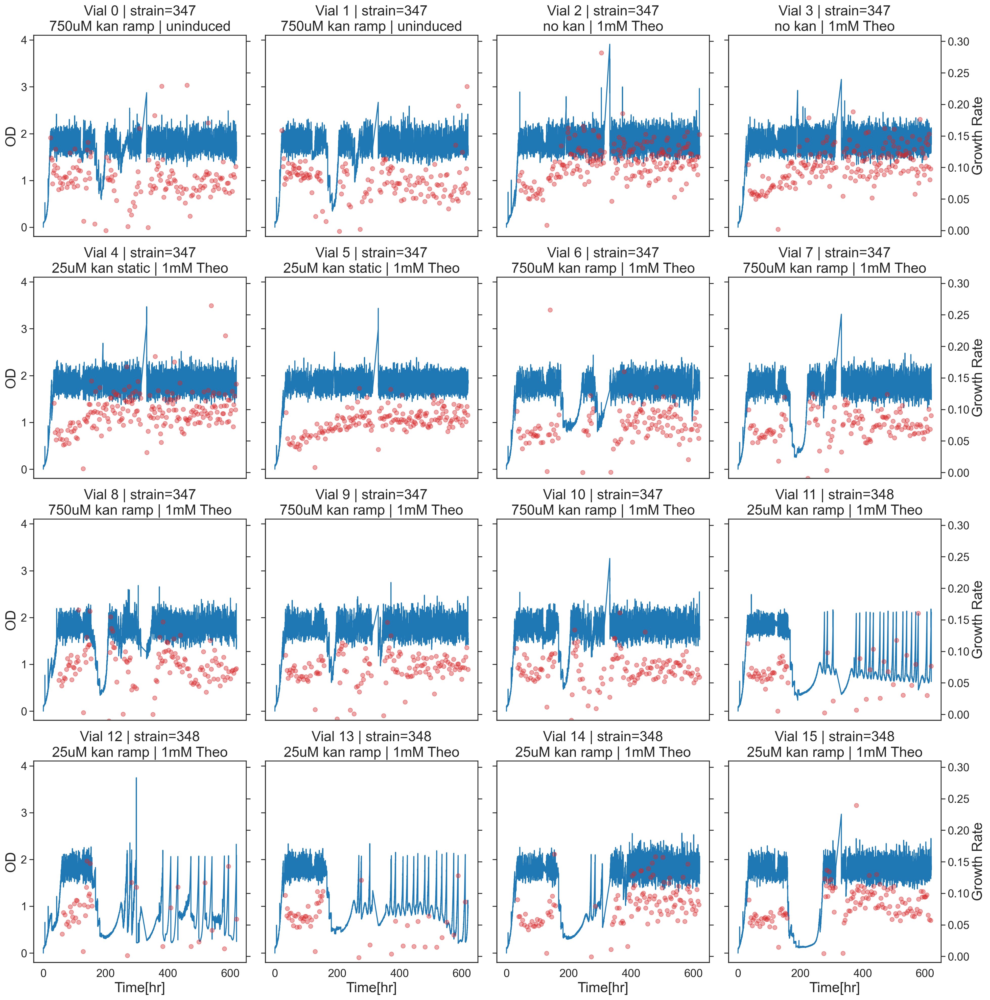

In [12]:
# Variables for Plot Generation
df_range = [0, 9999] # time range (hours) to plot data from
vial_nums = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15]

y1name = 'OD' #left y-axis variable name
y2name = 'Growth Rate' #right y-axis variable name; put None if you want a plot with one y-axis
eventname = None #vertical lines when an event occured; put None if you want a plot without events; example: pumpname for pumps

save_plots = False # whether to save plots
logscale = False

smooth = False # whether to smooth the OD data using a rolling median
fitrange = 10 # Window size for rolling growth rate finder
remove_outliers = False # whether to remove outliers

num_vials = len(vial_nums)
num_rows = int(np.ceil(np.sqrt(num_vials)))
num_cols = int(np.ceil(num_vials / num_rows))
fig = plt.figure(figsize=(num_cols*5, num_rows*14), dpi=200)

# Get data for all vials
df = pd.DataFrame()
gr_df = pd.DataFrame()
selection_df = pd.DataFrame()
for x in vial_nums:    
    colnames=[timename,y1name]
    folder1 = name_to_foldername[y1name]
    df1 = read_csv(x,folder1,colnames)
    df1 = df1[df1[timename].between(df_range[0], df_range[1])]
    if remove_outliers:
        df1 = remove_OD_outliers(df1, od_column=odname, time_column=timename, threshold=1.5, start_time=1)
    if smooth:    
        df1[y1name] = df1[y1name].rolling(fitrange, center=True, min_periods=1).median() # perform rolling median smoothing
    df1['vial'] = str(x)
    # lightdf = read_csv(x,'light_config', [timename, 'light1_uE','PWM1','light2_uE','PWM2']) # load light data
    # last_light = list(lightdf.light1_uE)[-1] # get last light value
    # df1[lightname] = last_light

    colnames = [timename,'Growth Rate']
    file_name =  f"vial{x}_gr.txt"
    gr_path = os.path.join(exp_name, 'growthrate', file_name)
    gr_data = pd.read_csv(gr_path, delimiter=',', header=1, names=colnames, dtype={'time': float, 'gr': float})
    gr_data = gr_data[gr_data[timename].between(df_range[0], df_range[1])]
    gr_data['vial'] = str(x)
    gr_df = pd.concat([gr_df, gr_data])
    df = pd.concat([df, df1])

    colnames = [timename, "step_time", "Target Kan Conc [ug/mL]", "Kan Conc [ug/mL]"]
    file_name =  f"vial{x}_step_log.txt"
    step_path = os.path.join(exp_name, 'step_log', file_name)
    data = pd.read_csv(step_path, delimiter=',', header=1, names=colnames)
    selection_df = pd.concat([selection_df, data])

    # Load events

df = df.reset_index(drop=True) # need unique indices for seaborn


g = sns.relplot(data=df, x=timename, y=y1name, col='vial', col_wrap=num_cols, kind='line', estimator=None) 

# Find overall min and max for 'Growth Rate'
min_growth_rate = gr_df['Growth Rate'].min() * 0.9
max_growth_rate = gr_df['Growth Rate'].max() * 1.1

for ax, vial in zip(g.axes.flat, g.col_names):
    ax.set_title(vial_labels[int(vial)])
    
    # Only show ticks on the left and bottom for outer plots
    if not ax.get_subplotspec().is_first_col():
        ax.tick_params(labelleft=False)
    if not ax.get_subplotspec().is_last_row():
        ax.tick_params(labelbottom=False)

    # Growth rate plotting
    df2 = gr_df[gr_df['vial'] == vial]
    if not df2.empty:
        ax2 = ax.twinx()
        ax2.set_ylabel('Growth Rate' )
        ax2.scatter(df2[timename], df2['Growth Rate' ], color='tab:red', alpha=0.4)
        ax2.set_ylim(min_growth_rate, max_growth_rate)
        if not ax2.get_subplotspec().is_last_col(): # remove ticks on right for inner plots
            ax2.tick_params(labelleft=False)
            ax2.tick_params(labelright=False)
            ax2.set_ylabel('')
    

# fig.subplots_adjust(left=0.1, bottom=0.1, right=0.9, top=0.9, wspace=0.4, hspace=0.4)
plt.tight_layout()
plt.show()

## Smaller Time Range Grid of Plots

<Figure size 4000x11200 with 0 Axes>

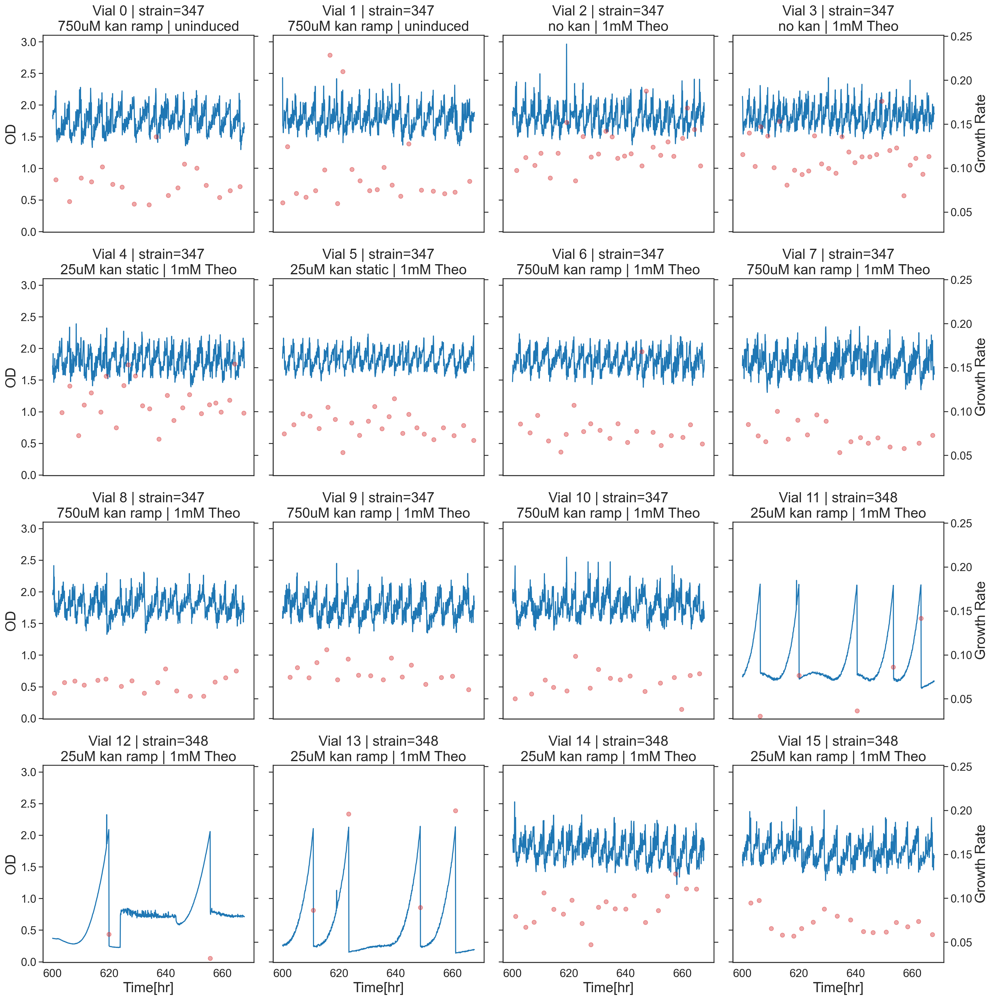

In [34]:
# Variables for Plot Generation
df_range = [600, 9999] # time range (hours) to plot data from
vial_nums = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15]

y1name = 'OD' #left y-axis variable name
y2name = 'Growth Rate' #right y-axis variable name; put None if you want a plot with one y-axis
eventname = None #vertical lines when an event occured; put None if you want a plot without events; example: pumpname for pumps

save_plots = False # whether to save plots
logscale = False

smooth = False # whether to smooth the OD data using a rolling median
fitrange = 10 # Window size for rolling growth rate finder
remove_outliers = False # whether to remove outliers

num_vials = len(vial_nums)
num_rows = int(np.ceil(np.sqrt(num_vials)))
num_cols = int(np.ceil(num_vials / num_rows))
fig = plt.figure(figsize=(num_cols*5, num_rows*14), dpi=200)

# Get data for all vials
df = pd.DataFrame()
gr_df = pd.DataFrame()
selection_df = pd.DataFrame()
for x in vial_nums:    
    colnames=[timename,y1name]
    folder1 = name_to_foldername[y1name]
    df1 = read_csv(x,folder1,colnames)
    if smooth:    
        df1[y1name] = df1[y1name].rolling(fitrange, center=True, min_periods=1).median() # perform rolling median smoothing
    df1 = df1[df1[timename].between(df_range[0], df_range[1])]
    if remove_outliers:
        df1 = remove_OD_outliers(df1, od_column=odname, time_column=timename, threshold=1.5, start_time=1)
    df1['vial'] = str(x)
    # lightdf = read_csv(x,'light_config', [timename, 'light1_uE','PWM1','light2_uE','PWM2']) # load light data
    # last_light = list(lightdf.light1_uE)[-1] # get last light value
    # df1[lightname] = last_light

    colnames = [timename,'Growth Rate']
    file_name =  f"vial{x}_gr.txt"
    gr_path = os.path.join(exp_name, 'growthrate', file_name)
    gr_data = pd.read_csv(gr_path, delimiter=',', header=1, names=colnames, dtype={'time': float, 'gr': float})
    gr_data = gr_data[gr_data[timename].between(df_range[0], df_range[1])]
    gr_data['vial'] = str(x)
    gr_df = pd.concat([gr_df, gr_data])
    df = pd.concat([df, df1])

    colnames = [timename, "step_time", "Target Kan Conc [ug/mL]", "Kan Conc [ug/mL]"]
    file_name =  f"vial{x}_step_log.txt"
    step_path = os.path.join(exp_name, 'step_log', file_name)
    data = pd.read_csv(step_path, delimiter=',', header=1, names=colnames)
    selection_df = pd.concat([selection_df, data])

df = df.reset_index(drop=True) # need unique indices for seaborn

g = sns.relplot(data=df, x=timename, y=y1name, col='vial', col_wrap=num_cols, kind='line', estimator=None) 

# Find overall min and max for 'Growth Rate'
min_growth_rate = gr_df['Growth Rate'].min() * 0.9
max_growth_rate = gr_df['Growth Rate'].max() * 1.1


for ax, vial in zip(g.axes.flat, g.col_names):
    ax.set_title(vial_labels[int(vial)])
    
    # Only show ticks on the left and bottom for outer plots
    if not ax.get_subplotspec().is_first_col():
        ax.tick_params(labelleft=False)
    if not ax.get_subplotspec().is_last_row():
        ax.tick_params(labelbottom=False)

    # Growth rate plotting
    df2 = gr_df[gr_df['vial'] == vial]
    if not df2.empty:
        ax2 = ax.twinx()
        ax2.set_ylabel('Growth Rate' )
        ax2.scatter(df2[timename], df2['Growth Rate' ], color='tab:red', alpha=0.4)
        ax2.set_ylim(min_growth_rate, max_growth_rate)
        if not ax2.get_subplotspec().is_last_col(): # remove ticks on right for inner plots
            ax2.tick_params(labelleft=False)
            ax2.tick_params(labelright=False)
            ax2.set_ylabel('')
    

# fig.subplots_adjust(left=0.1, bottom=0.1, right=0.9, top=0.9, wspace=0.4, hspace=0.4)
plt.tight_layout()
plt.show()

## Single Vial

<Figure size 1000x2800 with 0 Axes>

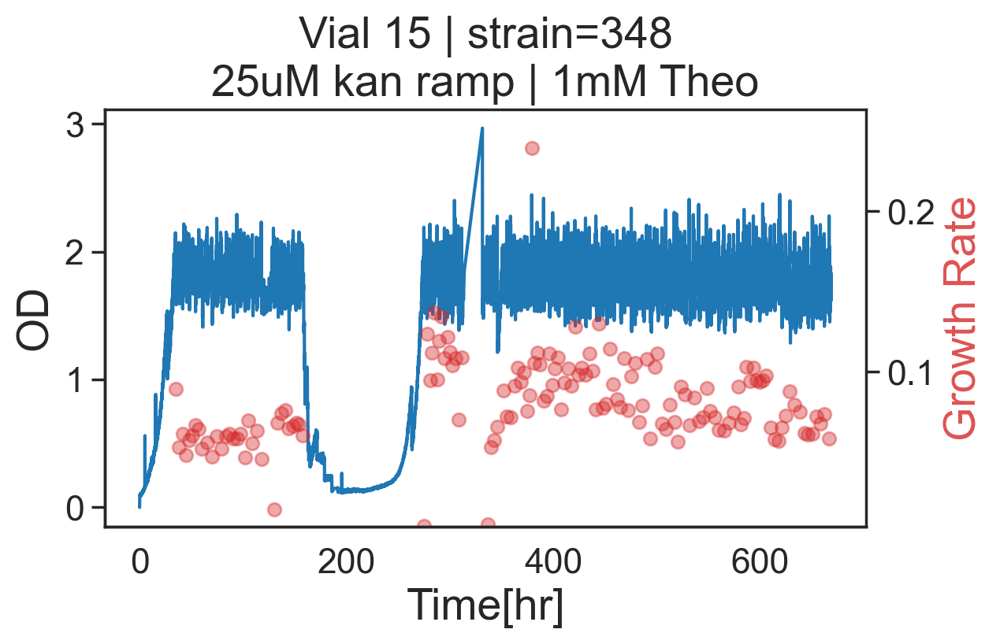

In [35]:
# Variables for Plot Generation
df_range = [0, 9999] # time range (hours) to plot data from
vial_nums = [15]

y1name = 'OD' #left y-axis variable name
y2name = 'Growth Rate' #right y-axis variable name; put None if you want a plot with one y-axis
eventname = None #vertical lines when an event occured; put None if you want a plot without events; example: pumpname for pumps

save_plots = False # whether to save plots
logscale = False

smooth = False # whether to smooth the OD data using a rolling median
fitrange = 10 # Window size for rolling growth rate finder
remove_outliers = False # whether to remove outliers

num_vials = len(vial_nums)
num_rows = int(np.ceil(np.sqrt(num_vials)))
num_cols = int(np.ceil(num_vials / num_rows))
fig = plt.figure(figsize=(num_cols*5, num_rows*14), dpi=200)

# Get data for all vials
df = pd.DataFrame()
gr_df = pd.DataFrame()
selection_df = pd.DataFrame()
for x in vial_nums:    
    colnames=[timename,y1name]
    folder1 = name_to_foldername[y1name]
    df1 = read_csv(x,folder1,colnames)
    if smooth:    
        df1[y1name] = df1[y1name].rolling(fitrange, center=True, min_periods=1).median() # perform rolling median smoothing
    df1 = df1[df1[timename].between(df_range[0], df_range[1])]
    if remove_outliers:
        df1 = remove_OD_outliers(df1, od_column=odname, time_column=timename, threshold=1.5, start_time=1)
    df1['vial'] = str(x)
    # lightdf = read_csv(x,'light_config', [timename, 'light1_uE','PWM1','light2_uE','PWM2']) # load light data
    # last_light = list(lightdf.light1_uE)[-1] # get last light value
    # df1[lightname] = last_light

    colnames = [timename,'Growth Rate']
    file_name =  f"vial{x}_gr.txt"
    gr_path = os.path.join(exp_name, 'growthrate', file_name)
    gr_data = pd.read_csv(gr_path, delimiter=',', header=1, names=colnames, dtype={'time': float, 'gr': float})
    gr_data = gr_data[gr_data[timename].between(df_range[0], df_range[1])]
    gr_data['vial'] = str(x)
    gr_df = pd.concat([gr_df, gr_data])
    df = pd.concat([df, df1])

    colnames = [timename, "step_time", "Target Kan Conc [ug/mL]", "Kan Conc [ug/mL]"]
    file_name =  f"vial{x}_step_log.txt"
    step_path = os.path.join(exp_name, 'step_log', file_name)
    data = pd.read_csv(step_path, delimiter=',', header=1, names=colnames)
    selection_df = pd.concat([selection_df, data])

df = df.reset_index(drop=True) # need unique indices for seaborn

g = sns.relplot(data=df, x=timename, y=y1name, col='vial', col_wrap=num_cols, kind='line', estimator=None, height=4, aspect=1.5) 

# Find overall min and max for 'Growth Rate'
min_growth_rate = gr_df['Growth Rate'].min() * 0.9
max_growth_rate = gr_df['Growth Rate'].max() * 1.1


for ax, vial in zip(g.axes.flat, g.col_names):
    ax.set_title(vial_labels[int(vial)])
    
    # Only show ticks on the left and bottom for outer plots
    if not ax.get_subplotspec().is_first_col():
        ax.tick_params(labelleft=False)
    if not ax.get_subplotspec().is_last_row():
        ax.tick_params(labelbottom=False)

    # Growth rate plotting
    df2 = gr_df[gr_df['vial'] == vial]
    if not df2.empty:
        ax2 = ax.twinx()
        ax2.set_ylabel('Growth Rate' , color='tab:red', alpha=0.8)
        ax2.scatter(df2[timename], df2['Growth Rate' ], color='tab:red', alpha=0.4)
        ax2.set_ylim(min_growth_rate, max_growth_rate)
        if not ax2.get_subplotspec().is_last_col(): # remove ticks on right for inner plots
            ax2.tick_params(labelleft=False)
            ax2.tick_params(labelright=False)
            ax2.set_ylabel('')
    

# fig.subplots_adjust(left=0.1, bottom=0.1, right=0.9, top=0.9, wspace=0.4, hspace=0.4)
# plt.tight_layout()
plt.show()

## All Lines on One Plot

meta NOT subset; don't know how to subset; dropped


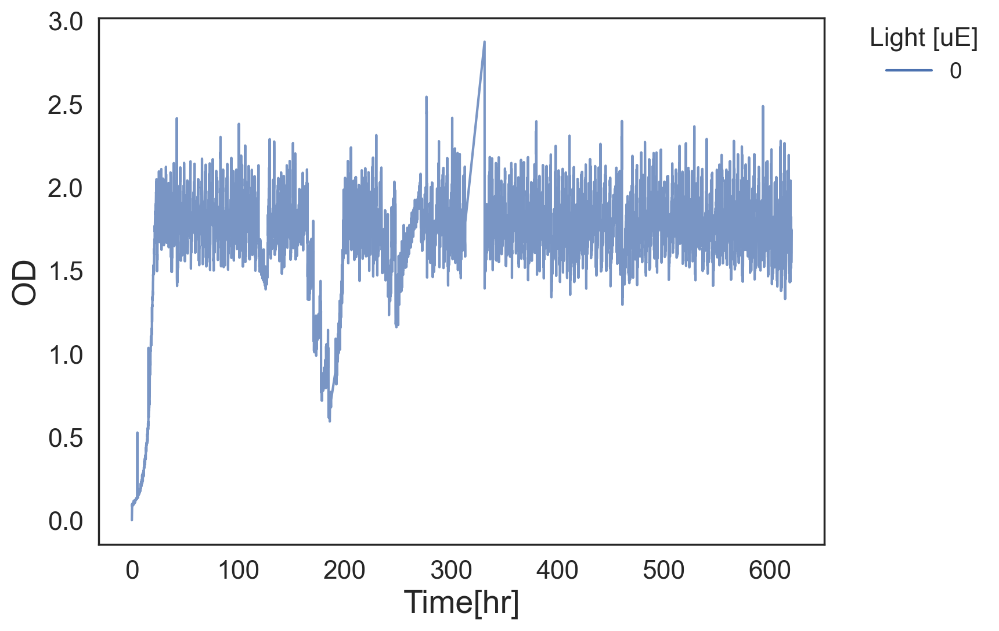

In [15]:
# Variables for Plot Generation
df_range = [0, 999] # time range (hours) to plot data from

y1name = 'OD' #left y-axis variable name
y2name = gratename #right y-axis variable name; put None if you want a plot with one y-axis
eventname = None #vertical lines when an event occured; put None if you want a plot without events; example: pumpname for pumps

save_plots = True # whether to save plots
palette = 'deep'

smooth = False # whether to smooth the OD data using a rolling median
fitrange = 10 # Window size for rolling growth rate finder

# Get data for all vials
df = pd.DataFrame()
for x in vial_nums:    
    colnames=[timename,y1name]
    folder1 = name_to_foldername[y1name]
    df1 = read_csv(x,folder1,colnames)
    df1 = df1[df1[timename].between(df_range[0], df_range[1])]
    if smooth:    
        df1[y1name] = df1[y1name].rolling(fitrange, center=True, min_periods=1).median() # perform rolling median smoothing
    df1['vial'] = str(x)
    lightdf = read_csv(x,'light_config', [timename, 'light1_uE','PWM1','light2_uE','PWM2']) # load light data
    last_light = list(lightdf.light1_uE)[-1] # get last light value
    df1[lightname] = str(last_light)
    df = pd.concat([df, df1])

df = df.reset_index(drop=True) # need unique indices for seaborn
plt.figure(figsize=(10, 6))
sns.lineplot(data=df, x=timename, y=y1name, hue='vial',
              palette=palette, estimator=None, ci=None, alpha=0.75)
plt.legend(title=lightname, bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.) # Place the legend outside the plot
plt.subplots_adjust(right=0.75) # Adjust subplot parameters to give some space for the legend
if save_plots:# Make correct folder for this plot
    end_time = int(df1[timename].values[-1])
    savetitle = f"{y1name}_allVials_lineplot_{df_range[0]}-{end_time}h{'_smooth' if smooth else ''}"
    save_folder = exp_name+'_analysis'
    if save_folder not in os.listdir():
        os.mkdir(save_folder)
    save_path = os.path.join(path, save_folder)
    save_title = os.path.join(save_path,savetitle)
    plt.savefig(save_title+".pdf")
    plt.savefig(save_title+".png")
plt.show()

# Selection

<Figure size 4000x11200 with 0 Axes>

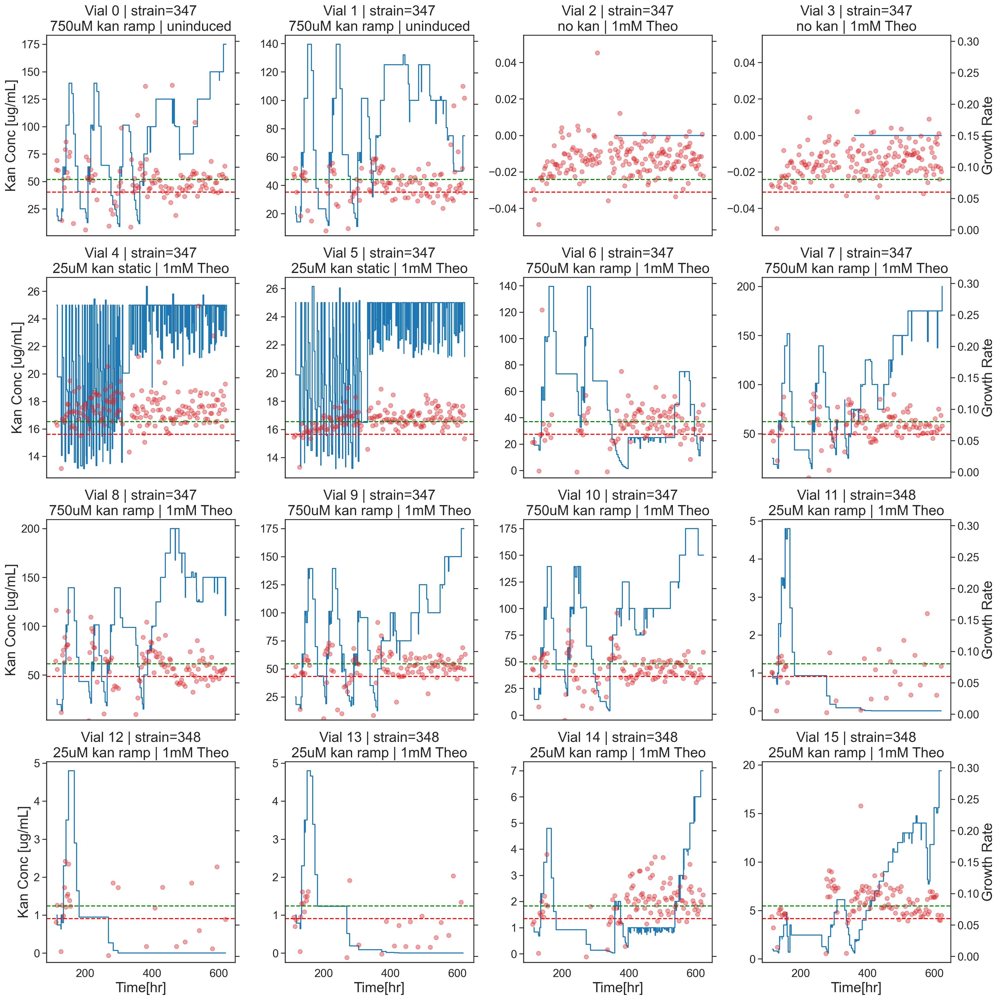

In [22]:
# Variables for Plot Generation
df_range = [110, 9999] # time range (hours) to plot data from
vial_nums = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15]

y1name = 'OD' #left y-axis variable name
y2name = 'Growth Rate' #right y-axis variable name; put None if you want a plot with one y-axis
eventname = 'slow_pump_log' #vertical lines when an event occured; put None if you want a plot without events; example: pumpname for pumps

save_plots = False # whether to save plots
logscale = False

smooth = False # whether to smooth the OD data using a rolling median
fitrange = 10 # Window size for rolling growth rate finder
remove_outliers = False # whether to remove outliers

num_vials = len(vial_nums)
num_rows = int(np.ceil(np.sqrt(num_vials)))
num_cols = int(np.ceil(num_vials / num_rows))
fig = plt.figure(figsize=(num_cols*5, num_rows*14), dpi=200)

# Get data for all vials
df = pd.DataFrame()
gr_df = pd.DataFrame()
selection_df = pd.DataFrame()
slow_pump_df = pd.DataFrame()
for x in vial_nums:    
    colnames=[timename,y1name]
    folder1 = name_to_foldername[y1name]
    df1 = read_csv(x,folder1,colnames)
    df1 = df1[df1[timename].between(df_range[0], df_range[1])]
    if remove_outliers:
        df1 = remove_OD_outliers(df1, od_column=odname, time_column=timename, threshold=1.5, start_time=1)
    if smooth:    
        df1[y1name] = df1[y1name].rolling(fitrange, center=True, min_periods=1).median() # perform rolling median smoothing
    df1['vial'] = str(x)
    # lightdf = read_csv(x,'light_config', [timename, 'light1_uE','PWM1','light2_uE','PWM2']) # load light data
    # last_light = list(lightdf.light1_uE)[-1] # get last light value
    # df1[lightname] = last_light

    colnames = [timename,'Growth Rate']
    file_name =  f"vial{x}_gr.txt"
    gr_path = os.path.join(exp_name, 'growthrate', file_name)
    gr_data = pd.read_csv(gr_path, delimiter=',', header=1, names=colnames, dtype={'time': float, 'gr': float})
    gr_data = gr_data[gr_data[timename].between(df_range[0], df_range[1])]
    gr_data['vial'] = str(x)
    gr_df = pd.concat([gr_df, gr_data])
    df = pd.concat([df, df1])

    colnames = [timename, "step_time", "Target Kan Conc [ug/mL]", "Kan Conc [ug/mL]", "message"]
    file_name =  f"vial{x}_step_log.txt"
    step_path = os.path.join(exp_name, 'step_log', file_name)
    data = pd.read_csv(step_path, delimiter=',', header=1, names=colnames, index_col=False)
    data['vial'] = str(x)
    if len(data) != 1: # keeps vials without selection in the grid
        data = data[data[timename].between(df_range[0], df_range[1])]
    else:
        data[timename] = df_range[0]
    selection_df = pd.concat([selection_df, data])

    colnames = [timename, 'Slow Pump In Time (seconds)']
    file_name =  f"vial{x}_slow_pump_log.txt"
    pump_path = os.path.join(exp_name, 'slow_pump_log', file_name)
    pump_data = pd.read_csv(pump_path, delimiter=',', header=1, names=colnames, index_col=False)
    pump_data['vial'] = str(x)
    slow_pump_df = pd.concat([slow_pump_df, pump_data])
    
df = df.reset_index(drop=True) # need unique indices for seaborn

g = sns.relplot(data=selection_df, x=timename, y="Kan Conc [ug/mL]", col='vial', col_wrap=num_cols, kind='line', estimator=None, facet_kws={'sharey': False}) 


# Apply step plot styling
for ax in g.axes.flat:
    for line in ax.lines:
        line.set_drawstyle('steps-post')

# Find overall min and max for 'Growth Rate'
min_growth_rate = gr_df['Growth Rate'].min() * 0.9
max_growth_rate = gr_df['Growth Rate'].max() * 1.1

for ax, vial in zip(g.axes.flat, g.col_names):
    ax.set_title(vial_labels[int(vial)])
    
    # Only show ticks on the left and bottom for outer plots
    # if not ax.get_subplotspec().is_first_col():
    #     ax.tick_params(labelleft=False)
    if not ax.get_subplotspec().is_last_row():
        ax.tick_params(labelbottom=False)

    # Growth rate plotting
    df2 = gr_df[gr_df['vial'] == vial]
    if not df2.empty:
        ax2 = ax.twinx()
        ax2.set_ylabel('Growth Rate' )
        # plot min_growth_rate and max_growth_rate as horizontal lines on secondary y-axis
        ax2.axhline(y=min_growthrate, color='red', linestyle='--', label='Min Growth Rate')
        ax2.axhline(y=max_growthrate, color='green', linestyle='--', label='Max Growth Rate')
        
        ax2.scatter(df2[timename], df2['Growth Rate' ], color='tab:red', alpha=0.4)
        ax2.set_ylim(min_growth_rate, max_growth_rate)
        if not ax2.get_subplotspec().is_last_col(): # remove ticks on right for inner plots
            ax2.tick_params(labelleft=False)
            ax2.tick_params(labelright=False)
            ax2.set_ylabel('')
    

# fig.subplots_adjust(left=0.1, bottom=0.1, right=0.9, top=0.9, wspace=0.4, hspace=0.4)
plt.tight_layout()
plt.show()

## Smaller Time Range

meta NOT subset; don't know how to subset; dropped


<Figure size 4000x11200 with 0 Axes>

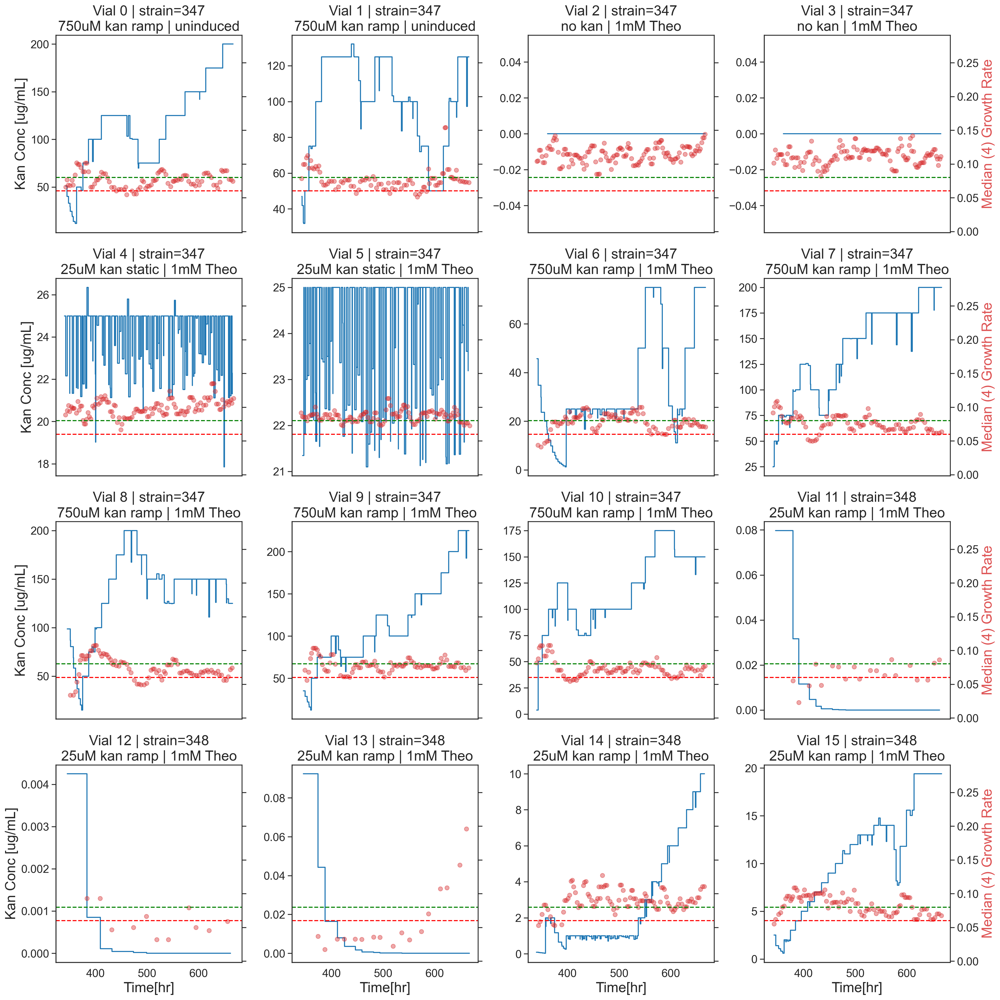

In [32]:
# Variables for Plot Generation
df_range = [340, 9999] # time range (hours) to plot data from
vial_nums = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15]

y1name = 'OD' #left y-axis variable name
y2name = 'Growth Rate' #right y-axis variable name; put None if you want a plot with one y-axis
eventname = 'slow_pump_log' #vertical lines when an event occured; put None if you want a plot without events; example: pumpname for pumps

save_plots = True # whether to save plots
logscale = False

smooth = False # whether to smooth the OD data using a rolling median
fitrange = 10 # Window size for rolling growth rate finder
remove_outliers = False # whether to remove outliers

num_vials = len(vial_nums)
num_rows = int(np.ceil(np.sqrt(num_vials)))
num_cols = int(np.ceil(num_vials / num_rows))
fig = plt.figure(figsize=(num_cols*5, num_rows*14), dpi=200)

# Get data for all vials
df = pd.DataFrame()
gr_df = pd.DataFrame()
selection_df = pd.DataFrame()
slow_pump_df = pd.DataFrame()
for x in vial_nums:    
    colnames=[timename,y1name]
    folder1 = name_to_foldername[y1name]
    df1 = read_csv(x,folder1,colnames)
    df1 = df1[df1[timename].between(df_range[0], df_range[1])]
    if remove_outliers:
        df1 = remove_OD_outliers(df1, od_column=odname, time_column=timename, threshold=1.5, start_time=1)
    df1['vial'] = str(x)
    # lightdf = read_csv(x,'light_config', [timename, 'light1_uE','PWM1','light2_uE','PWM2']) # load light data
    # last_light = list(lightdf.light1_uE)[-1] # get last light value
    # df1[lightname] = last_light

    colnames = [timename,'Growth Rate']
    file_name =  f"vial{x}_gr.txt"
    gr_path = os.path.join(exp_name, 'growthrate', file_name)
    gr_data = pd.read_csv(gr_path, delimiter=',', header=1, names=colnames, dtype={'time': float, 'gr': float})
    gr_data['Median Growth Rate'] = gr_data['Growth Rate'].rolling(min_curves_per_step, center=True, min_periods=1).median() # perform rolling median smoothing
    gr_data = gr_data[gr_data[timename].between(df_range[0], df_range[1])]
    gr_data['vial'] = str(x)
    gr_df = pd.concat([gr_df, gr_data])
    df = pd.concat([df, df1])

    colnames = [timename, "step_time", "Target Kan Conc [ug/mL]", "Kan Conc [ug/mL]", "message"]
    file_name =  f"vial{x}_step_log.txt"
    step_path = os.path.join(exp_name, 'step_log', file_name)
    data = pd.read_csv(step_path, delimiter=',', header=1, names=colnames, index_col=False)
    data['vial'] = str(x)
    if len(data) != 1: # keeps vials without selection in the grid
        data = data[data[timename].between(df_range[0], df_range[1])]
    else:
        data[timename] = df_range[0]
    selection_df = pd.concat([selection_df, data])

    colnames = [timename, 'Slow Pump In Time (seconds)']
    file_name =  f"vial{x}_slow_pump_log.txt"
    pump_path = os.path.join(exp_name, 'slow_pump_log', file_name)
    pump_data = pd.read_csv(pump_path, delimiter=',', header=1, names=colnames, index_col=False)
    pump_data['vial'] = str(x)
    slow_pump_df = pd.concat([slow_pump_df, pump_data])
    
df = df.reset_index(drop=True) # need unique indices for seaborn

g = sns.relplot(data=selection_df, x=timename, y="Kan Conc [ug/mL]", col='vial', col_wrap=num_cols, kind='line', estimator=None, facet_kws={'sharey': False}) 


# Apply step plot styling
for ax in g.axes.flat:
    for line in ax.lines:
        line.set_drawstyle('steps-post')

# Find overall min and max for 'Growth Rate'
min_growth_rate = gr_df['Growth Rate'].min() * 0.9
max_growth_rate = gr_df['Growth Rate'].max() * 1.1

for ax, vial in zip(g.axes.flat, g.col_names):
    ax.set_title(vial_labels[int(vial)])
    
    # Only show ticks on the left and bottom for outer plots
    # if not ax.get_subplotspec().is_first_col():
    #     ax.tick_params(labelleft=False)
    if not ax.get_subplotspec().is_last_row():
        ax.tick_params(labelbottom=False)

    # Growth rate plotting
    df2 = gr_df[gr_df['vial'] == vial]
    if not df2.empty:
        ax2 = ax.twinx()
        ax2.set_ylabel(f'Median ({min_curves_per_step}) Growth Rate', color='tab:red', alpha=0.8)
        # plot min_growth_rate and max_growth_rate as horizontal lines on secondary y-axis
        ax2.axhline(y=min_growthrate, color='red', linestyle='--', label='Min Growth Rate')
        ax2.axhline(y=max_growthrate, color='green', linestyle='--', label='Max Growth Rate')
        ax2.scatter(df2[timename], df2[f'Median Growth Rate'], color='tab:red', alpha=0.4)
        # ax2.scatter(df2[timename], df2['Growth Rate' ], color='tab:red', alpha=0.4)
        ax2.set_ylim(min_growth_rate, max_growth_rate)
        if not ax2.get_subplotspec().is_last_col(): # remove ticks on right for inner plots
            ax2.tick_params(labelleft=False)
            ax2.tick_params(labelright=False)
            ax2.set_ylabel('')
    

# fig.subplots_adjust(left=0.1, bottom=0.1, right=0.9, top=0.9, wspace=0.4, hspace=0.4)
plt.tight_layout()
if save_plots:# Make correct folder for this plot
    end_time = int(df1[timename].values[-1])
    savetitle = f"selection_allVials_{df_range[0]}h"
    save_folder = exp_name+'_analysis'
    if save_folder not in os.listdir():
        os.mkdir(save_folder)
    save_path = os.path.join(path, save_folder)
    save_title = os.path.join(save_path,savetitle)
    plt.savefig(save_title+".pdf")
    plt.savefig(save_title+".png")
plt.show()

## Single Vial

<Figure size 2400x1600 with 0 Axes>

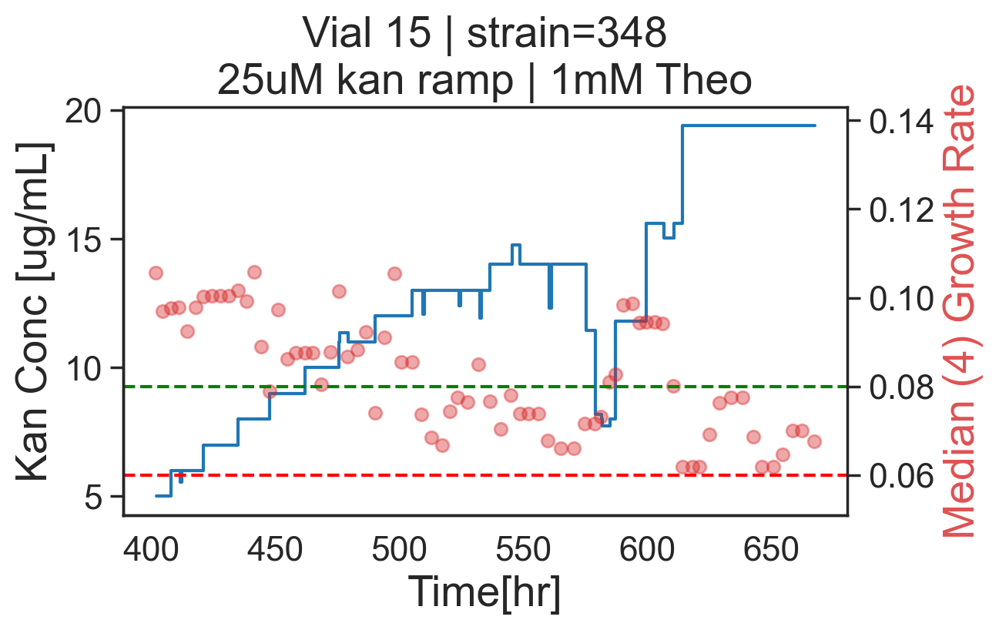

In [38]:
# Variables for Plot Generation
df_range = [400, 9999] # time range (hours) to plot data from
vial_nums = [15]

y1name = 'OD' #left y-axis variable name
y2name = 'Growth Rate' #right y-axis variable name; put None if you want a plot with one y-axis
eventname = 'slow_pump_log' #vertical lines when an event occured; put None if you want a plot without events; example: pumpname for pumps

save_plots = False # whether to save plots
logscale = False

smooth = False # whether to smooth the OD data using a rolling median
fitrange = 10 # Window size for rolling growth rate finder
remove_outliers = False # whether to remove outliers

num_vials = len(vial_nums)
num_rows = int(np.ceil(np.sqrt(num_vials)))
num_cols = int(np.ceil(num_vials / num_rows))
fig = plt.figure(figsize=(12, 8), dpi=200)

# Get data for all vials
df = pd.DataFrame()
gr_df = pd.DataFrame()
selection_df = pd.DataFrame()
slow_pump_df = pd.DataFrame()
for x in vial_nums:    
    colnames=[timename,y1name]
    folder1 = name_to_foldername[y1name]
    df1 = read_csv(x,folder1,colnames)
    df1 = df1[df1[timename].between(df_range[0], df_range[1])]
    if remove_outliers:
        df1 = remove_OD_outliers(df1, od_column=odname, time_column=timename, threshold=1.5, start_time=1)
    df1['vial'] = str(x)
    # lightdf = read_csv(x,'light_config', [timename, 'light1_uE','PWM1','light2_uE','PWM2']) # load light data
    # last_light = list(lightdf.light1_uE)[-1] # get last light value
    # df1[lightname] = last_light

    colnames = [timename,'Growth Rate']
    file_name =  f"vial{x}_gr.txt"
    gr_path = os.path.join(exp_name, 'growthrate', file_name)
    gr_data = pd.read_csv(gr_path, delimiter=',', header=1, names=colnames, dtype={'time': float, 'gr': float})
    gr_data['Median Growth Rate'] = gr_data['Growth Rate'].rolling(min_curves_per_step, center=True, min_periods=1).median() # perform rolling median smoothing
    gr_data = gr_data[gr_data[timename].between(df_range[0], df_range[1])]
    gr_data['vial'] = str(x)
    gr_df = pd.concat([gr_df, gr_data])
    df = pd.concat([df, df1])

    colnames = [timename, "step_time", "Target Kan Conc [ug/mL]", "Kan Conc [ug/mL]", "message"]
    file_name =  f"vial{x}_step_log.txt"
    step_path = os.path.join(exp_name, 'step_log', file_name)
    data = pd.read_csv(step_path, delimiter=',', header=1, names=colnames, index_col=False)
    data['vial'] = str(x)
    if len(data) != 1: # keeps vials without selection in the grid
        data = data[data[timename].between(df_range[0], df_range[1])]
    else:
        data[timename] = df_range[0]
    selection_df = pd.concat([selection_df, data])

    colnames = [timename, 'Slow Pump In Time (seconds)']
    file_name =  f"vial{x}_slow_pump_log.txt"
    pump_path = os.path.join(exp_name, 'slow_pump_log', file_name)
    pump_data = pd.read_csv(pump_path, delimiter=',', header=1, names=colnames, index_col=False)
    pump_data['vial'] = str(x)
    slow_pump_df = pd.concat([slow_pump_df, pump_data])
    
df = df.reset_index(drop=True) # need unique indices for seaborn

g = sns.relplot(
    data=selection_df, 
    x=timename, 
    y="Kan Conc [ug/mL]", 
    col='vial', 
    col_wrap=num_cols, 
    kind='line', 
    estimator=None, 
    facet_kws={'sharey': False},
    height=4,  # Control height
    aspect=1.5  # Control aspect ratio
)


# Apply step plot styling
for ax in g.axes.flat:
    for line in ax.lines:
        line.set_drawstyle('steps-post')

# Find overall min and max for 'Growth Rate'
min_growth_rate = gr_df['Growth Rate'].min() * 0.9
max_growth_rate = gr_df['Growth Rate'].max() * 1.1

for ax, vial in zip(g.axes.flat, g.col_names):
    ax.set_title(vial_labels[int(vial)])
    
    # Only show ticks on the left and bottom for outer plots
    # if not ax.get_subplotspec().is_first_col():
    #     ax.tick_params(labelleft=False)
    if not ax.get_subplotspec().is_last_row():
        ax.tick_params(labelbottom=False)

    # Growth rate plotting
    df2 = gr_df[gr_df['vial'] == vial]
    if not df2.empty:
        ax2 = ax.twinx()
        ax2.set_ylabel(f'Median ({min_curves_per_step}) Growth Rate', color='tab:red', alpha=0.8)
        # plot min_growth_rate and max_growth_rate as horizontal lines on secondary y-axis
        ax2.axhline(y=min_growthrate, color='red', linestyle='--', label='Min Growth Rate')
        ax2.axhline(y=max_growthrate, color='green', linestyle='--', label='Max Growth Rate')
        ax2.scatter(df2[timename], df2[f'Median Growth Rate'], color='tab:red', alpha=0.4)
        # ax2.scatter(df2[timename], df2['Growth Rate' ], color='tab:red', alpha=0.4)
        ax2.set_ylim(min_growth_rate, max_growth_rate)
        if not ax2.get_subplotspec().is_last_col(): # remove ticks on right for inner plots
            ax2.tick_params(labelleft=False)
            ax2.tick_params(labelright=False)
            ax2.set_ylabel('')
    
if save_plots:# Make correct folder for this plot
    end_time = int(df1[timename].values[-1])
    savetitle = f"selection_vial{vial_nums}_{df_range[0]}h"
    save_folder = exp_name+'_analysis'
    if save_folder not in os.listdir():
        os.mkdir(save_folder)
    save_path = os.path.join(path, save_folder)
    save_title = os.path.join(save_path,savetitle)
    plt.savefig(save_title+".pdf")
    plt.savefig(save_title+".png")
plt.show()

# Media Pumped

In [15]:
# Variables for Plot Generation
df_range = [0, 9999] # time range (hours) to plot data from

y1name = 'pump_log' #left y-axis variable name
y2name = 'Growth Rate' #right y-axis variable name; put None if you want a plot with one y-axis
eventname = None #vertical lines when an event occured; put None if you want a plot without events; example: pumpname for pumps

save_plots = False # whether to save plots
logscale = False

smooth = False # whether to smooth the OD data using a rolling median
fitrange = 10 # Window size for rolling growth rate finder
remove_outliers = False # whether to remove outliers

num_vials = len(vial_nums)
num_rows = int(np.ceil(np.sqrt(num_vials)))
num_cols = int(np.ceil(num_vials / num_rows))

# Get data for all vials
df = pd.DataFrame()
for x in vial_nums:    
    colnames=[timename,y1name]
    folder1 = y1name
    df1 = read_csv(x,folder1,colnames)
    df1 = df1[df1[timename].between(df_range[0], df_range[1])]
    df1['vial'] = str(x)
    df = pd.concat([df, df1])
df.dropna(inplace=True)
seconds_pumped = df[y1name].sum()
media_used = seconds_pumped * .9
print(f'Media used (high estimate): {round(media_used/1000, 3)} L')

Media used (high estimate): 8.176 L


In [16]:
import step_utils as su
OD_data = su.get_last_n_lines('OD', 15, 6)
print(np.median(OD_data))
# OD_data

150.92229272756623


# Temperature

## All Lines on One Plot

meta NOT subset; don't know how to subset; dropped


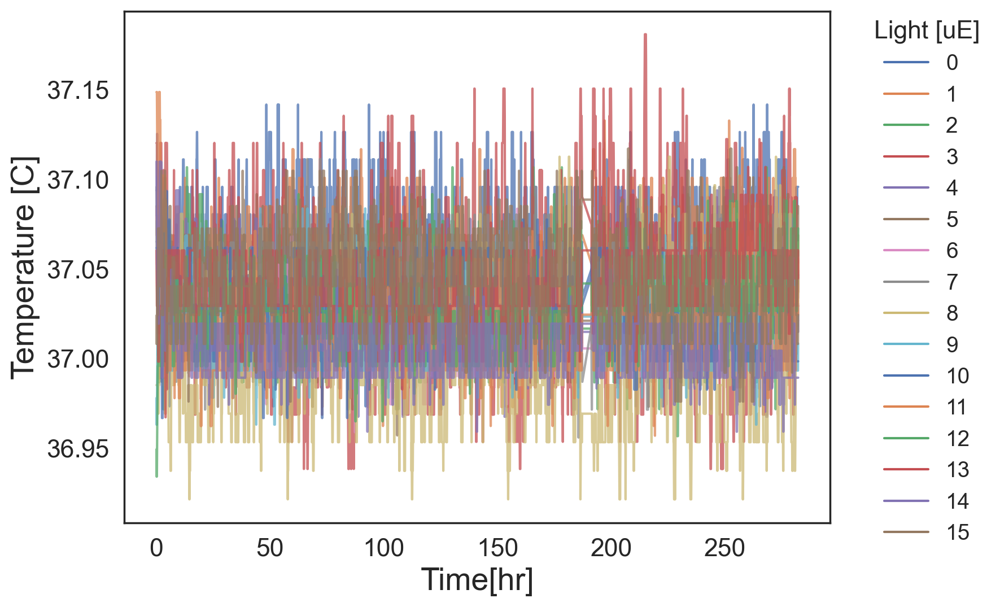

In [17]:
# Variables for Plot Generation
df_range = [0, 999] # time range (hours) to plot data from

y1name = tempname #left y-axis variable name
eventname = None #vertical lines when an event occured; put None if you want a plot without events; example: pumpname for pumps

save_plots = True # whether to save plots
palette = 'deep'

smooth = True # whether to smooth the OD data using a rolling median
fitrange = 10 # Window size for rolling growth rate finder

# Get data for all vials
df = pd.DataFrame()
for x in vial_nums:    
    colnames=[timename,y1name]
    folder1 = name_to_foldername[y1name]
    df1 = read_csv(x,folder1,colnames)
    df1 = df1[df1[timename].between(df_range[0], df_range[1])]
    if smooth:    
        df1[y1name] = df1[y1name].rolling(fitrange, center=True, min_periods=1).median() # perform rolling median smoothing
    df1['vial'] = str(x)
    lightdf = read_csv(x,'light_config', [timename, 'light1_uE','PWM1','light2_uE','PWM2']) # load light data
    last_light = list(lightdf.light1_uE)[-1] # get last light value
    df1[lightname] = str(last_light)
    df = pd.concat([df, df1])

df = df.reset_index(drop=True) # need unique indices for seaborn
plt.figure(figsize=(10, 6))
sns.lineplot(data=df, x=timename, y=y1name, hue='vial',
              palette=palette, estimator=None, ci=None, alpha=0.75)
plt.legend(title=lightname, bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.) # Place the legend outside the plot
plt.subplots_adjust(right=0.75) # Adjust subplot parameters to give some space for the legend
if save_plots:# Make correct folder for this plot
    end_time = int(df1[timename].values[-1])
    savetitle = f"{y1name}_allVials_lineplot_{df_range[0]}-{end_time}h{'_smooth' if smooth else ''}"
    save_folder = exp_name+'_analysis'
    if save_folder not in os.listdir():
        os.mkdir(save_folder)
    save_path = os.path.join(path, save_folder)
    save_title = os.path.join(save_path,savetitle)
    plt.savefig(save_title+".pdf")
    plt.savefig(save_title+".png")
plt.show()

### Differentiate by Vial Taping

meta NOT subset; don't know how to subset; dropped


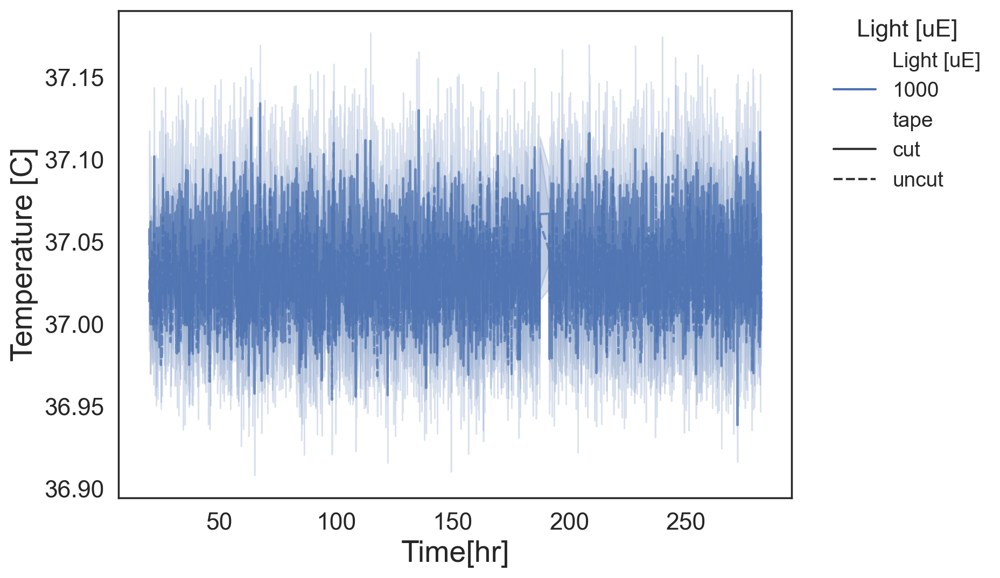

In [18]:
# Variables for Plot Generation
df_range = [0, 999] # time range (hours) to plot data from

y1name = tempname #left y-axis variable name
eventname = None #vertical lines when an event occured; put None if you want a plot without events; example: pumpname for pumps

save_plots = True # whether to save plots
palette = 'deep'

smooth = False # whether to smooth the OD data using a rolling median
fitrange = 10 # Window size for rolling growth rate finder

# Get data for all vials
df = pd.DataFrame()
for x in vial_nums:    
    colnames=[timename,y1name]
    folder1 = name_to_foldername[y1name]
    df1 = read_csv(x,folder1,colnames)
    df1 = df1[df1[timename] > 20]
    if smooth:    
        df1[y1name] = df1[y1name].rolling(fitrange, center=True, min_periods=1).median() # perform rolling median smoothing
    df1['vial'] = str(x)
    # differentiate between cut / uncut tape
    if int(x) < 7:
        df1['tape'] = 'cut'
    else:
        df1['tape'] = 'uncut'
    lightdf = read_csv(x,'light_config', [timename, 'light1_uE','PWM1','light2_uE','PWM2']) # load light data
    last_light = list(lightdf.light1_uE)[-1] # get last light value
    df1[lightname] = str(last_light)
    df = pd.concat([df, df1])

df = df.reset_index(drop=True) # need unique indices for seaborn
plt.figure(figsize=(10, 6))
sns.lineplot(data=df, x=timename, y=y1name, hue=lightname, style='tape',
              palette=palette, alpha=0.75)
plt.legend(title=lightname, bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.) # Place the legend outside the plot
plt.subplots_adjust(right=0.75) # Adjust subplot parameters to give some space for the legend
if save_plots:# Make correct folder for this plot
    end_time = int(df1[timename].values[-1])
    savetitle = f"{y1name}_allVials_lineplot_{df_range[0]}-{end_time}h{'_smooth' if smooth else ''}"
    save_folder = exp_name+'_analysis'
    if save_folder not in os.listdir():
        os.mkdir(save_folder)
    save_path = os.path.join(path, save_folder)
    save_title = os.path.join(save_path,savetitle)
    plt.savefig(save_title+".pdf")
    plt.savefig(save_title+".png")
plt.show()

# OD Values vs Growth Rate

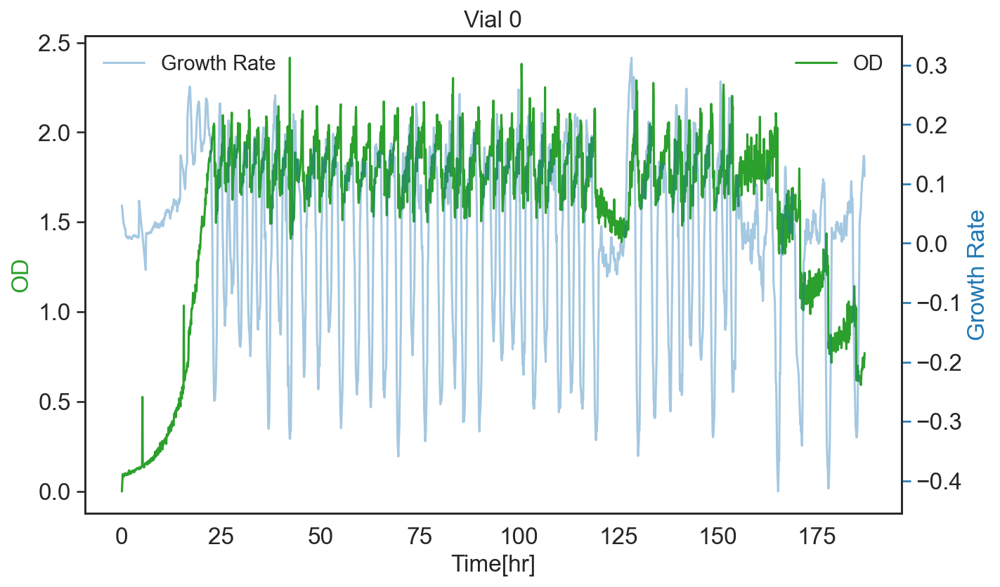

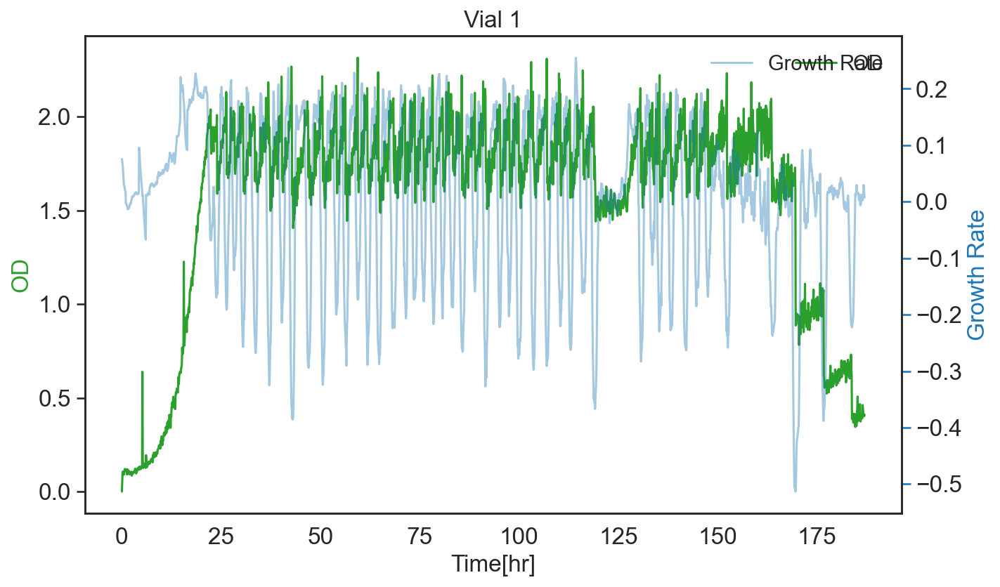

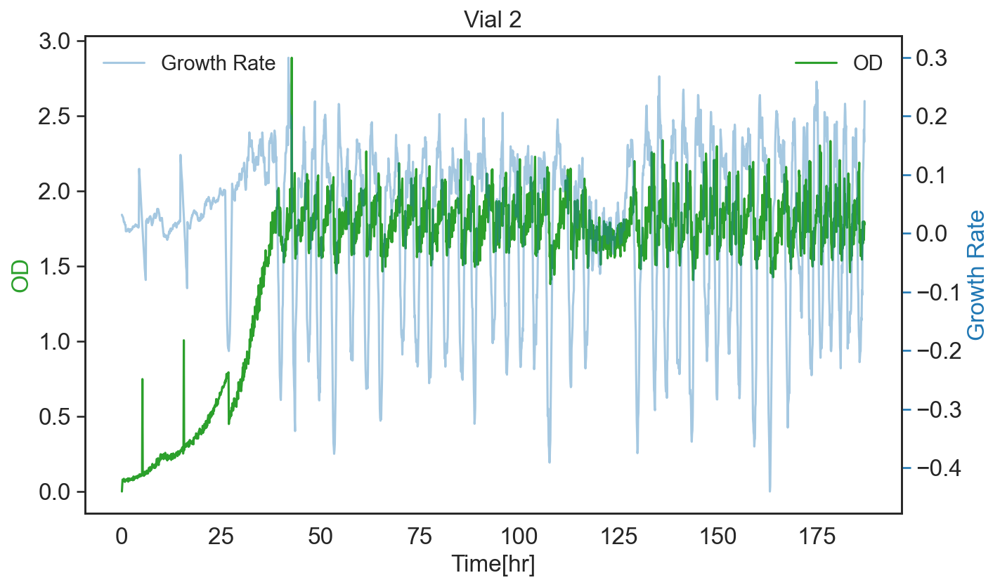

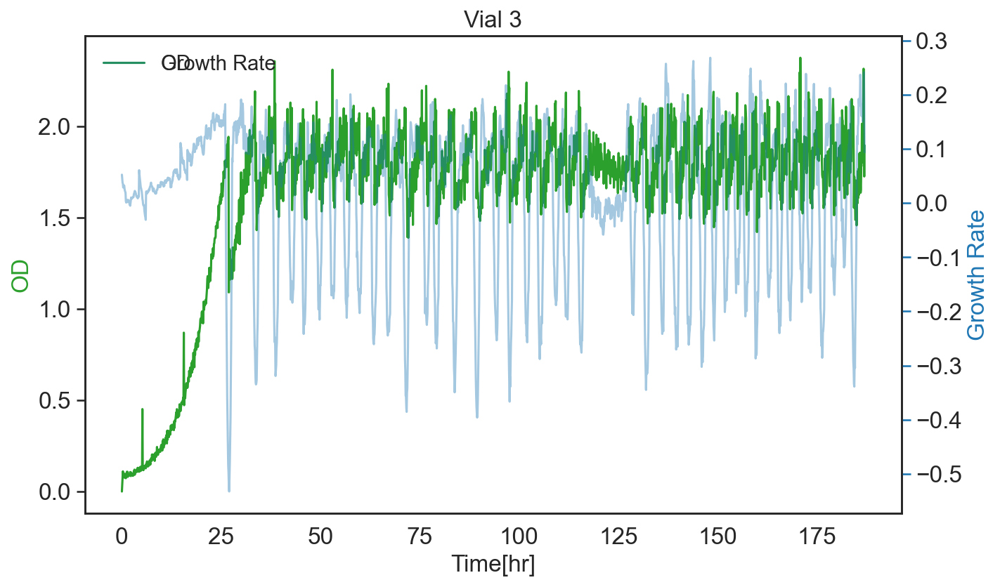

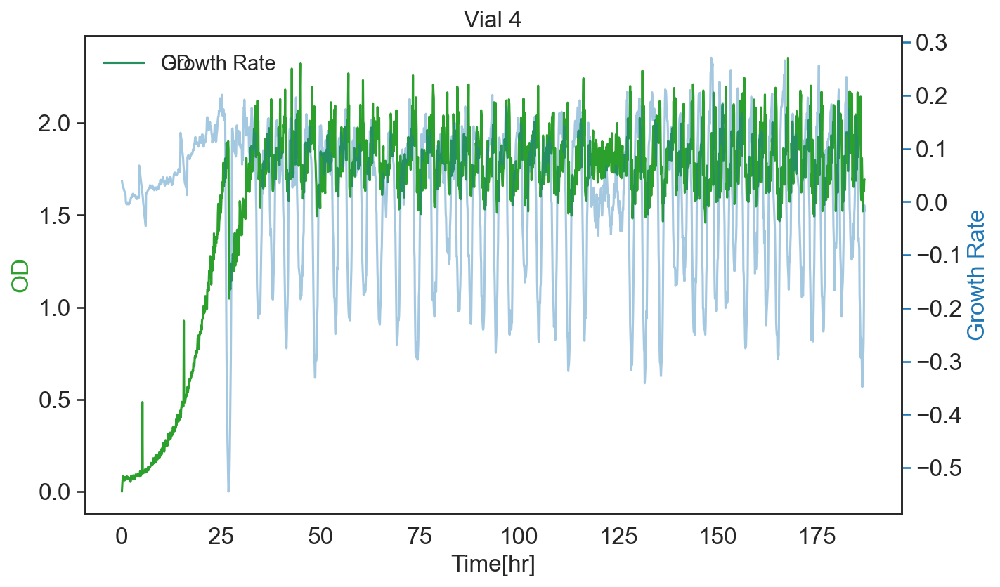

...

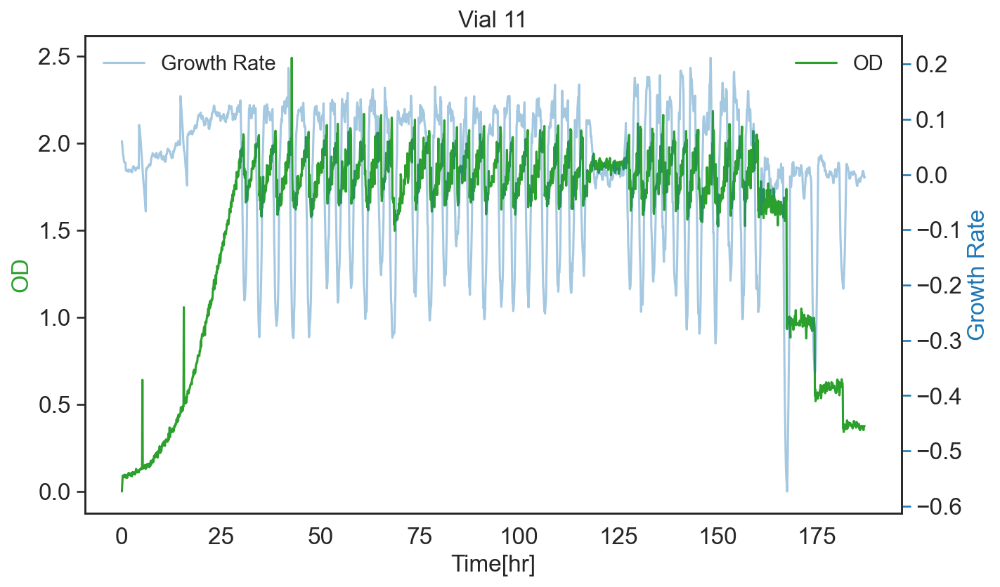

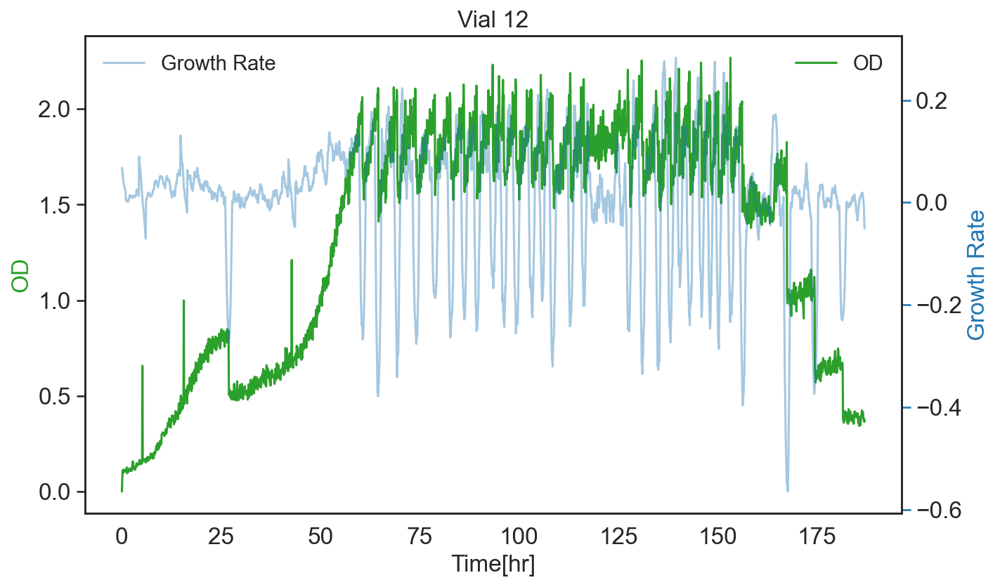

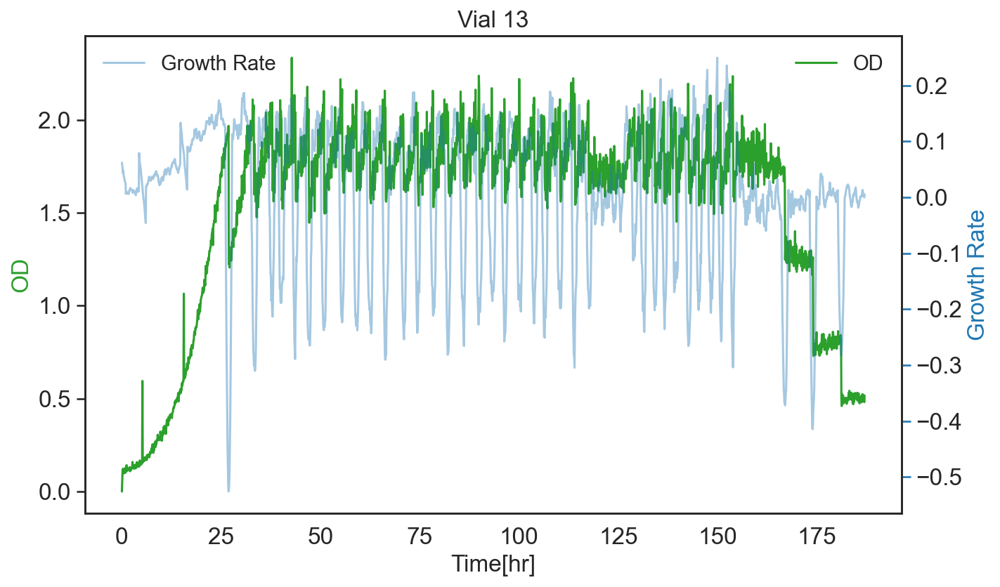

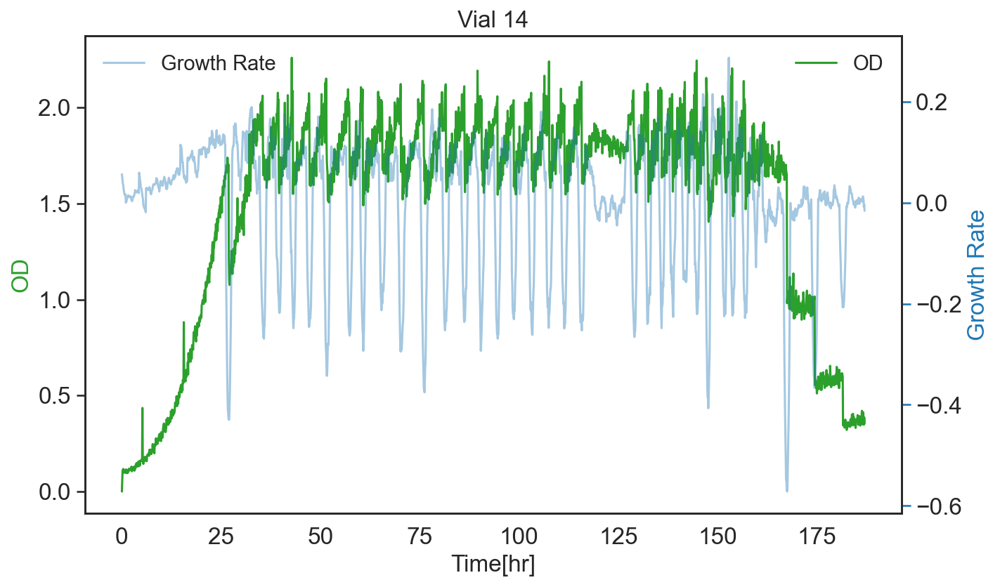

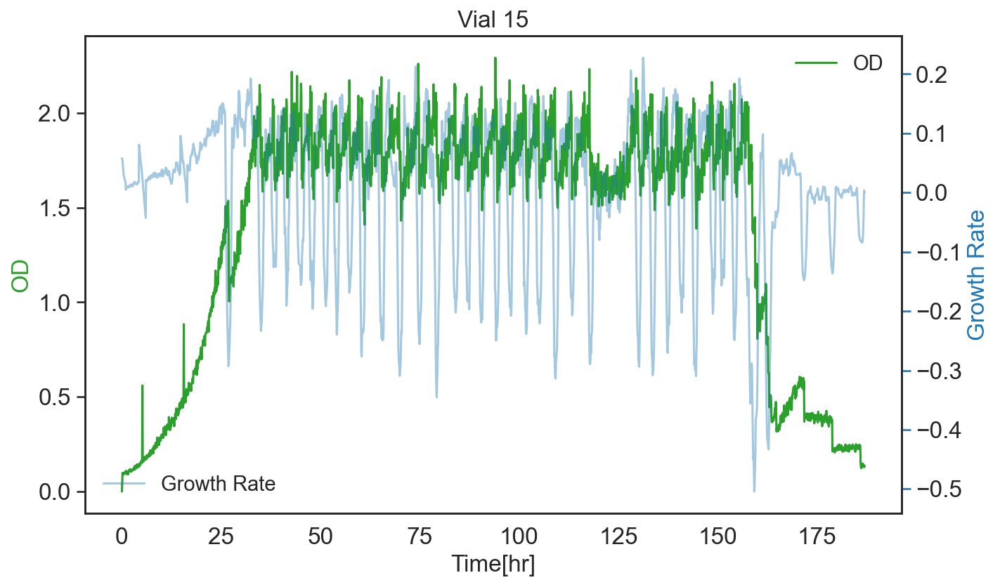

In [214]:
# Variables for Plot Generation
df_range = [0, 9999] # range to plot data in

y1name = 'OD' #left y-axis variable name
y2name = gratename #right y-axis variable name; put None if you want a plot with one y-axis
eventname = None #vertical lines when an event occured; put None if you want a plot without events; example: pumpname for pumps

save_plots = False # whether to save plots
logscale = False

fitrange = 20 # Window size for rolling growth rate finder

df_all = None
# Generating Plots
for x in vial_nums:
    
    colnames=[timename,y1name]
    folder1 = name_to_foldername[y1name]
    df1 = read_csv(x,folder1,colnames)
    df1 = df1[df1[timename].between(df_range[0], df_range[1])]
    df1['smooth OD'] = df1[y1name].rolling(fitrange, center=True, min_periods=1).median() # perform rolling median smoothing
    
    df2 = None
    if y2name == gratename:
        # deep copy df1
        df2 = df1.copy(deep=True)
        df2[gratename] = calculate_rolling_metric(df1[timename], df1['OD'], fitrange, calculation=gratename, smooth=False)
    elif y2name == doublename:
        df2 = df1.copy(deep=True)
        df2[doublename] = calculate_rolling_metric(df1[timename], df1['OD'], fitrange, calculation=doublename, smooth=True)
    elif y2name is not None:
        colnames = [timename,y2name]
        folder2 = name_to_foldername[y2name]
        df2 = read_csv(x,folder2,colnames)
        df2 = df2[df2[timename].between(df_range[0], df_range[1])]
    
    eventdf = None
    eventlist = None
    if eventname is not None:
        colnames = [timename,eventname]
        eventfolder = name_to_foldername[eventname]
        eventdf = read_csv(x,eventfolder,colnames)
#         print(eventdf.head())
        eventlist = eventdf[timename]
#         print(eventlist)
    
    plot(df1,df2,x=x,y1name=y1name,y2name=y2name,save_plots=save_plots,logscale=logscale,eventlist=eventlist,eventname=eventname)


# OD Values vs Doubling Time

Vial 0:
      Time[hr]        OD  smooth OD
2218  186.6392  0.732899   0.724534
2219  186.7224  0.747908   0.725371
2220  186.8057  0.690200   0.726208
2221  186.8892  0.726208   0.729554
2222  186.9724  0.770806   0.732899
MIN Doubling Time = 2.2375878146744834
      Time[hr]        OD  smooth OD  Doubling Time
2183  183.7226  0.941666   0.968651      10.676157
2184  183.8058  0.959464   0.980998      10.288913
2185  183.8891  1.029475   0.982419       9.537468
2186  183.9726  0.948666   0.982419      10.282649
2187  184.0558  0.977837   0.995828      11.301090
2188  184.1390  0.987001   0.995828      14.014625
2209  185.8892  0.617360   0.634948      16.787595
2210  185.9723  0.607662   0.634948      12.667196
2211  186.0558  0.593057   0.638215       9.485984
2212  186.1391  0.638043   0.640961       7.420112
2213  186.2226  0.676982   0.657345       6.538714
2214  186.3058  0.682411   0.676642       6.153277
2215  186.3890  0.676303   0.679696       6.066220
2216  186.4725  0.72453

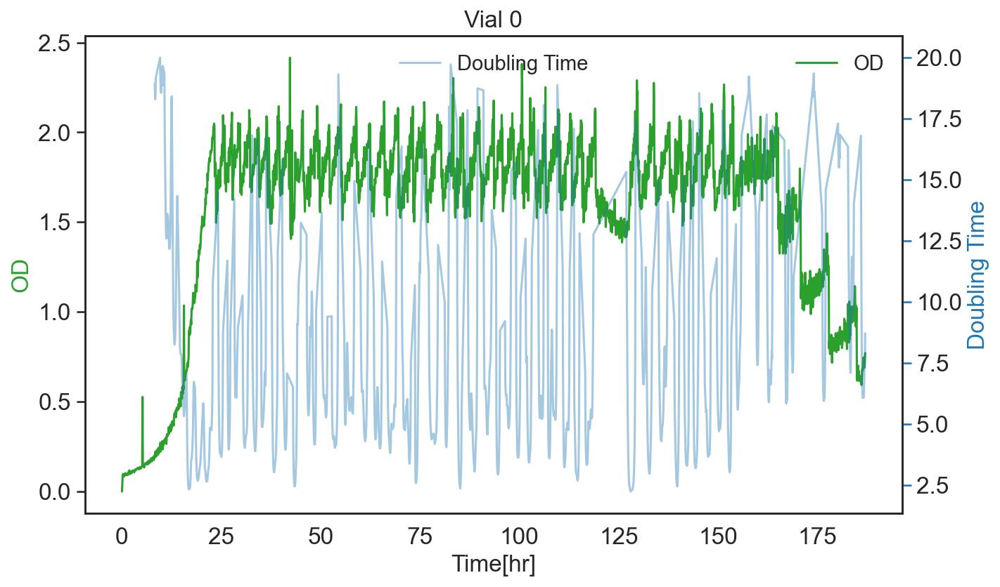

Vial 1:
      Time[hr]        OD  smooth OD
2218  186.6392  0.418719   0.405708
2219  186.7224  0.416615   0.405706
2220  186.8057  0.402883   0.408529
2221  186.8892  0.402176   0.412572
2222  186.9724  0.408529   0.416615
MIN Doubling Time = 2.293049759036182
      Time[hr]        OD  smooth OD  Doubling Time
2037  171.5559  0.981222   0.949927      10.376634
2038  171.6394  0.850380   0.928672      15.092815
2053  172.8892  0.874643   0.888533      14.547693
2054  172.9726  0.889947   0.892065      10.488530
2055  173.0559  0.951748   0.897136       8.510204
2056  173.1393  0.862110   0.923046       7.735431
2057  173.2225  0.955620   0.946758       7.167250
2058  173.3060  0.941768   0.946758       7.162780
2059  173.3893  0.904325   0.946758       7.601559
2060  173.4725  0.953961   0.952854       8.398607
2061  173.5560  0.987249   0.954790       9.588669
2062  173.6392  0.974635   0.964853      12.478703
2063  173.7227  0.935374   0.974360      14.392047
2064  173.8059  1.023178

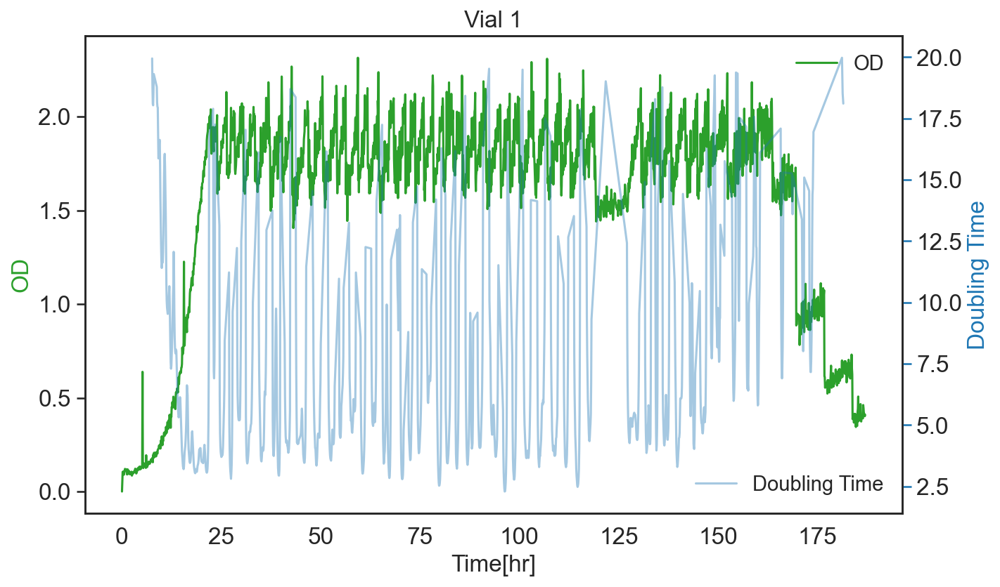

Vial 2:
      Time[hr]        OD  smooth OD
2218  186.6392  1.774764   1.673807
2219  186.7224  1.798544   1.724285
2220  186.8057  1.673807   1.774764
2221  186.8892  1.796441   1.776509
2222  186.9724  1.778254   1.778254
MIN Doubling Time = 2.529341054398797
      Time[hr]        OD  smooth OD  Doubling Time
2189  184.2225  1.645750   1.782096       5.630220
2190  184.3057  1.799245   1.782096       5.624267
2191  184.3891  1.704051   1.774769       5.675374
2192  184.4724  1.940256   1.790496       5.504766
2193  184.5558  1.826668   1.790496       6.041715
2194  184.6391  1.781746   1.812956       6.112547
2195  184.7225  1.767791   1.812956       5.535786
2196  184.8058  1.740682   1.837624       5.194562
2197  184.8891  1.878441   1.858167       5.174350
2198  184.9724  1.848580   1.873097       5.716932
2199  185.0559  1.920026   1.858167       6.421619
2200  185.1391  1.953316   1.873097      11.440396
2215  186.3890  1.668323   1.671065       8.797094
2216  186.4725  1.795040

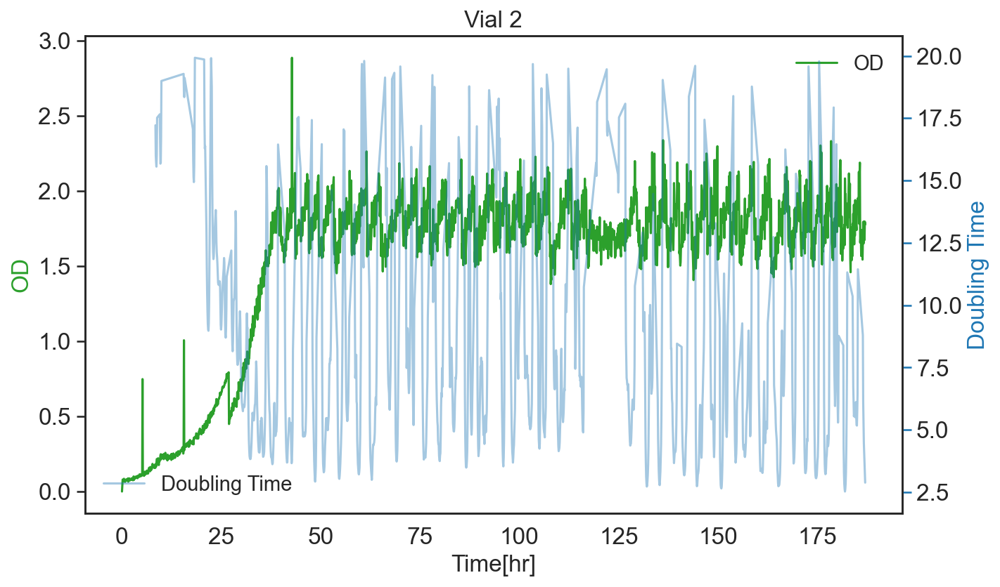

Vial 3:
      Time[hr]        OD  smooth OD
2218  186.6392  1.929528   1.880133
2219  186.7224  2.313838   1.887240
2220  186.8057  1.880133   1.894347
2221  186.8892  1.724408   1.887240
2222  186.9724  1.894347   1.894347
MIN Doubling Time = 2.295098593063393
      Time[hr]        OD  smooth OD  Doubling Time
2203  185.3890  1.606530   1.626914       3.875814
2204  185.4725  1.766500   1.684667       3.568239
2205  185.5558  1.623577   1.687139       3.479797
2206  185.6393  1.849282   1.695795       3.427689
2207  185.7225  1.739083   1.746930       3.569331
2208  185.8057  1.854329   1.754777       3.601038
2209  185.8892  1.754777   1.760638       3.823247
2210  185.9723  1.635194   1.774494       4.427743
2211  186.0558  1.652506   1.782613       4.319957
2212  186.1391  1.782738   1.792125       4.430247
2213  186.2226  1.782488   1.792125       4.729916
2214  186.3058  2.013115   1.827921       4.607828
2215  186.3890  1.863425   1.832469       4.767224
2216  186.4725  1.895872

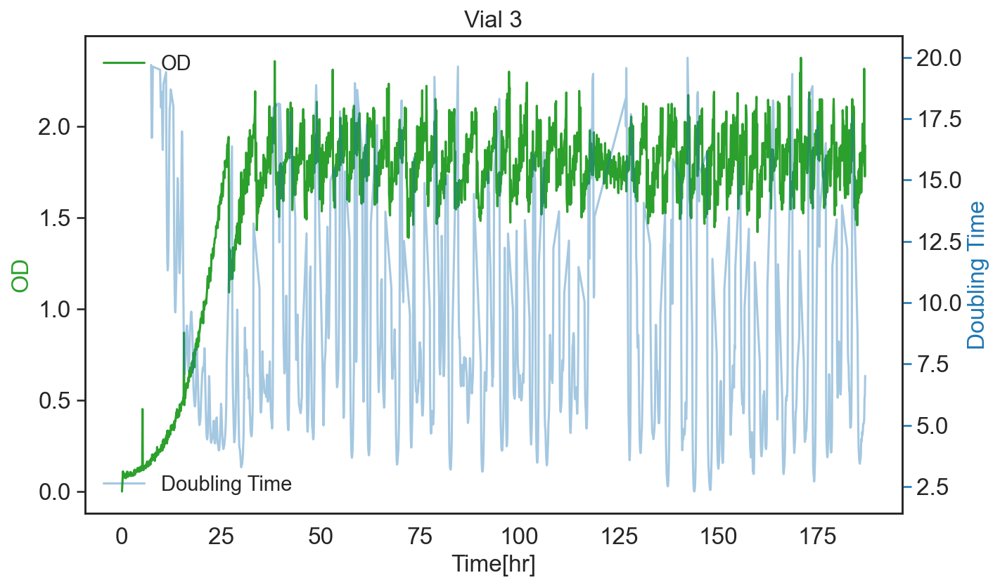

Vial 4:
      Time[hr]        OD  smooth OD
2218  186.6392  1.618691   1.660818
2219  186.7224  1.660818   1.675433
2220  186.8057  1.630543   1.660818
2221  186.8892  1.690048   1.655255
2222  186.9724  1.693517   1.649693
MIN Doubling Time = 2.0191269961555314
      Time[hr]        OD  smooth OD  Doubling Time
2169  182.5558  1.869861   1.823580       4.907981
2170  182.6392  1.807452   1.850856       5.058521
2171  182.7224  1.947650   1.889423       5.107919
2172  182.8059  1.739155   1.928317       5.331930
2173  182.8891  1.815310   1.928317       4.721699
2174  182.9726  2.038126   1.889423       4.566888
2175  183.0558  1.908984   1.889423       5.860655
2176  183.1391  2.088641   1.909585       8.392755
2190  184.3057  1.800389   1.798233      18.112298
2191  184.3891  1.936336   1.783763       7.692638
2192  184.4724  1.771448   1.798233       5.666335
2193  184.5558  2.038126   1.798233       4.223611
2194  184.6391  2.026540   1.798233       3.956877
2195  184.7225  2.04684

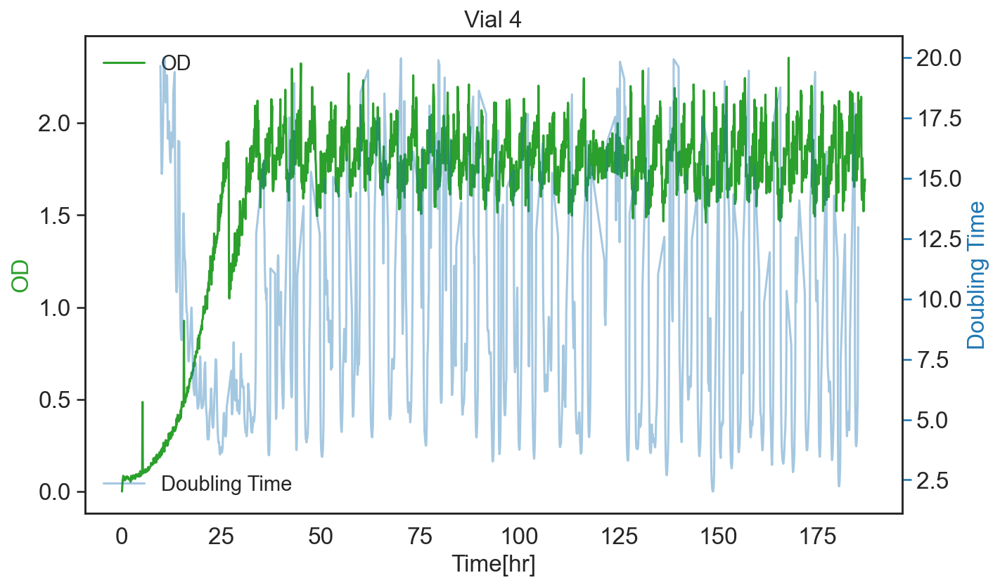

Vial 5:
      Time[hr]        OD  smooth OD
2218  186.6392  1.834452   1.724056
2219  186.7224  1.807993   1.725544
2220  186.8057  1.751799   1.733291
2221  186.8892  1.733291   1.742545
2222  186.9724  1.810332   1.751799
MIN Doubling Time = 3.2611650776571386
      Time[hr]        OD  smooth OD  Doubling Time
2177  183.2226  1.933138   1.893533       3.417054
2178  183.3058  1.976891   1.924582       3.666663
2179  183.3891  1.855985   1.932110       4.149763
2180  183.4726  1.931082   1.924582       5.042908
2181  183.5558  2.089696   1.932110       7.002059
2182  183.6391  1.985211   1.932110      12.864391
2209  185.8892  1.672496   1.654528      17.506926
2210  185.9723  1.682321   1.670860      12.716149
2211  186.0558  1.621593   1.672333       9.543179
2212  186.1391  1.724056   1.672333       7.911362
2213  186.2226  1.691174   1.673478       7.669061
2214  186.3058  1.674460   1.678391       7.670462
2215  186.3890  1.672169   1.686747       7.908817
2216  186.4725  1.71779

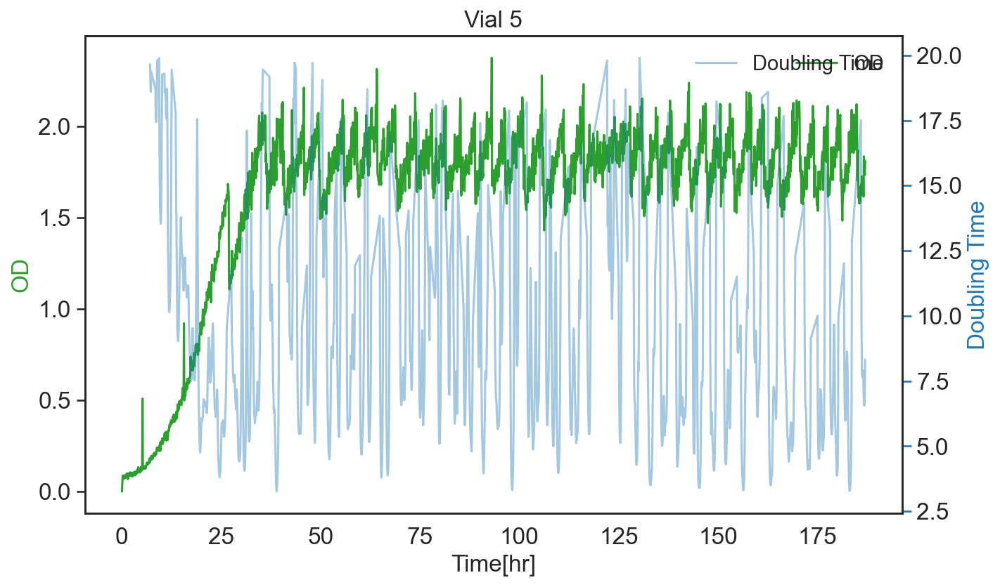

Vial 6:
      Time[hr]        OD  smooth OD
2218  186.6392  0.905132   0.972261
2219  186.7224  0.985714   0.967714
2220  186.8057  0.999992   0.963168
2221  186.8892  0.940187   0.954778
2222  186.9724  1.017404   0.946388
MIN Doubling Time = 2.524674307210562
      Time[hr]        OD  smooth OD  Doubling Time
2050  172.6394  1.884581   1.885975      10.479358
2051  172.7226  1.792707   1.897280      10.879269
2052  172.8058  2.046665   1.897280      12.026126
2053  172.8892  1.934666   1.895886      15.517079
2083  175.3892  1.465427   1.409577      16.339740
2084  175.4725  1.411890   1.433093      16.998920
2101  176.8892  1.445605   1.436910      17.271006
2102  176.9724  1.284931   1.436910      15.247523
2103  177.0559  1.394462   1.442073      13.131972
2104  177.1392  1.481979   1.453073      11.918132
2105  177.2227  1.435280   1.453073      13.718971
2106  177.3059  1.466784   1.444111      17.950634
2169  182.5558  0.935158   0.954788      19.969530
2170  182.6392  0.890468

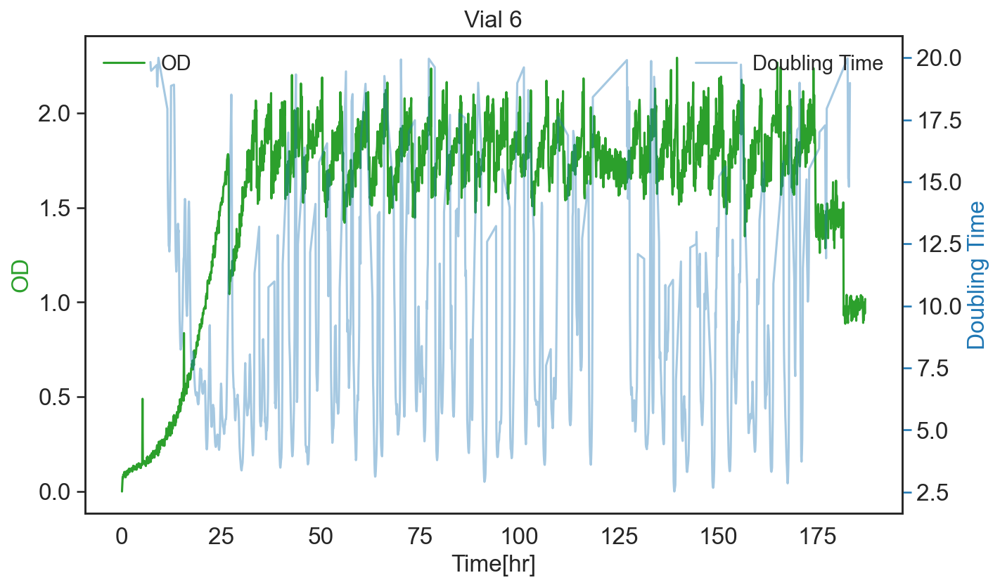

Vial 7:
      Time[hr]        OD  smooth OD
2218  186.6392  0.253834   0.270631
2219  186.7224  0.265960   0.269464
2220  186.8057  0.267908   0.270631
2221  186.8892  0.279937   0.269464
2222  186.9724  0.268297   0.268297
MIN Doubling Time = 2.9565816658961572
      Time[hr]        OD  smooth OD  Doubling Time
1799  151.0554  1.776646   1.835165       7.415499
1800  151.1389  1.810124   1.819259       8.215056
1801  151.2220  1.881590   1.819259       8.556794
1802  151.3054  1.662565   1.819259       8.497118
1803  151.3889  1.807709   1.819259       7.063198
1804  151.4721  1.860207   1.844300       6.514267
1805  151.5556  1.828394   1.844300       6.104621
1806  151.6388  1.943737   1.864398       5.521259
1807  151.7220  1.801004   1.875090       6.314692
1808  151.8055  1.894618   1.881604       7.709650
1876  157.4720  1.706586   1.609000      19.931997
1877  157.5555  1.691190   1.609000      18.284013
1962  164.8888  1.552340   1.483907      13.998940
1963  164.9720  1.40389

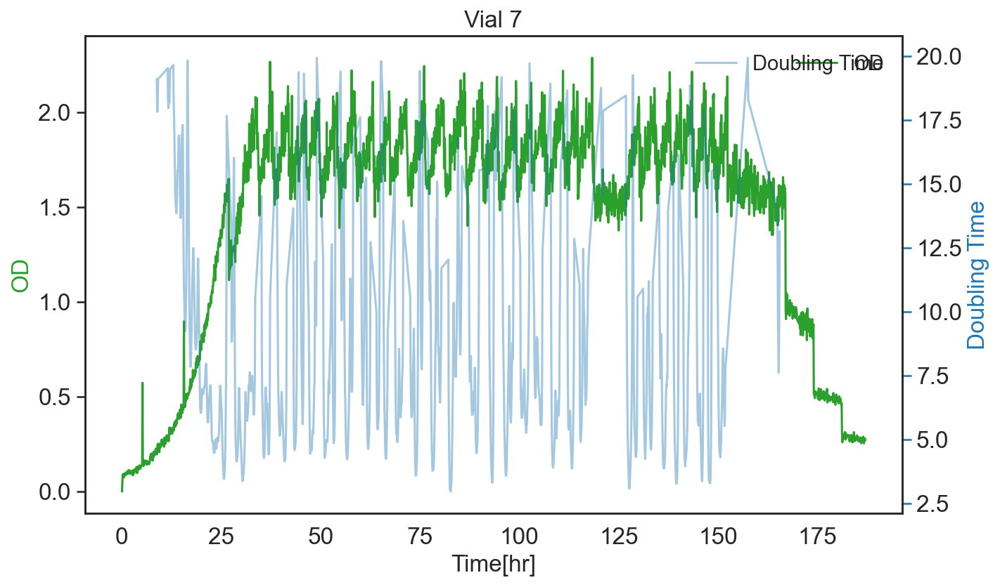

Vial 8:
      Time[hr]        OD  smooth OD
2218  186.6392  0.433801   0.398877
2219  186.7224  0.367649   0.398257
2220  186.8057  0.391419   0.397636
2221  186.8892  0.396808   0.397843
2222  186.9724  0.456147   0.396808
MIN Doubling Time = 2.5916417707843236
      Time[hr]        OD  smooth OD  Doubling Time
1829  153.5556  1.631888   1.630019      15.650924
1830  153.6388  1.628150   1.633587      15.872633
1831  153.7220  1.635287   1.633587      17.352293
1871  157.0554  1.710738   1.532069      19.247356
1939  162.7221  1.507801   1.430455      17.307842
1940  162.8053  1.456667   1.445745      15.593426
1941  162.8888  1.484577   1.445745      13.741096
1942  162.9720  1.470114   1.456835      12.425816
1943  163.0555  1.409292   1.463559      10.889649
1944  163.1387  1.426088   1.463559      10.175305
1945  163.2219  1.562775   1.477346      10.016662
1946  163.3054  1.407612   1.477346      12.153580
1947  163.3886  1.457003   1.489120      14.443500
1948  163.4720  1.49366

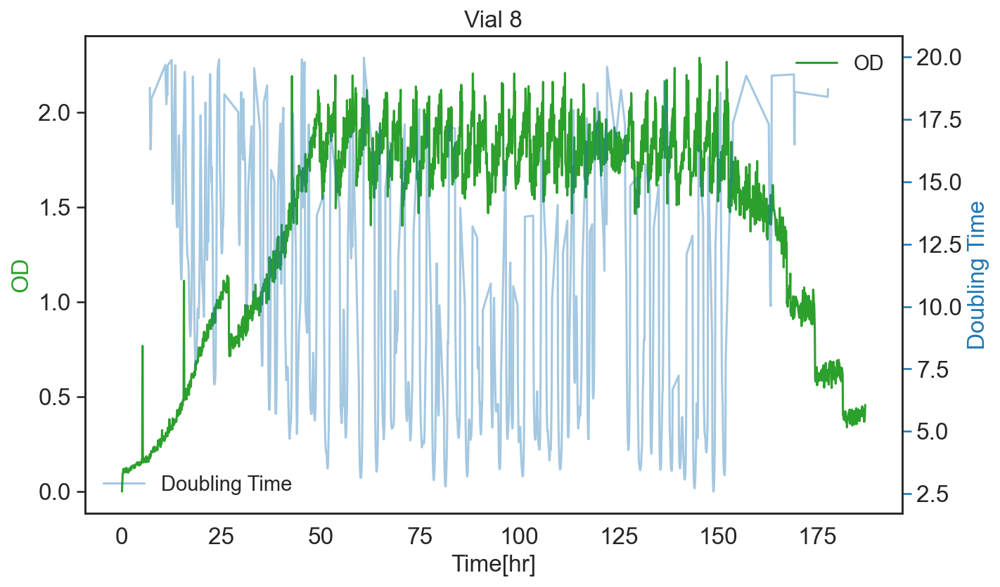

Vial 9:
      Time[hr]        OD  smooth OD
2218  186.6392  0.931841   0.865299
2219  186.7224  0.880720   0.856553
2220  186.8057  0.818204   0.842090
2221  186.8892  0.771842   0.841229
2222  186.9724  0.842090   0.842090
MIN Doubling Time = 2.6142613397929875
      Time[hr]        OD  smooth OD  Doubling Time
2177  183.2226  0.771551   0.751553      12.805299
2178  183.3058  0.761057   0.753311      15.071175
2179  183.3891  0.742050   0.753311      18.138896
2186  183.9726  0.727374   0.768929      16.653553
2187  184.0558  0.749955   0.763389      14.235506
2188  184.1390  0.815031   0.767756      14.148529
2189  184.2225  0.823682   0.754484      14.601239
2190  184.3057  0.799711   0.774436      15.703208
2191  184.3891  0.830880   0.794640      17.950218
2201  185.2226  0.726492   0.788844      14.607237
2202  185.3058  0.867587   0.797241      10.665935
2203  185.3890  0.847830   0.792611       9.140919
2204  185.4725  0.838356   0.802024       8.620361
2205  185.5558  0.66697

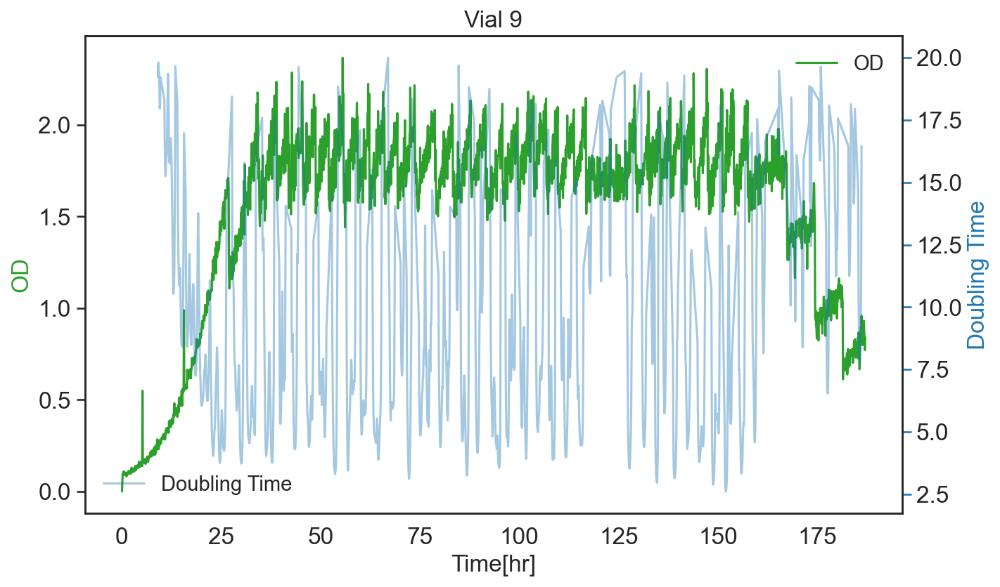

Vial 10:
      Time[hr]        OD  smooth OD
2218  186.6392  0.603503   0.551115
2219  186.7224  0.567792   0.559229
2220  186.8057  0.550663   0.567343
2221  186.8892  0.501818   0.559229
2222  186.9724  0.522473   0.567343
MIN Doubling Time = 2.713217837330443
      Time[hr]        OD  smooth OD  Doubling Time
1973  165.8054  1.856043   1.867811      15.615142
2014  169.2226  1.120518   1.128277      15.623820
2015  169.3061  1.185083   1.150151      10.590754
2016  169.3892  1.047859   1.150151       9.426743
2017  169.4728  1.115856   1.173713      11.580641
2018  169.5560  1.136035   1.173713      15.031843
2019  169.6394  1.192395   1.182773      18.985107
2034  171.3060  1.195471   1.151872      14.675313
2035  171.3892  1.104575   1.174296      12.267533
2036  171.4727  1.173911   1.182384      10.706908
2037  171.5559  1.115467   1.174296      12.493444
2038  171.6394  1.278164   1.167158      15.155730
2102  176.9724  0.781663   0.766982      18.069574
2103  177.0559  0.81125

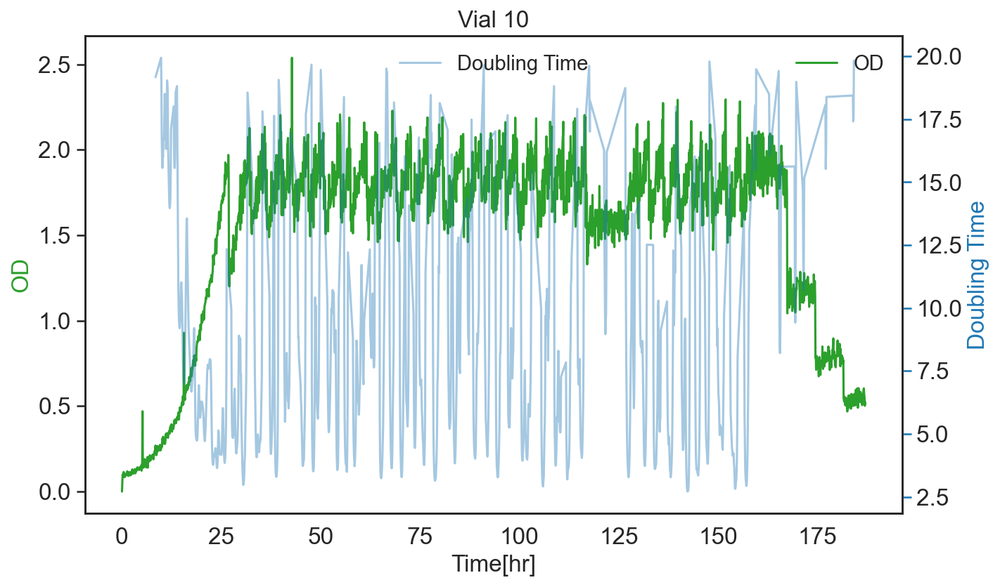

Vial 11:
      Time[hr]        OD  smooth OD
2218  186.6392  0.360914   0.374297
2219  186.7224  0.352450   0.374487
2220  186.8057  0.374297   0.374297
2221  186.8892  0.376200   0.374868
2222  186.9724  0.375820   0.374297
MIN Doubling Time = 3.273271651016706
      Time[hr]        OD  smooth OD  Doubling Time
1889  158.5555  1.887289   1.876683      14.622648
1891  158.7222  1.954287   1.876683      18.529011
1892  158.8054  1.835871   1.876683      15.689156
1893  158.8887  2.008352   1.876683      10.755371
1894  158.9722  2.069698   1.876683       8.787384
1895  159.0554  1.869038   1.883126       9.086410
1896  159.1389  1.841745   1.883126       7.959609
1897  159.2221  1.867162   1.915229       7.458432
1898  159.3053  1.852972   1.915229       7.388583
1899  159.3888  2.001220   1.951848       7.723204
1900  159.4720  1.886214   1.951848       9.966584
1901  159.5555  1.944244   1.923569      14.992349
2089  175.8891  0.611488   0.565711      18.890863
2090  175.9726  0.55829

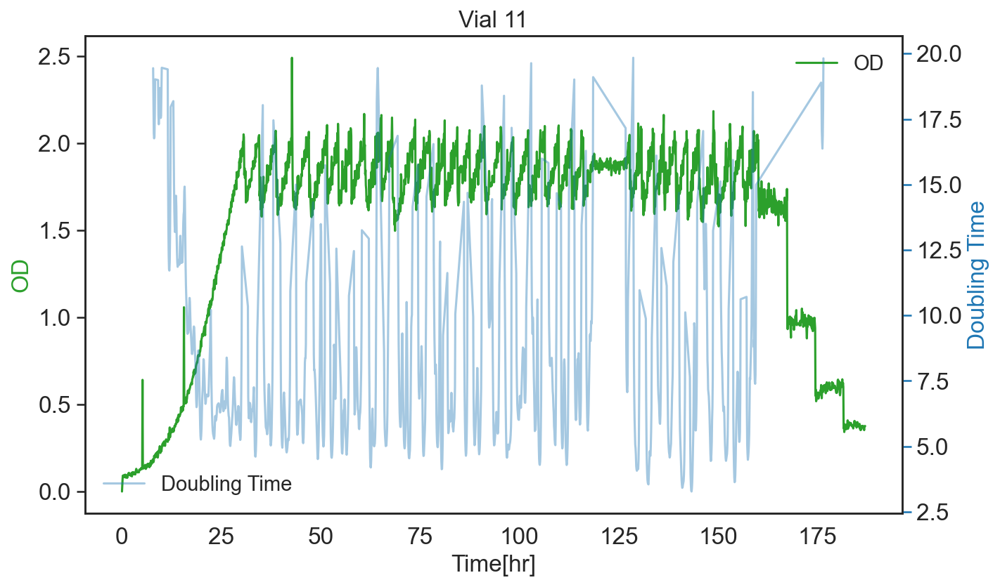

Vial 12:
      Time[hr]        OD  smooth OD
2218  186.6392  0.386865   0.398679
2219  186.7224  0.377963   0.393324
2220  186.8057  0.381676   0.386865
2221  186.8892  0.364167   0.384271
2222  186.9724  0.372008   0.381676
MIN Doubling Time = 2.3277309562729225
      Time[hr]        OD  smooth OD  Doubling Time
2048  172.4726  1.031935   1.032534      14.631831
2049  172.5559  1.025933   1.032684      10.634558
2050  172.6394  1.020525   1.032684       8.844134
2051  172.7226  1.119446   1.071402       7.974050
2052  172.8058  1.025032   1.049276       8.447881
2053  172.8892  1.110869   1.081039       9.368705
2054  172.9726  1.117377   1.081039      13.223508
2089  175.8891  0.576883   0.624135      16.865208
2090  175.9726  0.614212   0.624135      13.399931
2091  176.0559  0.602391   0.624135      12.731916
2092  176.1394  0.674549   0.624135      11.884575
2093  176.2226  0.623631   0.640661      12.802944
2094  176.3058  0.656682   0.656019      13.439830
2095  176.3893  0.6246

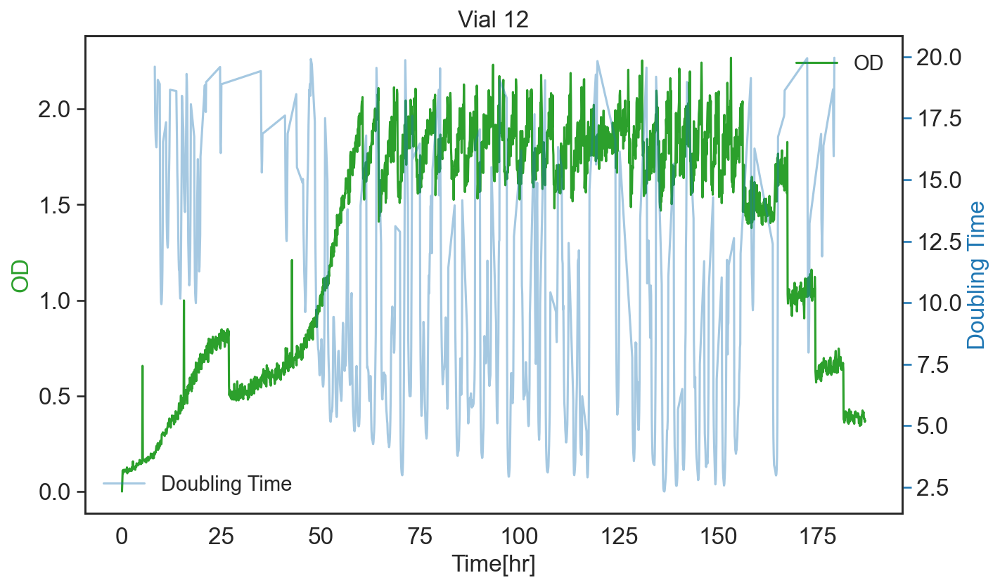

Vial 13:
      Time[hr]        OD  smooth OD
2218  186.6392  0.489155   0.504476
2219  186.7224  0.518725   0.505461
2220  186.8057  0.506446   0.506446
2221  186.8892  0.480714   0.505461
2222  186.9724  0.515783   0.506446
MIN Doubling Time = 3.013144488358793
      Time[hr]        OD  smooth OD  Doubling Time
1847  155.0554  1.820392   1.808860       5.936048
1848  155.1386  1.766892   1.808860       7.768759
1849  155.2220  1.806975   1.808860      10.547206
1850  155.3056  1.819133   1.808860      18.552906
1896  159.1389  1.868447   1.820606      19.622295
1942  162.9720  1.699347   1.738875      19.463252
1943  163.0555  1.772306   1.746120      13.253420
1944  163.1387  1.719177   1.749447      13.594618
1945  163.2219  1.771473   1.739473      13.163066
1946  163.3054  1.766476   1.740095      17.097807
1962  164.8888  1.796095   1.755466      14.675352
1963  164.9720  1.783146   1.748395      14.962700
1964  165.0554  1.695634   1.761486      18.020799
1965  165.1386  1.80153

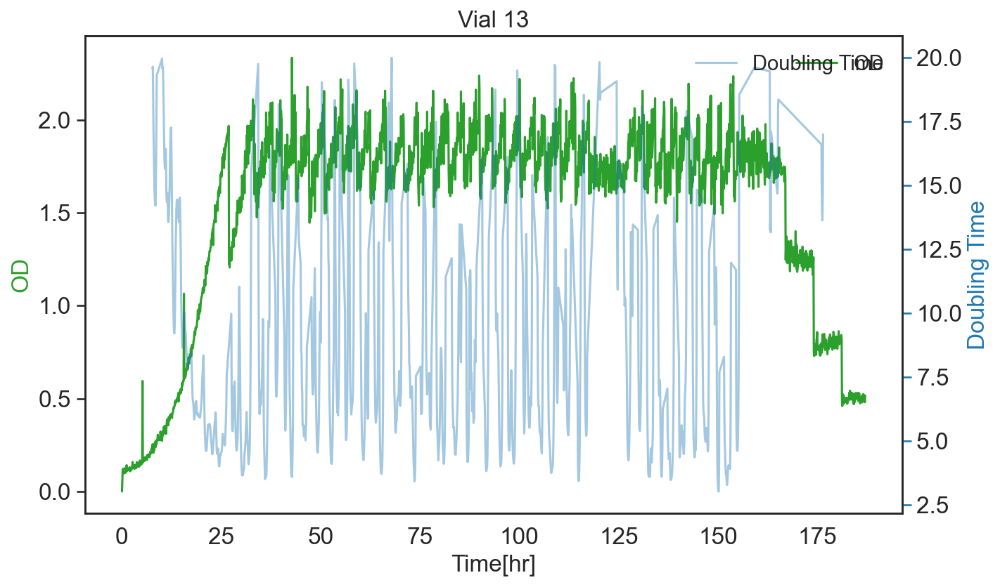

Vial 14:
      Time[hr]        OD  smooth OD
2218  186.6392  0.412657   0.370679
2219  186.7224  0.381705   0.376192
2220  186.8057  0.348421   0.370679
2221  186.8892  0.385219   0.364464
2222  186.9724  0.353788   0.370679
MIN Doubling Time = 2.781785389777483
      Time[hr]        OD  smooth OD  Doubling Time
1910  160.3054  1.735721   1.690060      10.906653
1911  160.3886  1.619489   1.727231      10.378929
1912  160.4721  1.594515   1.727231       8.416404
1913  160.5553  1.778298   1.708384       6.968768
1914  160.6388  1.855192   1.727231       7.570451
1915  160.7220  1.719999   1.727231       8.908573
1916  160.8053  1.734463   1.735092       9.787559
1917  160.8888  1.762506   1.740287      10.310039
1918  160.9720  1.696768   1.754309       9.733398
1919  161.0555  1.809974   1.770402       8.806623
1920  161.1387  1.707750   1.754309       9.177103
1921  161.2219  1.856790   1.754309       9.256248
1922  161.3054  1.746111   1.786240      12.602933
1923  161.3886  1.91137

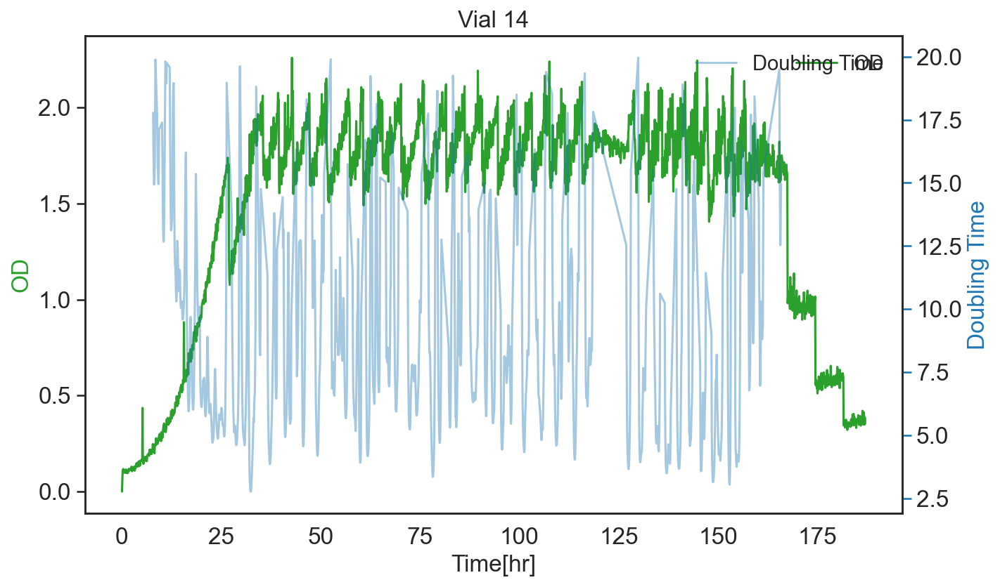

Vial 15:
      Time[hr]        OD  smooth OD
2218  186.6392  0.138233   0.138233
2219  186.7224  0.133811   0.138233
2220  186.8057  0.138233   0.138233
2221  186.8892  0.128890   0.137497
2222  186.9724  0.136760   0.138233
MIN Doubling Time = 2.7010018360847536
      Time[hr]        OD  smooth OD  Doubling Time
1989  167.1394  0.399412   0.415946      13.161781
1990  167.2228  0.400756   0.415946      11.086475
1991  167.3075  0.423518   0.415946       9.870178
1992  167.3893  0.464187   0.421738       9.370000
1993  167.4727  0.469017   0.432611       9.323367
1994  167.5561  0.465944   0.442367      10.048629
1995  167.6393  0.403442   0.452070      11.679135
1996  167.7227  0.471649   0.462649      13.625619
1997  167.8059  0.441703   0.465066      17.443664
2004  168.3893  0.483467   0.469227      15.279224
2005  168.4728  0.450980   0.478657      11.873157
2006  168.5560  0.435505   0.481718       9.664429
2007  168.6392  0.430627   0.486959       8.738270
2008  168.7227  0.5061

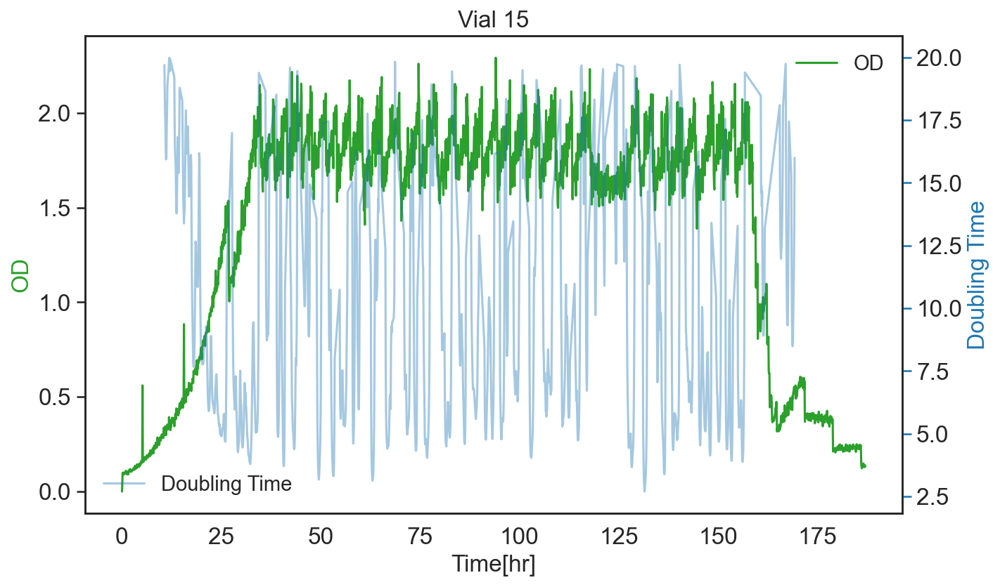

In [215]:
# Variables for Plot Generation
df_range = [0, 9999] # range to plot data in

y1name = 'OD' #left y-axis variable name
y2name = doublename #right y-axis variable name; put None if you want a plot with one y-axis
eventname = None #vertical lines when an event occured; put None if you want a plot without events; example: pumpname for pumps

save_plots = False # whether to save plots
logscale = False

fitrange = 12 # Window size for rolling growth rate finder

df_all = None
# Generating Plots
for x in vial_nums:
    print(f"Vial {x}:")
    colnames=[timename,y1name]
    folder1 = name_to_foldername[y1name]
    df1 = read_csv(x,folder1,colnames)
    df1 = df1[df1[timename].between(df_range[0], df_range[1])]
    df1['smooth OD'] = df1[y1name].rolling(fitrange, center=True, min_periods=1).median() # perform rolling median smoothing
    print(df1.tail())
    df2 = None
    if y2name == gratename:
        # deep copy df1
        df2 = df1.copy(deep=True)
        df2[gratename] = calculate_rolling_metric(df1[timename], df1['OD'], fitrange, calculation=gratename, smooth=False)
        print(df2.tail())
    elif y2name == doublename:
        df2 = df1.copy(deep=True)
        df2[doublename] = calculate_rolling_metric(df1[timename], df1['OD'], fitrange, calculation=doublename, smooth=True)
        df2 = df2[df2[doublename] < 20]
        print(f'MIN {doublename} = {df2[doublename].min()}')
        print(df2.tail(20))
    elif y2name is not None:
        colnames = [timename,y2name]
        folder2 = name_to_foldername[y2name]
        df2 = read_csv(x,folder2,colnames)
        df2 = df2[df2[timename].between(df_range[0], df_range[1])]
        print(df2.tail())
    
    eventdf = None
    eventlist = None
    if eventname is not None:
        colnames = [timename,eventname]
        eventfolder = name_to_foldername[eventname]
        eventdf = read_csv(x,eventfolder,colnames)
#         print(eventdf.head())
        eventlist = eventdf[timename]
#         print(eventlist)
        
    plot(df1,df2,x=x,y1name=y1name,y2name=y2name,save_plots=save_plots,logscale=logscale,eventlist=eventlist,eventname=eventname)


## OD Values vs Min Doubling Time

Vial 0:
MIN Doubling Time = 2.3225224582648885
      Time[hr]        OD  smooth OD  Doubling Time
1157   97.3059  1.862011   1.837433       4.822781
1158   97.3895  1.878604   1.870307       4.886772
1159   97.4727  1.802760   1.870307       5.081275
1160   97.5559  1.960165   1.879883       5.320525
1161   97.6395  1.911315   1.889009       5.815608
1162   97.7227  1.881162   1.901352       6.715762
1163   97.8062  2.024749   1.901352       8.496443
1164   97.8894  1.847058   1.908581      11.918804
1165   97.9726  1.896856   1.912763      15.366968
1179   99.1392  1.777910   1.730079      18.710377
1180   99.2227  1.754096   1.751439       8.223697
1181   99.3059  1.861373   1.760828       6.485529
1182   99.3894  1.748781   1.772735       6.246905
1183   99.4726  1.767559   1.788444       5.946859
1184   99.5561  1.798979   1.788444       5.750934
1185   99.6393  1.908098   1.798979       5.751736
1186   99.7228  1.846423   1.816831       6.162969
1187   99.8061  1.934865   1.834683

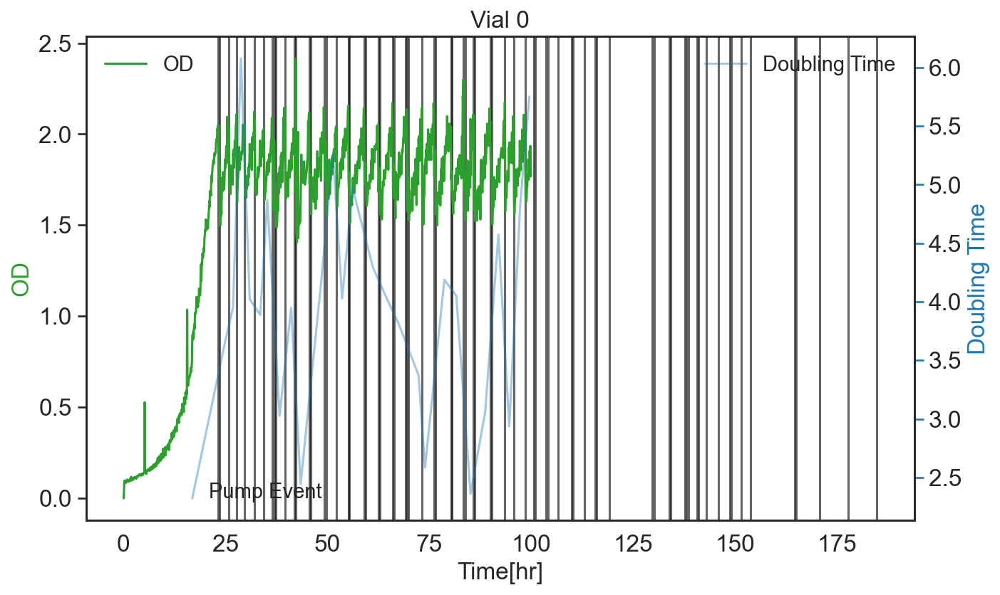

Vial 1:
MIN Doubling Time = 2.293049759036182
      Time[hr]        OD  smooth OD  Doubling Time
1150   96.7227  1.922168   1.947578       3.756279
1151   96.8060  1.981345   1.962105       4.912435
1152   96.8895  1.981086   1.962105       7.799650
1153   96.9726  1.933696   1.971918      16.542323
1168   98.2228  1.628964   1.752489       7.829117
1169   98.3060  1.749984   1.752489       4.892207
1170   98.3893  1.870939   1.777589       3.611096
1171   98.4728  1.817564   1.800562       3.158867
1172   98.5559  1.754994   1.808874       2.961712
1173   98.6394  1.985227   1.844252       2.781780
1174   98.7226  1.739470   1.875004       2.781511
1175   98.8062  1.979017   1.892312       2.906316
1176   98.8894  1.879068   1.938281       3.249616
1177   98.9726  2.070160   1.938281       3.712501
1178   99.0561  1.905556   1.938281       4.439613
1179   99.1392  1.978499   1.972168       5.846720
1180   99.2227  1.973330   1.972168       8.060804
1181   99.3059  1.971006   1.972168 

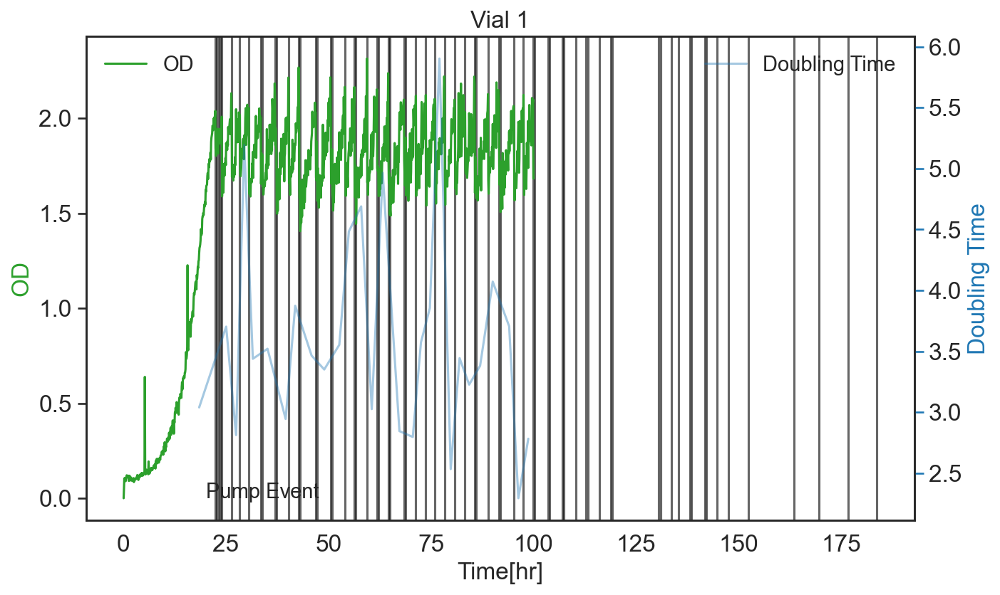

Vial 2:
MIN Doubling Time = 2.9265680696279266
      Time[hr]        OD  smooth OD  Doubling Time
1170   98.3893  1.933742   1.775819       3.688853
1171   98.4728  1.757348   1.791191       3.911021
1172   98.5559  1.872025   1.821090       4.229806
1173   98.6394  1.930850   1.842916       4.384272
1174   98.7226  1.978111   1.842916       4.886925
1175   98.8062  1.674493   1.858532       5.343958
1176   98.8894  1.907075   1.888473       5.792985
1177   98.9726  1.845039   1.858532       7.171359
1178   99.0561  1.840793   1.878089       9.220185
1179   99.1392  1.811179   1.894536      11.150689
1180   99.2227  1.906357   1.894536      12.843394
1181   99.3059  1.904920   1.894536      16.758677
1182   99.3894  1.828784   1.905639      18.439175
1183   99.4726  1.884152   1.894536      13.070656
1184   99.5561  1.943154   1.900259      15.426070
1185   99.6393  2.130737   1.904920      16.550194
1186   99.7228  2.017842   1.905639      14.759245
1187   99.8061  1.949684   1.904920

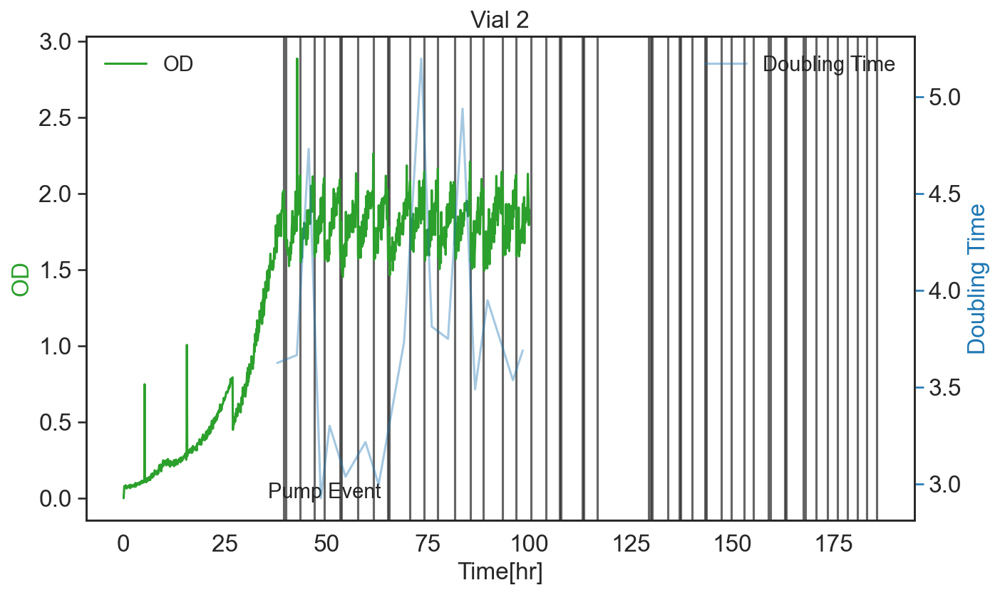

Vial 3:
MIN Doubling Time = 3.1055623663963994
      Time[hr]        OD  smooth OD  Doubling Time
1155   97.1393  1.939769   1.996446      12.815513
1170   98.3893  1.617894   1.629138       9.717166
1171   98.4728  1.612706   1.629138       7.615488
1172   98.5559  1.786240   1.630003       6.520117
1173   98.6394  1.628520   1.630003       6.238851
1174   98.7226  1.708012   1.667270       6.165584
1175   98.8062  1.770744   1.706151       6.077607
1176   98.8894  1.704289   1.706151       6.204213
1177   98.9726  1.766500   1.706151       6.722702
1178   99.0561  1.618141   1.711613       7.861083
1179   99.1392  1.821839   1.706151       9.749700
1180   99.2227  1.715214   1.711613      15.969062
1182   99.3894  1.570724   1.724660      18.474432
1183   99.4726  1.734106   1.724660      14.368142
1184   99.5561  1.626049   1.724660      13.785287
1185   99.6393  1.767249   1.734106      12.722590
1186   99.7228  1.779238   1.724660      12.890355
1187   99.8061  1.789742   1.734106

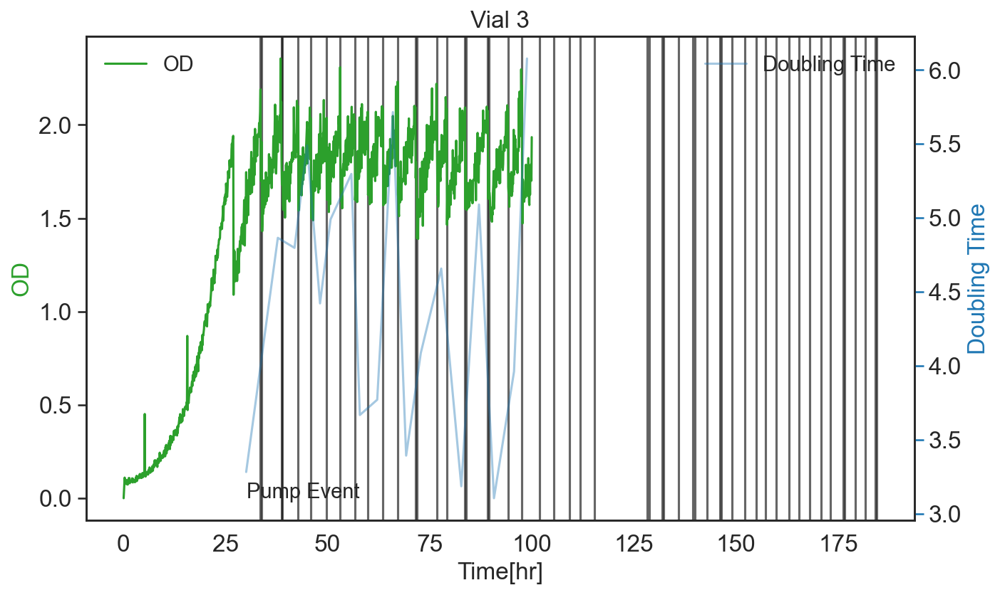

Vial 4:
MIN Doubling Time = 3.26246199177883
      Time[hr]        OD  smooth OD  Doubling Time
1144   96.2229  1.760145   1.769306       5.430547
1145   96.3061  1.831850   1.803600       5.256429
1146   96.3893  1.912594   1.842126       5.177030
1147   96.4728  1.852403   1.855970       5.385170
1148   96.5560  1.892975   1.858744       5.697086
1149   96.6395  1.859537   1.858744       6.475832
1150   96.7227  1.966714   1.858744       6.639152
1151   96.8060  2.122892   1.858744       9.291851
1152   96.8895  1.886587   1.870670      14.632802
1172   98.5559  1.773009   1.645097      15.337284
1173   98.6394  1.604563   1.633223      10.744183
1174   98.7226  1.686196   1.645097       7.985496
1175   98.8062  1.637050   1.657557       7.267145
1176   98.8894  1.661970   1.674083       6.960645
1177   98.9726  1.739931   1.674083       7.186732
1178   99.0561  1.629396   1.706085       7.193373
1179   99.1392  1.725973   1.699120       7.452372
1180   99.2227  1.792944   1.714171  

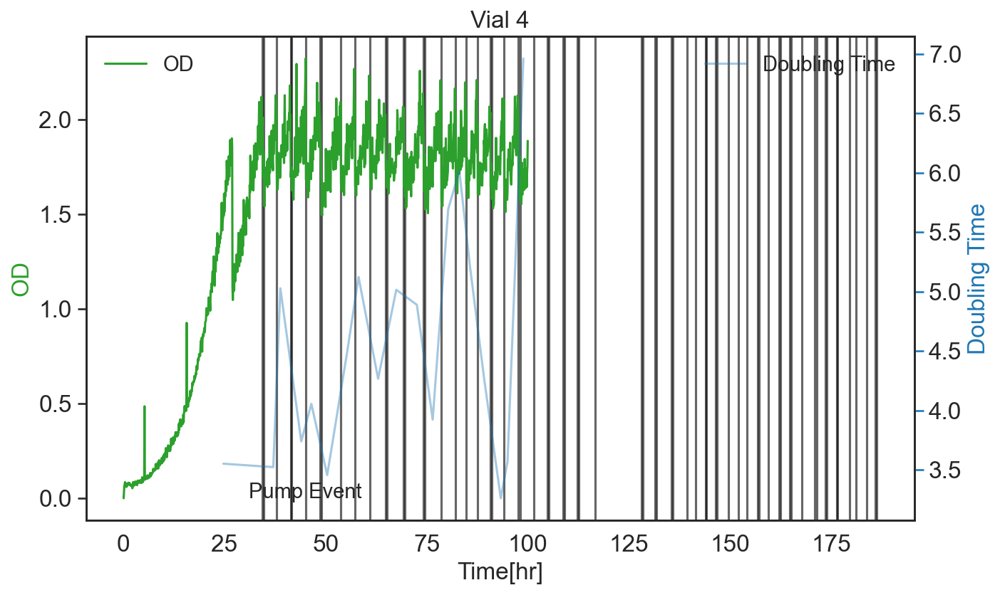

Vial 5:
MIN Doubling Time = 3.2611650776571386
      Time[hr]        OD  smooth OD  Doubling Time
1165   97.9726  1.765052   1.733291       4.104471
1166   98.0561  1.705295   1.748181       3.577827
1167   98.1393  1.776339   1.770695       3.347440
1168   98.2228  1.938968   1.785825       3.314009
1169   98.3060  1.923893   1.834260       3.582087
1170   98.3893  1.969625   1.868816       4.037564
1171   98.4728  1.795310   1.868816       4.790894
1172   98.5559  1.897972   1.885591       6.261581
1173   98.6394  1.958921   1.885591       9.291643
1174   98.7226  1.873210   1.885591      16.965696
1178   99.0561  1.866448   1.869829      15.781885
1179   99.1392  1.855311   1.869829      11.904152
1180   99.2227  1.770693   1.869829       9.867451
1181   99.3059  1.862733   1.893974       8.671054
1182   99.3894  1.921499   1.923380       8.603307
1183   99.4726  1.931767   1.926117       9.097524
1184   99.5561  1.925261   1.923380       9.277797
1185   99.6393  2.053832   1.925261

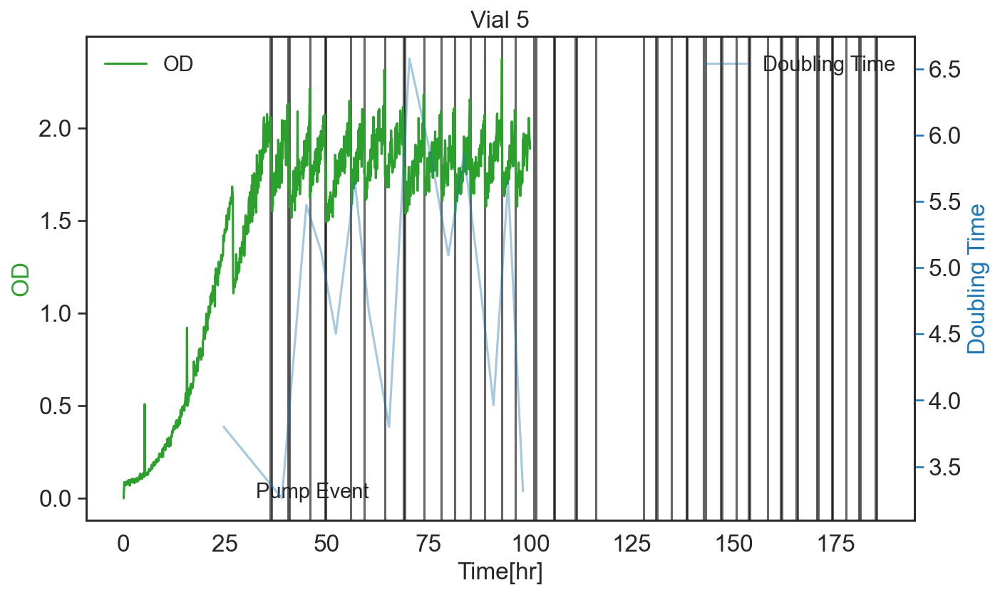

Vial 6:
MIN Doubling Time = 2.914145016347873
      Time[hr]        OD  smooth OD  Doubling Time
1137   95.6395  1.812258   1.901922       9.587277
1138   95.7227  1.939728   1.919792      15.506472
1160   97.5559  1.698282   1.647810      13.964511
1161   97.6395  1.628390   1.661806       6.004812
1162   97.7227  1.637350   1.681811       4.707722
1163   97.8062  1.826608   1.699781       4.243564
1164   97.8894  1.701280   1.716428       4.195433
1165   97.9726  1.775945   1.747315       4.053788
1166   98.0561  1.731577   1.758394       3.867366
1167   98.1393  1.763052   1.769499       3.897614
1168   98.2228  1.857058   1.779928       4.094135
1169   98.3060  1.862331   1.779928       4.503472
1170   98.3893  1.783910   1.779928       5.219211
1171   98.4728  1.753736   1.811894       6.174913
1172   98.5559  1.850957   1.845418       6.941819
1173   98.6394  1.839879   1.854008       7.667285
1174   98.7226  1.760586   1.854008       8.724338
1175   98.8062  1.890156   1.845418 

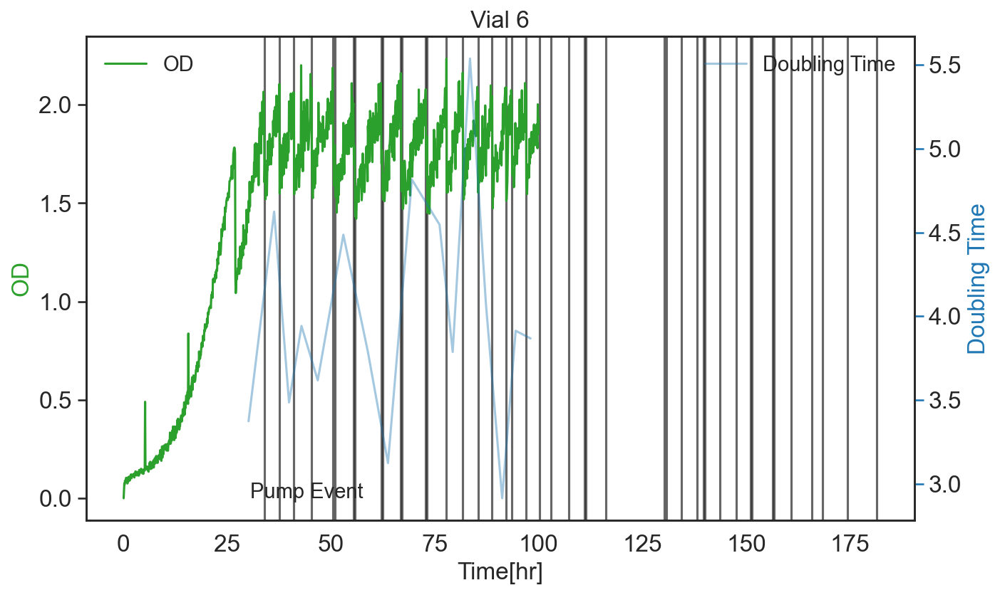

Vial 7:
MIN Doubling Time = 2.9565816658961572
      Time[hr]        OD  smooth OD  Doubling Time
1153   96.9726  1.799396   1.788021       5.179723
1154   97.0560  1.776646   1.809190       5.881094
1155   97.1393  1.818985   1.809190       6.718238
1156   97.2227  1.719606   1.809190       7.471136
1157   97.3059  1.860747   1.809190       8.074094
1158   97.3895  1.869942   1.794709       9.433499
1159   97.4727  1.832968   1.809190      10.222543
1160   97.5559  1.704461   1.825976       8.805072
1161   97.6395  1.840509   1.836739       6.951363
1162   97.7227  1.746221   1.850628       6.079924
1163   97.8062  1.790021   1.850628       5.697665
1164   97.8894  1.950869   1.855226       5.653437
1165   97.9726  1.928136   1.858339       6.293386
1166   98.0561  2.044559   1.892603       7.167179
1167   98.1393  1.876170   1.910808       8.220928
1168   98.2228  1.801809   1.910808       8.778521
1169   98.3060  1.909037   1.910944       8.128219
1170   98.3893  2.009409   1.910944

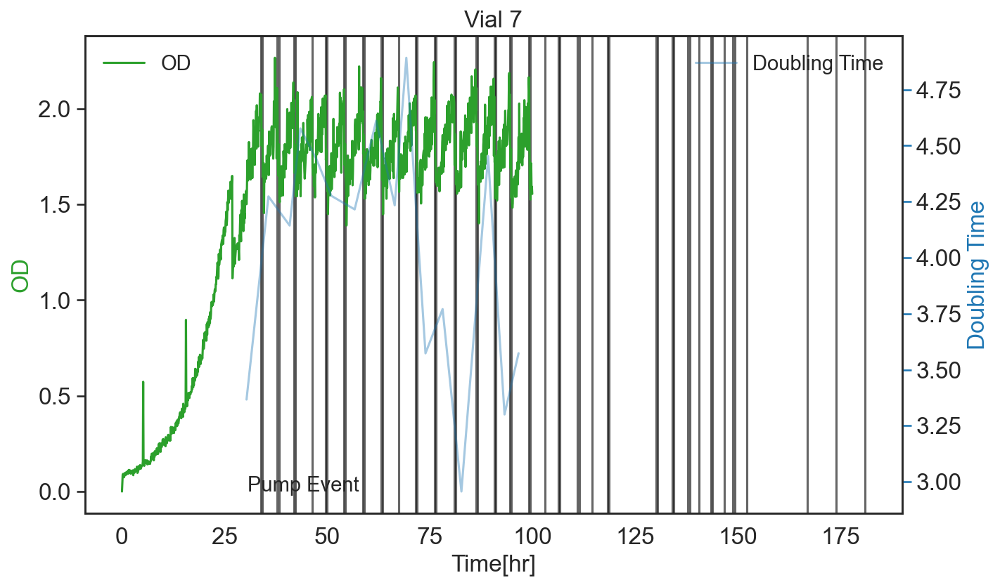

Vial 8:
MIN Doubling Time = 2.7980445561267917
      Time[hr]        OD  smooth OD  Doubling Time
1152   96.8895  1.812687   1.744775       4.960065
1153   96.9726  1.748567   1.756680       4.699106
1154   97.0560  1.791470   1.778132       4.756125
1155   97.1393  1.831186   1.792511       5.003874
1156   97.2227  1.764794   1.803120       5.231808
1157   97.3059  1.793553   1.821936       5.597995
1158   97.3895  2.013632   1.821936       6.257322
1159   97.4727  1.858176   1.841169       7.535103
1160   97.5559  1.851854   1.841169       9.673068
1161   97.6395  1.851152   1.851503      11.421855
1162   97.7227  1.880717   1.851503      11.763642
1163   97.8062  1.790428   1.851503      10.060168
1164   97.8894  1.962270   1.851503       7.512972
1165   97.9726  1.798070   1.851503       6.474141
1166   98.0561  1.893442   1.851503       5.671532
1167   98.1393  1.781063   1.865935       5.328017
1168   98.2228  1.808159   1.887080       5.117081
1169   98.3060  1.829438   1.920142

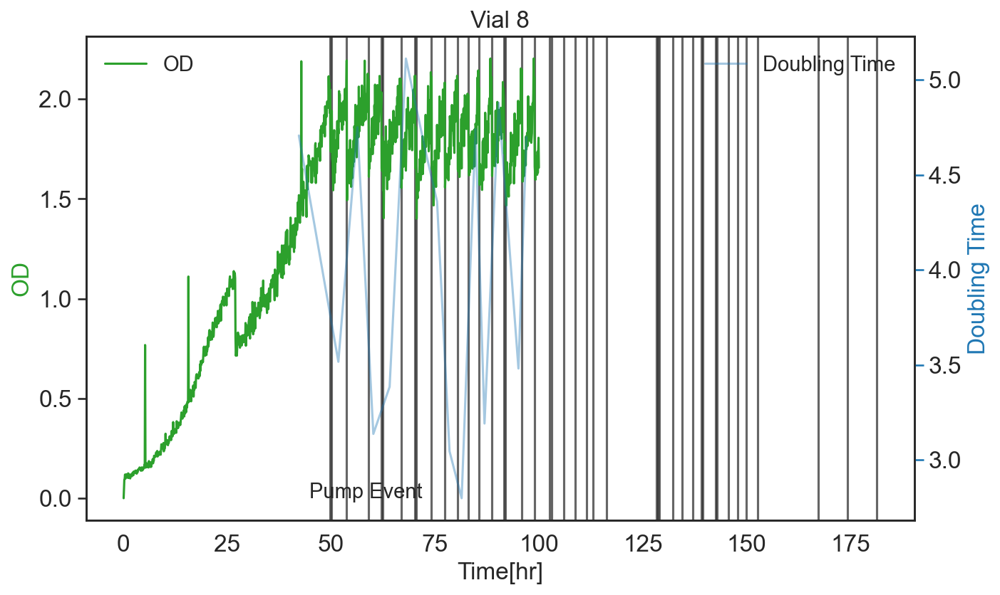

Vial 9:
MIN Doubling Time = 3.113344909776057
      Time[hr]        OD  smooth OD  Doubling Time
1159   97.4727  1.784430   1.777100       9.508323
1160   97.5559  1.752857   1.812508       8.579707
1161   97.6395  1.728010   1.848167       7.331098
1162   97.7227  1.855749   1.848167       7.122673
1163   97.8062  1.687674   1.812508       7.053208
1164   97.8894  1.840586   1.812508       7.063664
1165   97.9726  1.932345   1.812508       7.724497
1166   98.0561  1.968478   1.848167       9.501712
1167   98.1393  1.901838   1.863355      10.512035
1168   98.2228  1.706106   1.863355       9.741861
1169   98.3060  1.723737   1.875068       8.189857
1170   98.3893  1.870961   1.890506       7.595871
1171   98.4728  1.945744   1.890506       7.722105
1172   98.5559  2.000108   1.876680       8.092218
1173   98.6394  1.838839   1.876680       7.790302
1174   98.7226  1.879174   1.876680       7.483727
1175   98.8062  1.925513   1.902344       7.652309
1176   98.8894  1.874186   1.935629 

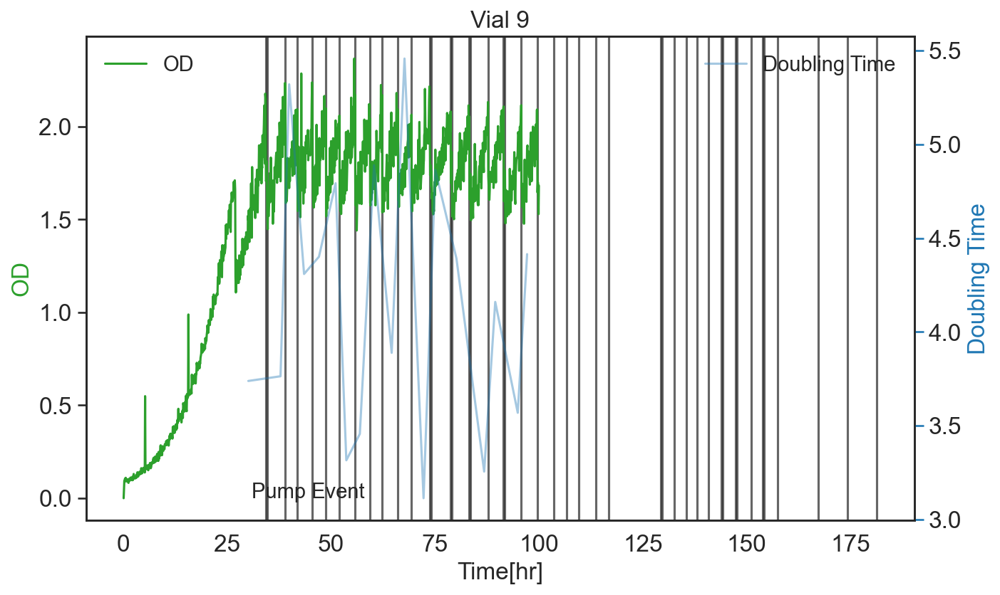

Vial 10:
MIN Doubling Time = 2.976570201784422
      Time[hr]        OD  smooth OD  Doubling Time
1155   97.1393  1.728115   1.771892       7.242365
1156   97.2227  1.795275   1.795081       5.671485
1157   97.3059  1.840796   1.795081       5.396422
1158   97.3895  1.794887   1.806343       5.254003
1159   97.4727  1.879579   1.807705       5.292926
1160   97.5559  1.933707   1.830075       5.261369
1161   97.6395  1.940464   1.840405       6.055439
1162   97.7227  1.741193   1.840405       7.181072
1163   97.8062  1.820135   1.850769       8.130291
1164   97.8894  1.840015   1.862506       9.207066
1165   97.9726  1.864270   1.871925       9.032055
1166   98.0561  1.860743   1.898591       8.739775
1167   98.1393  1.779783   1.879601       7.770853
1168   98.2228  1.973994   1.862506       7.201262
1169   98.3060  1.977200   1.867408       7.601053
1170   98.3893  1.932913   1.882738       8.167577
1171   98.4728  2.086851   1.913128       8.302503
1172   98.5559  1.894931   1.932119

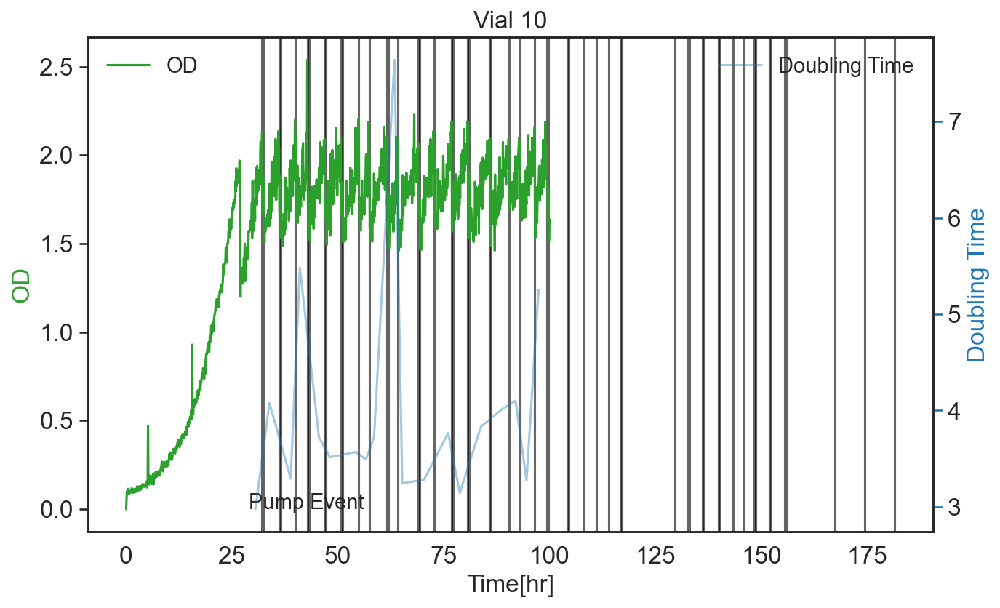

Vial 11:
MIN Doubling Time = 4.125593702524326
      Time[hr]        OD  smooth OD  Doubling Time
1157   97.3059  1.786092   1.864483       4.905655
1158   97.3895  1.842012   1.865688       4.877058
1159   97.4727  1.838006   1.865688       4.988731
1160   97.5559  1.890515   1.865688       5.078923
1161   97.6395  1.863947   1.878436       5.130195
1162   97.7227  1.913138   1.901827       5.231102
1163   97.8062  1.944244   1.928691       5.421393
1164   97.8894  1.952929   1.948586       5.712394
1165   97.9726  1.984527   1.955103       6.363035
1166   98.0561  2.003962   1.961901      17.164982
1180   99.2227  1.666067   1.687423      13.828313
1181   99.3059  1.771763   1.693754       9.854570
1182   99.3894  1.682676   1.693754       9.250155
1183   99.4726  1.756392   1.710388       8.659041
1184   99.5561  1.725439   1.713159       8.393593
1185   99.6393  1.747125   1.725439       8.426682
1186   99.7228  1.695337   1.736282       7.997799
1187   99.8061  1.770437   1.747125

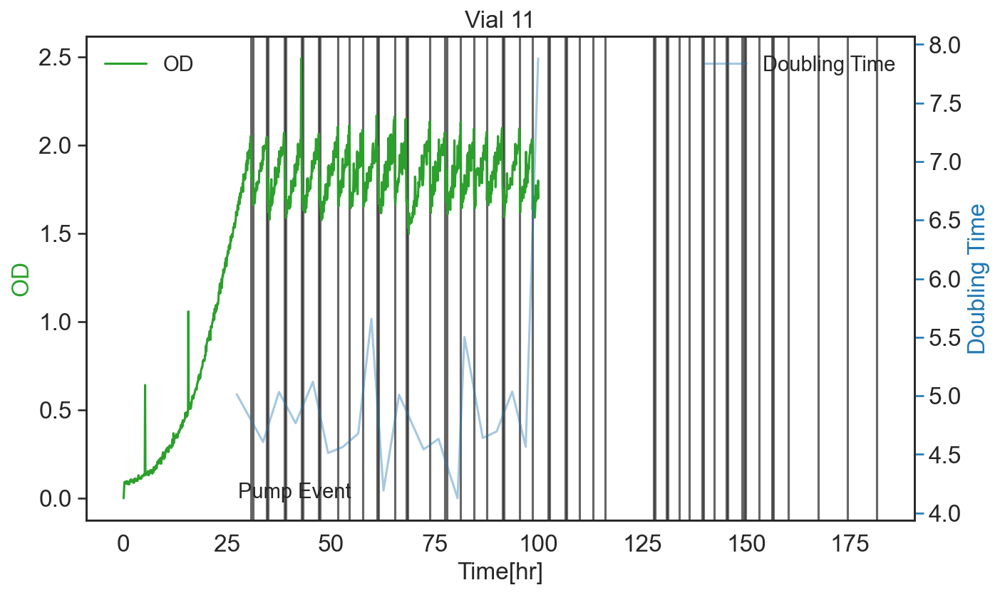

Vial 12:
MIN Doubling Time = 2.9312490457750715
      Time[hr]        OD  smooth OD  Doubling Time
1154   97.0560  1.674514   1.670412       4.120710
1155   97.1393  1.667483   1.673928       3.424939
1156   97.2227  1.843566   1.689928       3.082728
1157   97.3059  1.832447   1.745876       2.931249
1158   97.3895  1.898927   1.769338       2.938593
1159   97.4727  1.705342   1.809429       3.107553
1160   97.5559  1.887682   1.837405       3.321426
1161   97.6395  1.786411   1.842965       3.965108
1162   97.7227  1.843867   1.843717       4.864870
1163   97.8062  1.752265   1.846727       6.020792
1164   97.8894  1.842363   1.846727       6.693874
1165   97.9726  1.905017   1.846727       7.143965
1166   98.0561  1.965461   1.868634       6.709128
1167   98.1393  1.849586   1.847479       6.355116
1168   98.2228  1.960211   1.876844       5.966769
1169   98.3060  1.813867   1.904560       5.916062
1170   98.3893  2.087973   1.914941       6.125662
1171   98.4728  1.924866   1.92854

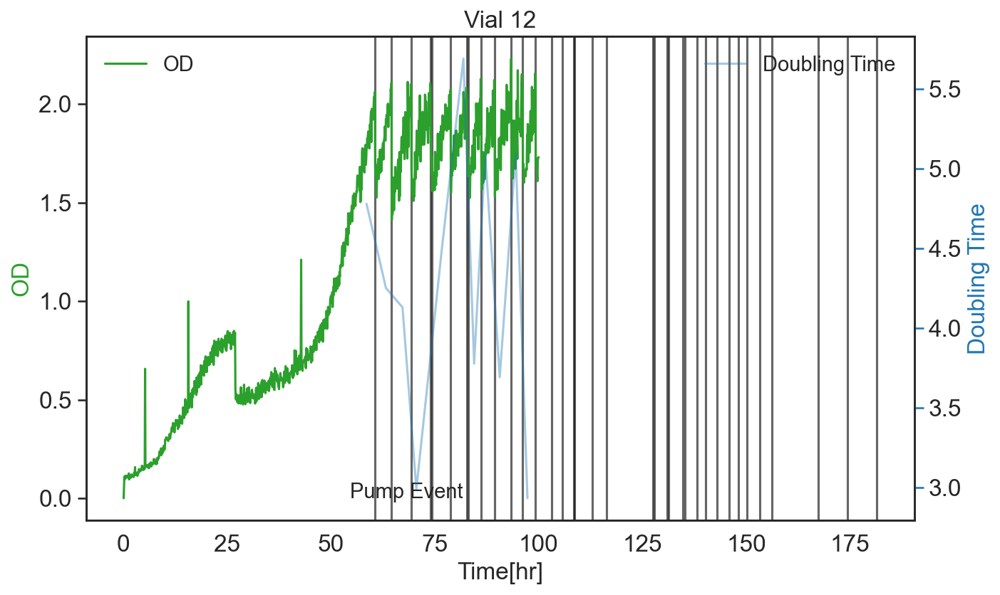

Vial 13:
MIN Doubling Time = 3.408595408526168
      Time[hr]        OD  smooth OD  Doubling Time
1161   97.6395  1.808651   1.749431       5.203340
1162   97.7227  1.835944   1.765866       5.411602
1163   97.8062  1.796931   1.780017       6.392264
1164   97.8894  1.746939   1.788578       7.657474
1165   97.9726  1.780226   1.799650       7.759900
1166   98.0561  1.779809   1.805510       7.375122
1167   98.1393  1.802369   1.805510       6.390631
1168   98.2228  1.845211   1.814951       5.524348
1169   98.3060  1.868870   1.799650       4.864371
1170   98.3893  1.827533   1.814951       4.466105
1171   98.4728  1.921645   1.836372       4.279360
1172   98.5559  1.787738   1.857041       4.111440
1173   98.6394  1.942230   1.895258       4.110532
1174   98.7226  1.777724   1.920790       4.290743
1175   98.8062  1.979348   1.930219       4.492104
1176   98.8894  1.938793   1.930219       5.305959
1177   98.9726  1.988895   1.930219       6.360855
1178   99.0561  1.962477   1.940511

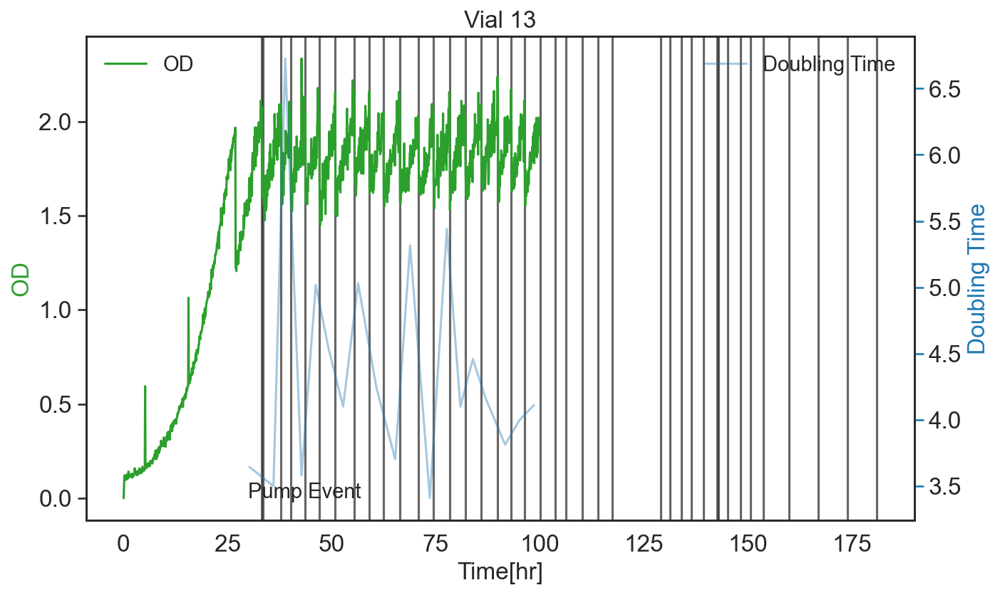

Vial 14:
MIN Doubling Time = 2.781785389777483
      Time[hr]        OD  smooth OD  Doubling Time
1157   97.3059  1.778298   1.871189       8.901946
1158   97.3895  1.943416   1.870228       7.783674
1159   97.4727  1.872150   1.871189       8.350502
1160   97.5559  1.916216   1.871189       8.531549
1161   97.6395  1.870228   1.881296       7.978599
1162   97.7227  1.857109   1.881296       6.792486
1163   97.8062  1.870228   1.903329       5.880386
1164   97.8894  2.005848   1.928193       5.469447
1165   97.9726  1.890442   1.909926       5.772831
1166   98.0561  1.973381   1.928193       6.407775
1167   98.1393  1.980903   1.956776       9.022670
1181   99.3059  1.685169   1.697082      17.011740
1182   99.3894  1.772294   1.697082      12.597281
1183   99.4726  1.756828   1.714196      11.750800
1184   99.5561  1.750207   1.712001      10.754117
1185   99.6393  1.729115   1.729115       9.905739
1186   99.7228  1.694887   1.734464       9.254937
1187   99.8061  1.739813   1.739813

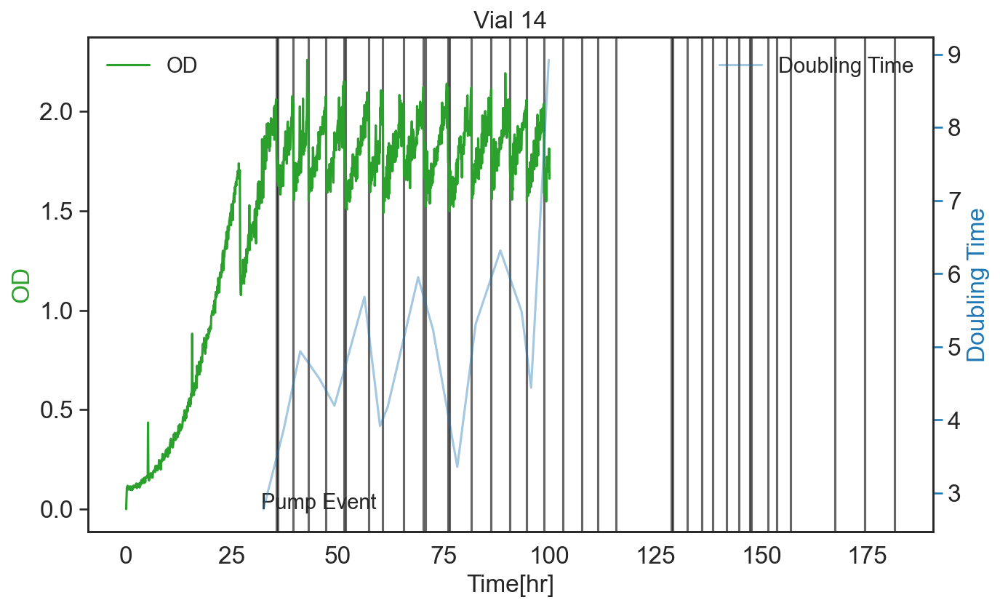

Vial 15:
MIN Doubling Time = 3.13638191007911
      Time[hr]        OD  smooth OD  Doubling Time
1155   97.1393  1.833160   1.922381      12.230447
1171   98.4728  1.786779   1.711893      13.471127
1172   98.5559  1.700065   1.731094      10.000319
1173   98.6394  1.790764   1.763315       7.828490
1174   98.7226  1.676476   1.746873       7.301636
1175   98.8062  1.613477   1.767089       7.251347
1176   98.8894  1.784389   1.767089       6.914525
1177   98.9726  1.772054   1.778222       6.570250
1178   99.0561  1.900576   1.778222       6.791167
1179   99.1392  1.731623   1.787576       7.300736
1180   99.2227  1.833561   1.798757       6.944271
1181   99.3059  1.743096   1.798757       7.241039
1182   99.3894  1.853260   1.823343       6.826620
1183   99.4726  1.813126   1.843411       6.418491
1184   99.5561  1.891648   1.843411       6.241673
1185   99.6393  1.959401   1.833561       6.298775
1186   99.7228  1.749036   1.843411       6.390404
1187   99.8061  1.989908   1.853260 

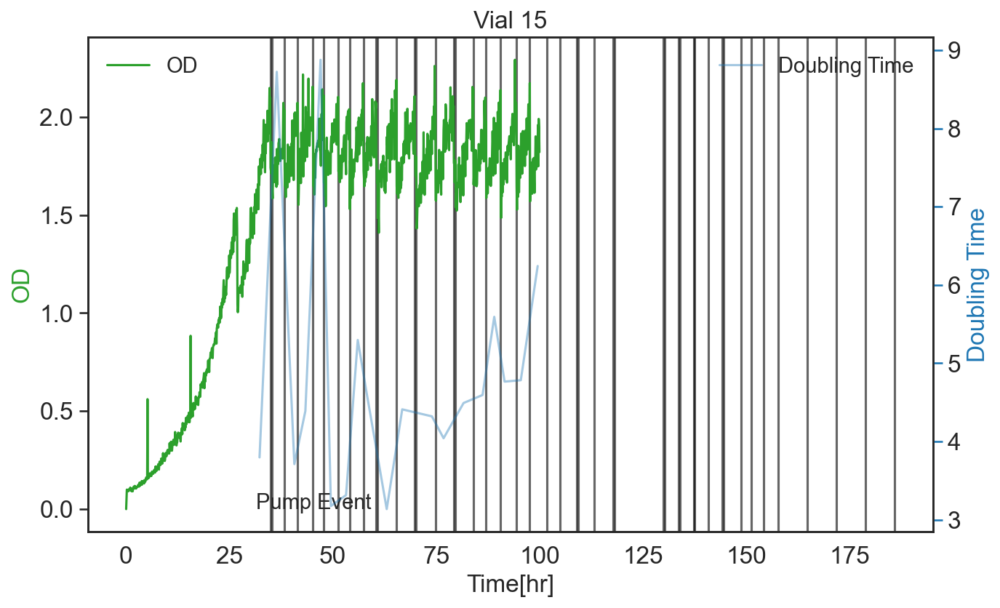

In [216]:
# Variables for Plot Generation
df_range = [0, 100] # range to plot data in

y1name = 'OD' #left y-axis variable name
y2name = doublename #right y-axis variable name; put None if you want a plot with one y-axis
eventname = pumpname #vertical lines when an event occured; put None if you want a plot without events; example: pumpname for pumps

save_plots = False # whether to save plots
logscale = False

fitrange = 12 # Window size for rolling growth rate finder

df_all = None
# Generating Plots
for x in vial_nums:
    print(f"Vial {x}:")

    # Load the OD df
    colnames=[timename,y1name]
    folder1 = name_to_foldername[y1name]
    df1 = read_csv(x,folder1,colnames)
    df1 = df1[df1[timename].between(df_range[0], df_range[1])]
    df1['smooth OD'] = df1[y1name].rolling(fitrange, center=True, min_periods=1).median() # perform rolling median smoothing
    # print(df1.tail())

    # Calculate Doubling Time
    df2 = df1.copy(deep=True)
    df2[doublename] = calculate_rolling_metric(df1[timename], df1['OD'], fitrange, calculation=doublename, smooth=True)
    df2 = df2[df2[doublename] < 20]
    print(f'MIN {doublename} = {df2[doublename].min()}')
    print(df2.tail(20))

    # Load the event df
    colnames = ['time', eventname]
    eventfolder = name_to_foldername[eventname]
    eventdf = read_csv(x, eventfolder, colnames)
    eventlist = eventdf['time'].tolist()
    print(eventlist)
    
    # For each pair of events, find the minimum doubling time
    min_doubling_times = [] # list of min doubling times and their associated times
    for i in range(len(eventlist) - 1):
        start_time = eventlist[i]
        end_time = eventlist[i+1]
        if ((end_time - start_time) < 1): # if the events are too close together or 
            continue
        interval_df = df2[(df2[timename] > start_time) & (df2[timename] <= end_time)]
        min_doubling_time = interval_df[y2name].min()
        if min_doubling_time is None or np.isnan(min_doubling_time):
            continue
        time_of_min = interval_df[interval_df[y2name] == min_doubling_time][timename].iloc[0] # find time of min
        min_doubling_times.append([time_of_min, min_doubling_time])
        print(f'Min Doubling Time between {start_time} and {end_time}: {min_doubling_time}')
    df2 = pd.DataFrame(min_doubling_times, columns=[timename, doublename])
    print(df2)
    
    plot(df1,df2,x=x,y1name=y1name,y2name=y2name,save_plots=save_plots,logscale=logscale,eventlist=eventlist,eventname=eventname)

# Raw OD Values vs Temperature

      Time[hr]  od_90_raw
2218  186.6392      33127
2219  186.7224      33082
2220  186.8057      33254
2221  186.8892      33147
2222  186.9724      33013
      Time[hr]  Temperature [C]
2217  186.6392        37.034360
2218  186.7224        37.095576
2219  186.8057        37.126184
2220  186.8892        36.911927
2221  186.9724        37.034360


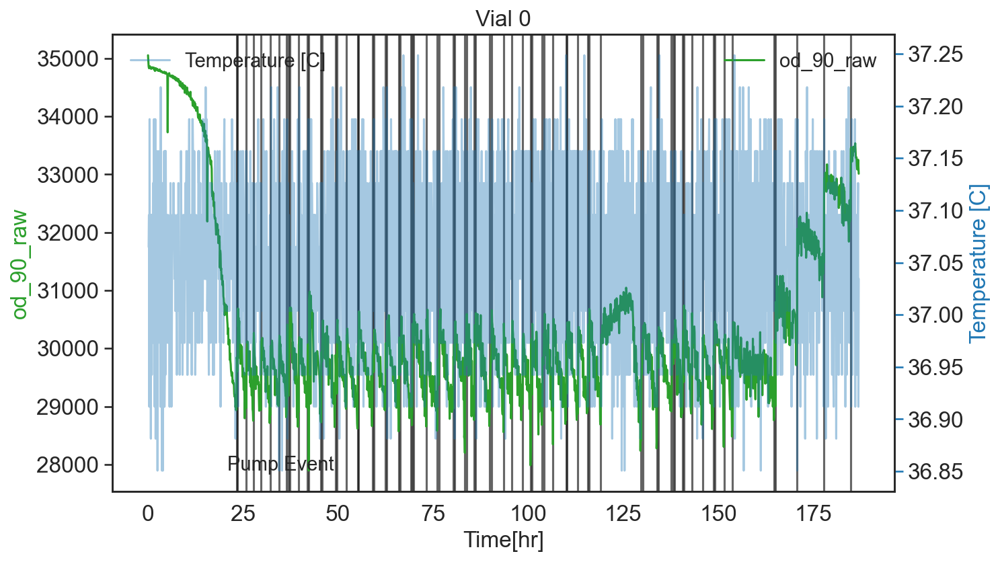

      Time[hr]  od_90_raw
2218  186.6392      32834
2219  186.7224      32840
2220  186.8057      32879
2221  186.8892      32881
2222  186.9724      32863
      Time[hr]  Temperature [C]
2217  186.6392        37.004692
2218  186.7224        37.068631
2219  186.8057        37.068631
2220  186.8892        37.132570
2221  186.9724        37.068631


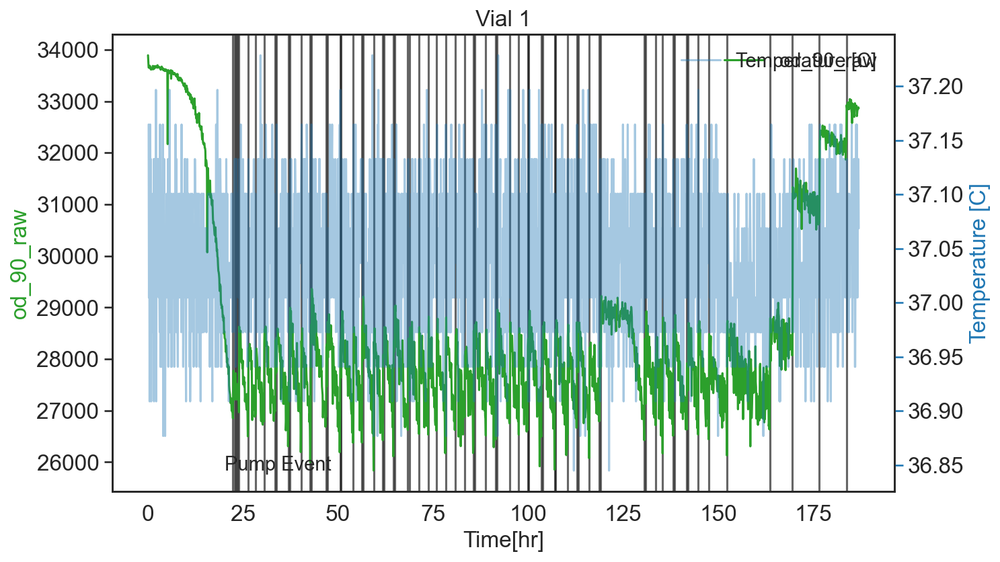

      Time[hr]  od_90_raw
2218  186.6392      32856
2219  186.7224      32822
2220  186.8057      33002
2221  186.8892      32825
2222  186.9724      32851
      Time[hr]  Temperature [C]
2217  186.6392        37.076512
2218  186.7224        37.076512
2219  186.8057        36.986508
2220  186.8892        37.076512
2221  186.9724        37.016509


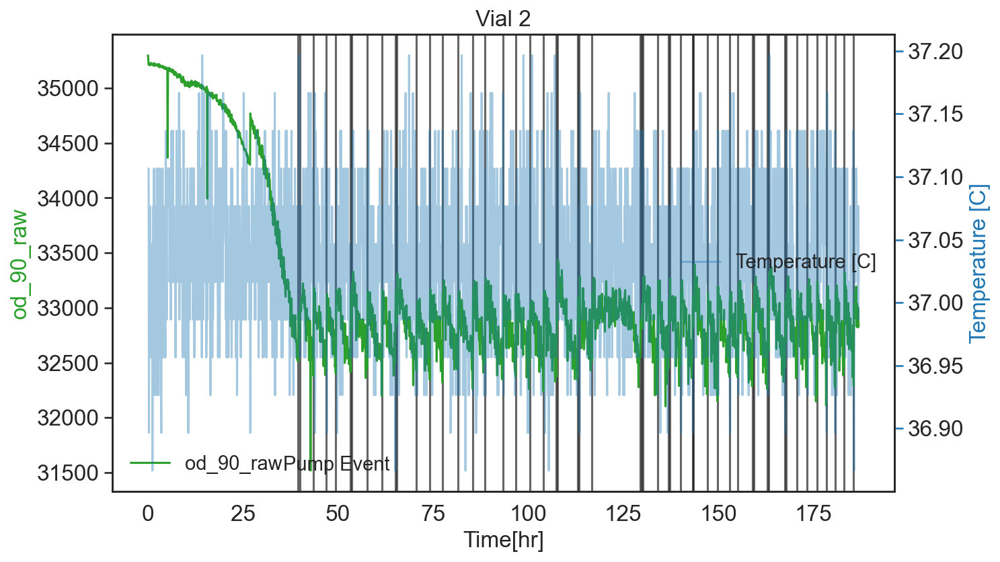

      Time[hr]  od_90_raw
2218  186.6392      27522
2219  186.7224      26091
2220  186.8057      27716
2221  186.8892      28337
2222  186.9724      27660
      Time[hr]  Temperature [C]
2217  186.6392        37.180708
2218  186.7224        37.120080
2219  186.8057        37.211021
2220  186.8892        37.089767
2221  186.9724        37.089767


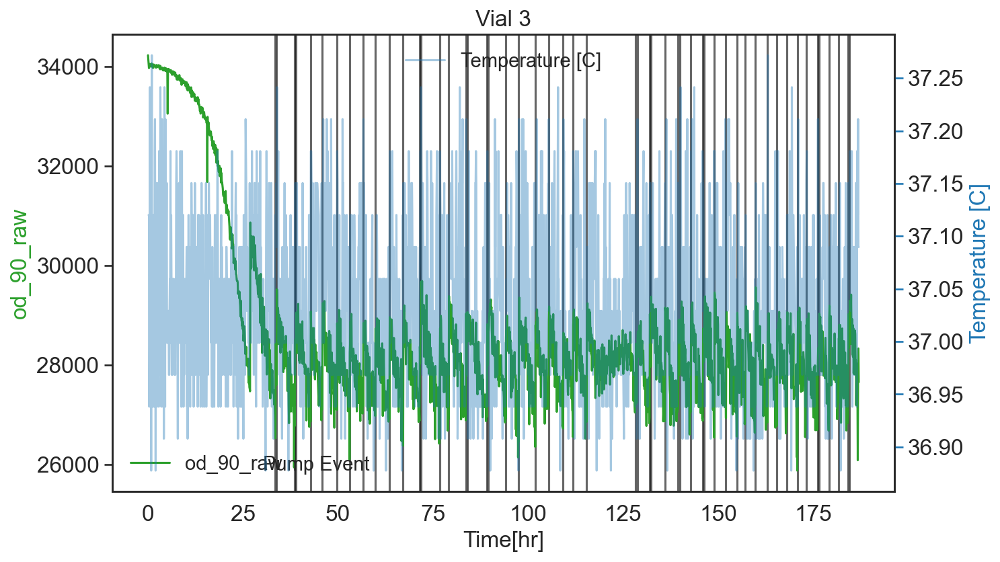

      Time[hr]  od_90_raw
2218  186.6392      31333
2219  186.7224      31223
2220  186.8057      31302
2221  186.8892      31147
2222  186.9724      31138
      Time[hr]  Temperature [C]
2217  186.6392        37.093584
2218  186.7224        37.093584
2219  186.8057        36.967338
2220  186.8892        37.125145
2221  186.9724        37.093584


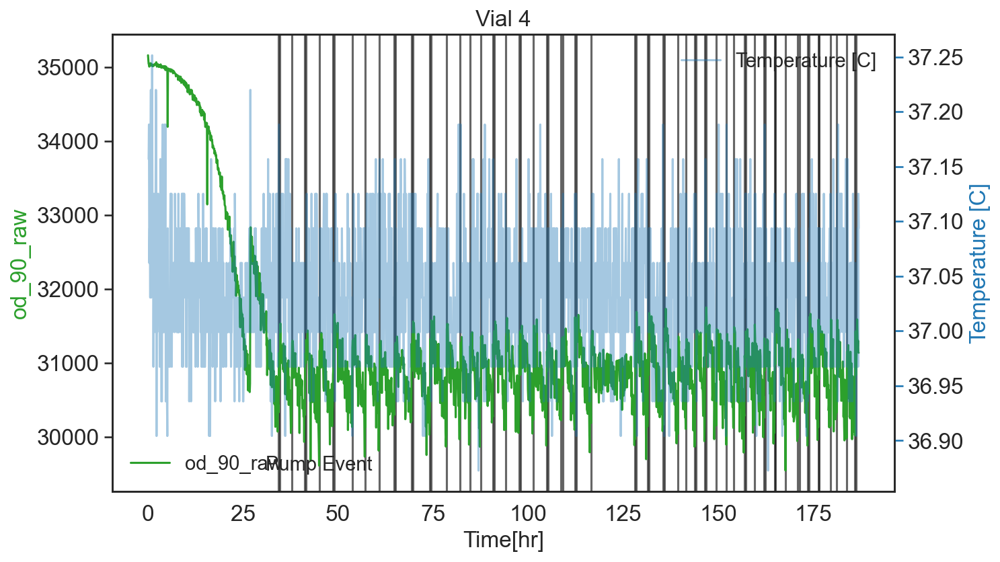

      Time[hr]  od_90_raw
2218  186.6392      29667
2219  186.7224      29746
2220  186.8057      29915
2221  186.8892      29971
2222  186.9724      29739
      Time[hr]  Temperature [C]
2217  186.6392        37.052887
2218  186.7224        37.020894
2219  186.8057        37.020894
2220  186.8892        37.084881
2221  186.9724        36.988900


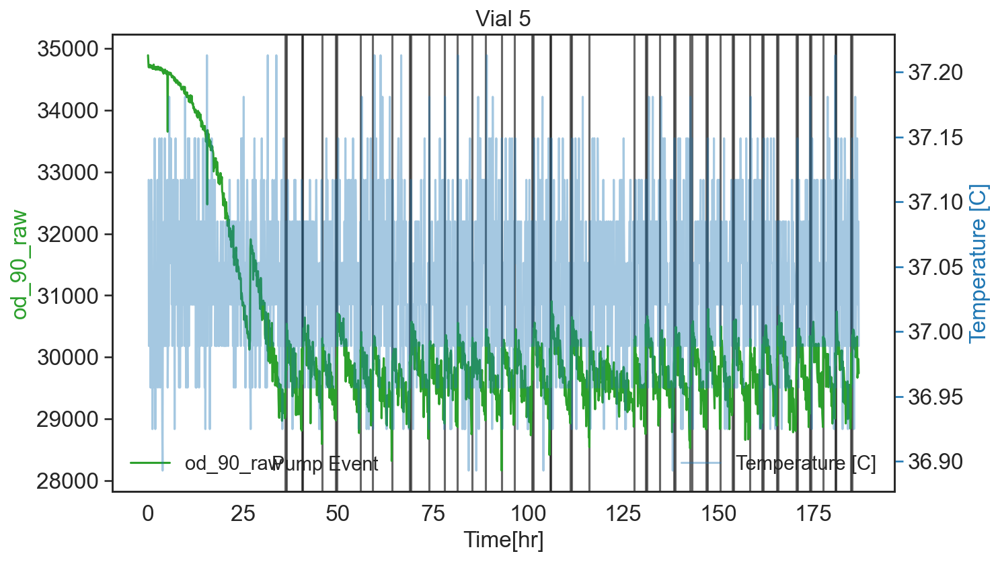

      Time[hr]  od_90_raw
2218  186.6392      31547
2219  186.7224      31274
2220  186.8057      31225
2221  186.8892      31429
2222  186.9724      31165
      Time[hr]  Temperature [C]
2217  186.6392        37.114505
2218  186.7224        36.989837
2219  186.8057        37.052171
2220  186.8892        36.989837
2221  186.9724        36.989837


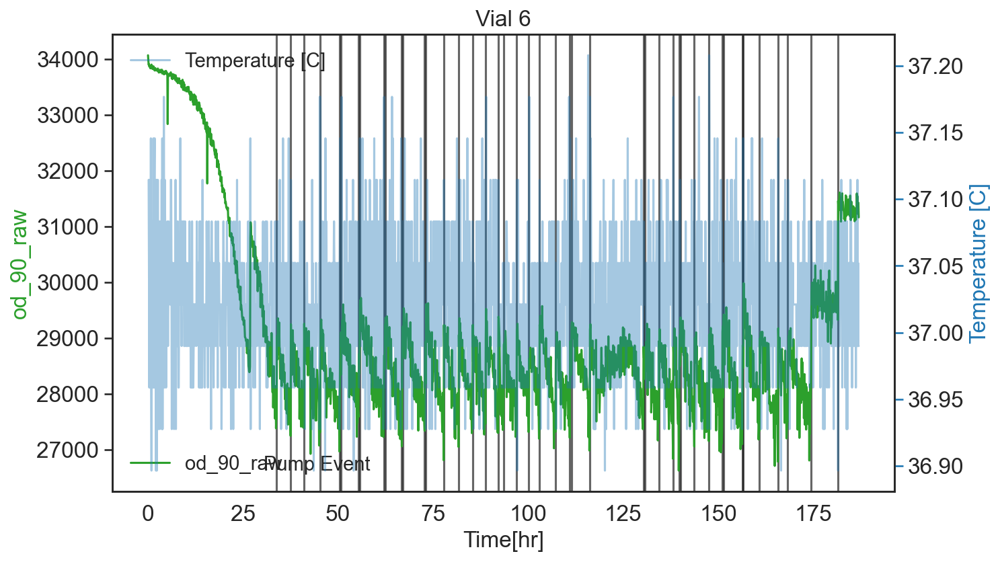

      Time[hr]  od_90_raw
2218  186.6392      33656
2219  186.7224      33625
2220  186.8057      33620
2221  186.8892      33589
2222  186.9724      33619
      Time[hr]  Temperature [C]
2217  186.6392        37.002361
2218  186.7224        37.188733
2219  186.8057        37.002361
2220  186.8892        36.971300
2221  186.9724        37.064485


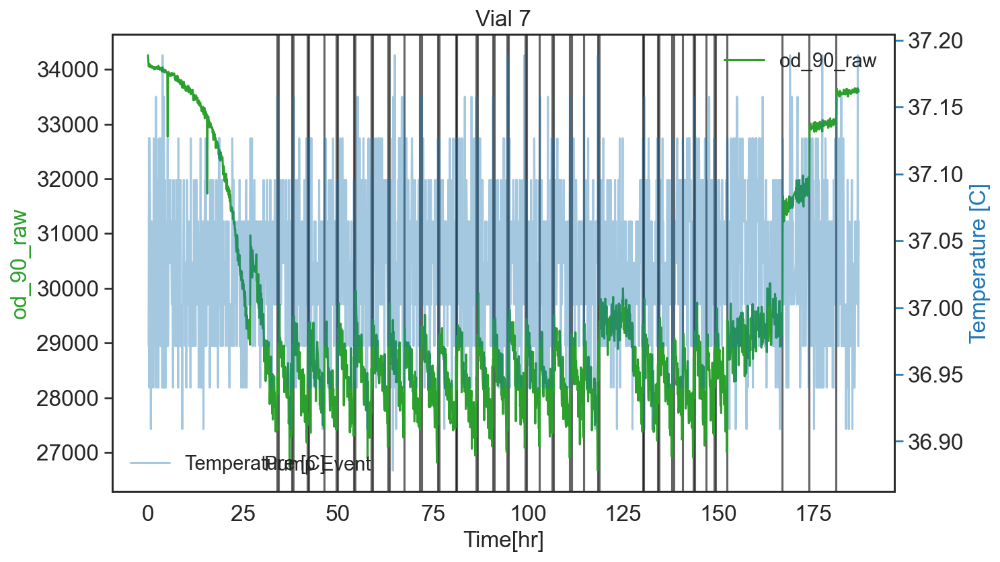

      Time[hr]  od_90_raw
2218  186.6392      33598
2219  186.7224      33758
2220  186.8057      33701
2221  186.8892      33688
2222  186.9724      33543
      Time[hr]  Temperature [C]
2217  186.6392        37.080542
2218  186.7224        36.921251
2219  186.8057        36.921251
2220  186.8892        36.953109
2221  186.9724        36.953109


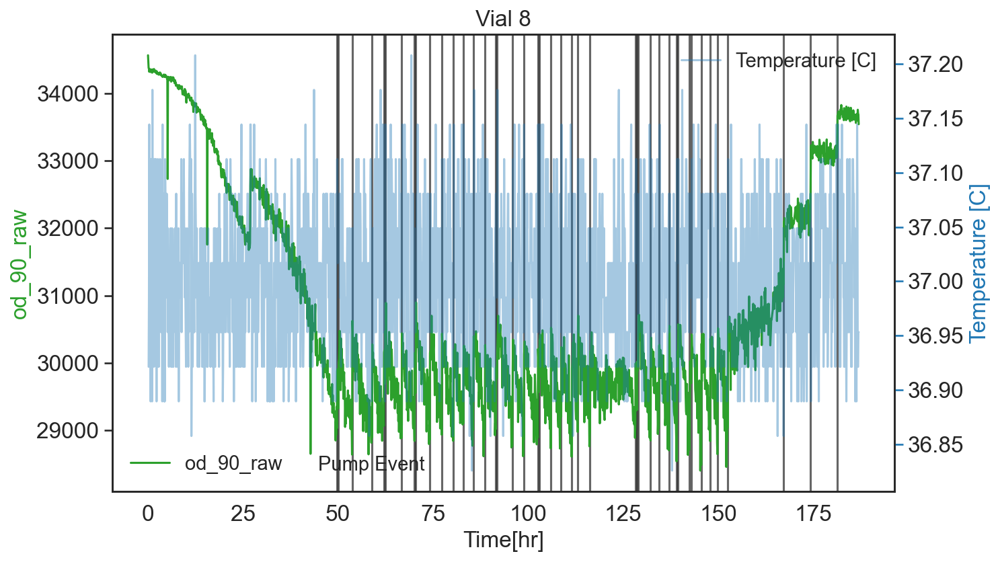

      Time[hr]  od_90_raw
2218  186.6392      31088
2219  186.7224      31268
2220  186.8057      31486
2221  186.8892      31646
2222  186.9724      31403
      Time[hr]  Temperature [C]
2217  186.6392        37.083516
2218  186.7224        37.023225
2219  186.8057        37.053370
2220  186.8892        36.993079
2221  186.9724        36.962934


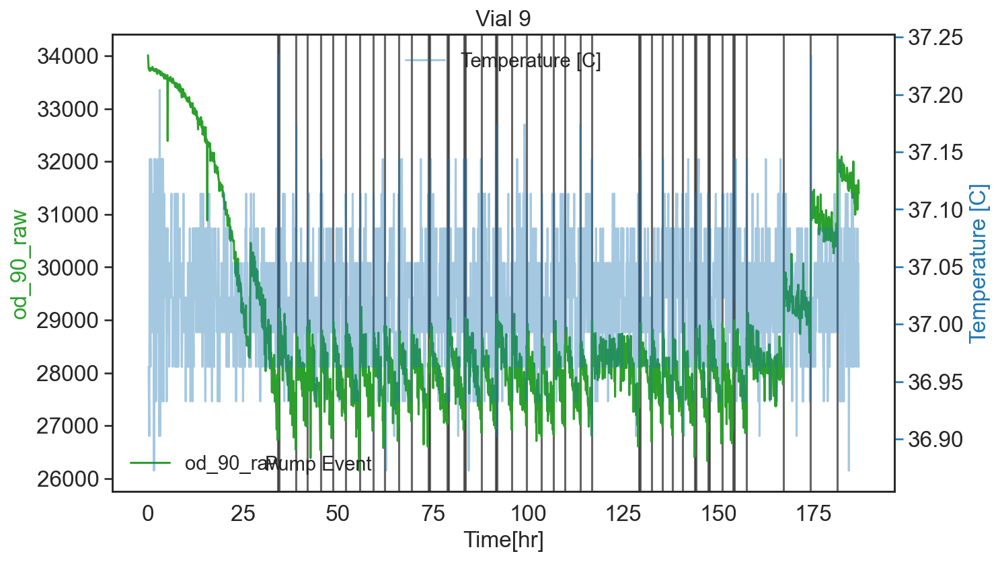

      Time[hr]  od_90_raw
2218  186.6392      33878
2219  186.7224      33958
2220  186.8057      33996
2221  186.8892      34103
2222  186.9724      34058
      Time[hr]  Temperature [C]
2217  186.6392        37.061501
2218  186.7224        36.966616
2219  186.8057        36.998244
2220  186.8892        37.029872
2221  186.9724        36.998244


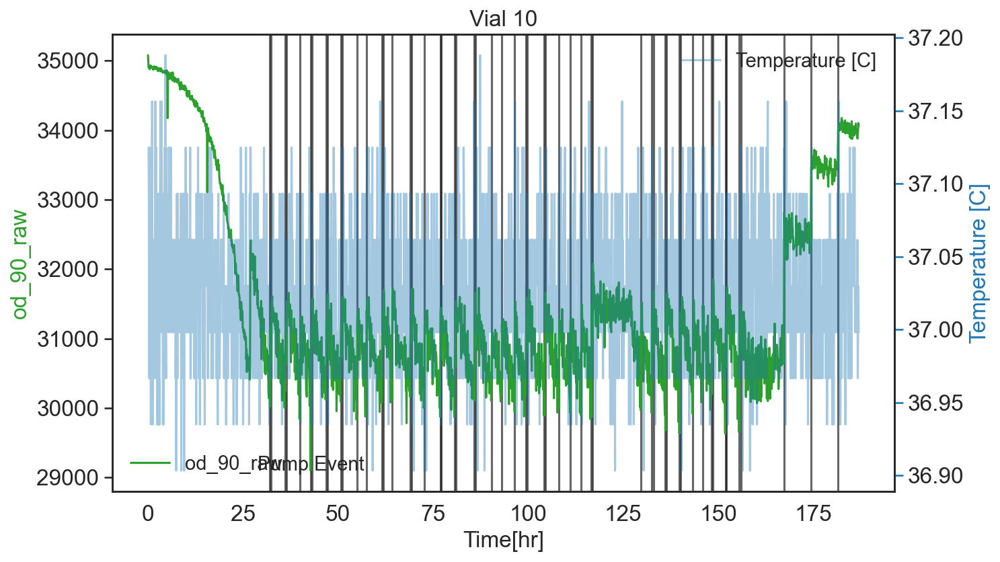

      Time[hr]  od_90_raw
2218  186.6392      33918
2219  186.7224      33940
2220  186.8057      33883
2221  186.8892      33878
2222  186.9724      33879
      Time[hr]  Temperature [C]
2217  186.6392        36.962167
2218  186.7224        36.993219
2219  186.8057        36.931115
2220  186.8892        37.024271
2221  186.9724        36.993219


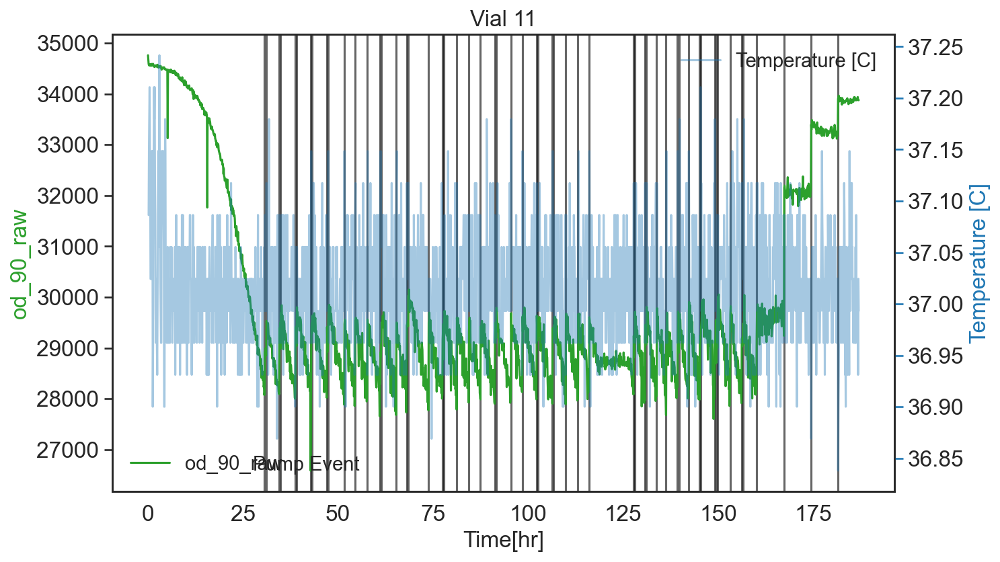

      Time[hr]  od_90_raw
2218  186.6392      33704
2219  186.7224      33728
2220  186.8057      33718
2221  186.8892      33765
2222  186.9724      33744
      Time[hr]  Temperature [C]
2217  186.6392        37.026296
2218  186.7224        36.995532
2219  186.8057        37.026296
2220  186.8892        36.995532
2221  186.9724        37.026296


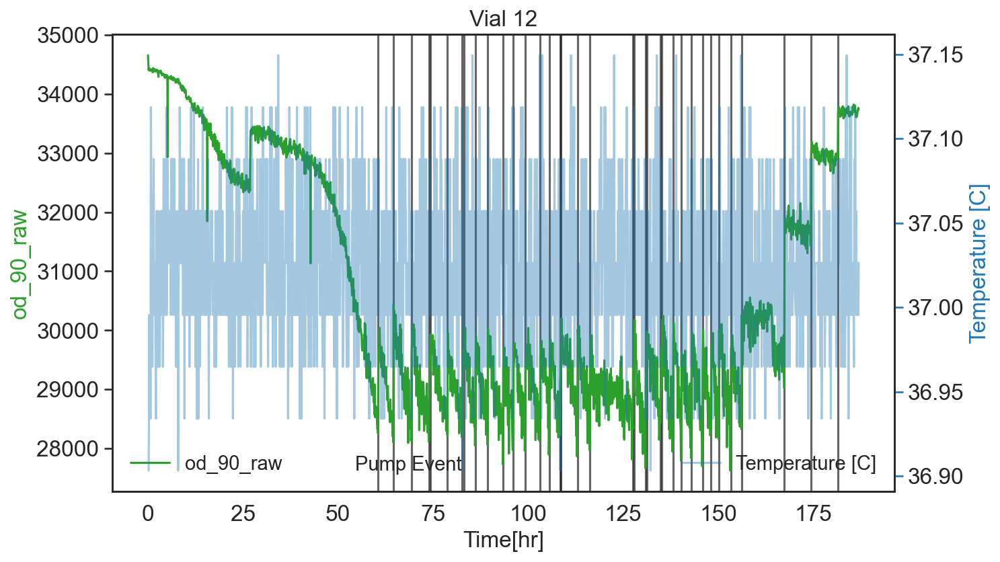

      Time[hr]  od_90_raw
2218  186.6392      34485
2219  186.7224      34425
2220  186.8057      34450
2221  186.8892      34502
2222  186.9724      34431
      Time[hr]  Temperature [C]
2217  186.6392        37.091172
2218  186.7224        37.029108
2219  186.8057        37.060140
2220  186.8892        37.029108
2221  186.9724        37.029108


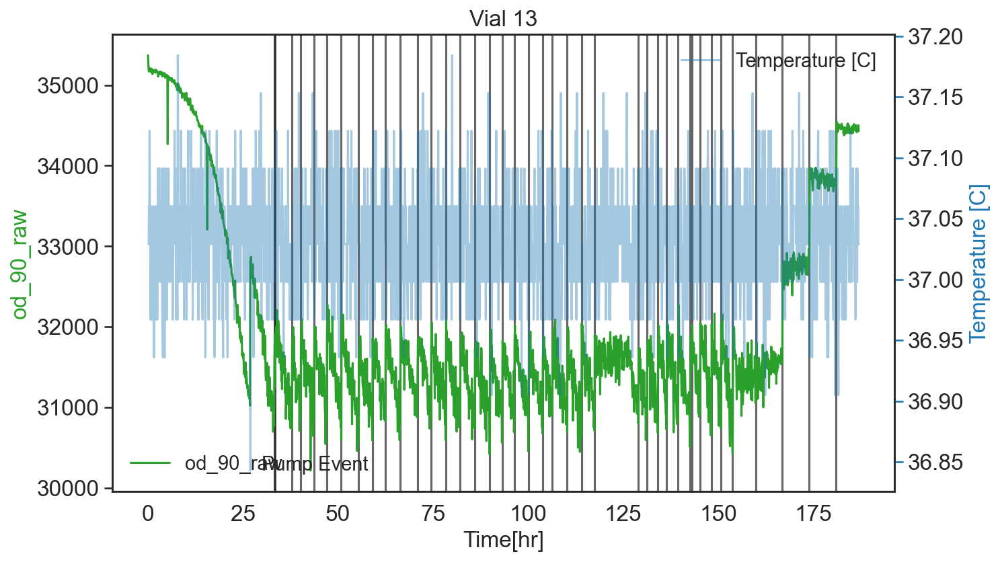

      Time[hr]  od_90_raw
2218  186.6392      34358
2219  186.7224      34429
2220  186.8057      34504
2221  186.8892      34421
2222  186.9724      34492
      Time[hr]  Temperature [C]
2217  186.6392        37.019258
2218  186.7224        36.958971
2219  186.8057        37.019258
2220  186.8892        36.989114
2221  186.9724        37.019258


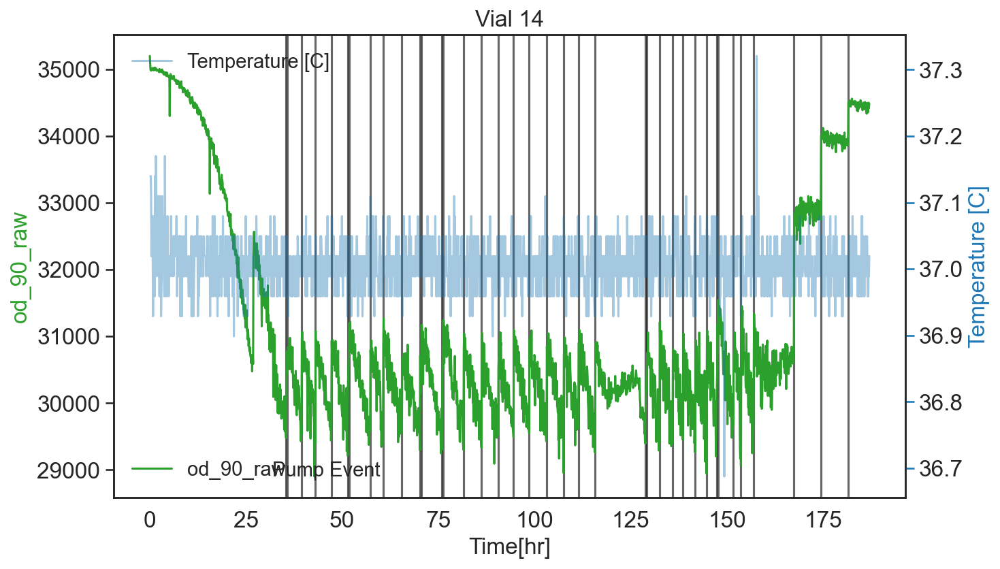

      Time[hr]  od_90_raw
2218  186.6392      35080
2219  186.7224      35089
2220  186.8057      35080
2221  186.8892      35099
2222  186.9724      35083
      Time[hr]  Temperature [C]
2217  186.6392        37.104557
2218  186.7224        37.104557
2219  186.8057        37.104557
2220  186.8892        37.007976
2221  186.9724        37.072363


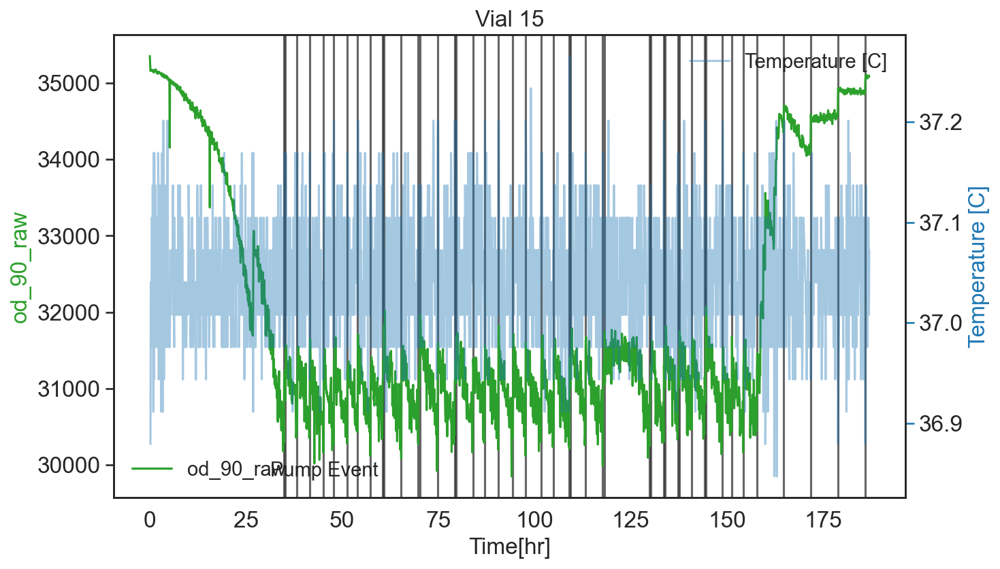

In [217]:
# Variables for Plot Generation
y1name = 'od_90_raw' #left y-axis variable name
y2name = tempname #right y-axis variable name; put None if you want a plot with one y-axis
eventname = pumpname #vertical lines when an event occured; put None if you want a plot without events; example: pumpname for pumps

save_plots = False # whether to save plots
logscale = False

# Generating Plots
for x in vial_nums:
    
    colnames=[timename,y1name]
    df1 = read_csv(x, y1name, colnames)
    print(df1.tail())
    
    df2 = None
    if y2name is not None:
        colnames = [timename,y2name]
        folder2 = name_to_foldername[y2name]
        df2 = read_csv(x,folder2,colnames)
        print(df2.tail())
    
    eventdf = None
    eventlist = None
    if eventname is not None:
        colnames = [timename,eventname]
        eventfolder = name_to_foldername[eventname]
        eventdf = read_csv(x,eventfolder,colnames)
#         print(eventdf.head())
        eventlist = eventdf[timename]
#         print(eventlist)
    
    
    plot(df1,df2,x=x,y1name=y1name,y2name=y2name,save_plots=save_plots,logscale=logscale,eventlist=eventlist,eventname=eventname)


In [218]:
import pickle

# Specify the path to the .pickle file
file_path = 'data\data.pickle'

# Open the file in binary read mode
with open(file_path, 'rb') as file:
    # Load the object from the file
    data = pickle.load(file)

# Now `data` contains the deserialized object from the .pickle file
print(data)


FileNotFoundError: [Errno 2] No such file or directory: 'data\\data.pickle'

In [ ]:
fast = np.array([0.75, 0.78, 0.75, 0.75, 0.86, 0.8, 0.8, 0.77, 0.76, 0.76, 0.78, 0.9400000000000001, 0.76, 0.73, 0.74, 0.79])
slow = np.array([0.21000000000000002, 0.22000000000000003, 0.205, 0.21000000000000002, 0.21000000000000002, 0.21000000000000002, 0.21000000000000002, 0.215, 0.21000000000000002, 0.215, 0.22000000000000003, 0.21000000000000002, 0.22000000000000003, 0.2, 0.22000000000000003, 0.2])
slow*10

array([2.1 , 2.2 , 2.05, 2.1 , 2.1 , 2.1 , 2.1 , 2.15, 2.1 , 2.15, 2.2 ,
       2.1 , 2.2 , 2.  , 2.2 , 2.  ])

In [ ]:
fast*10

array([7.5, 7.8, 7.5, 7.5, 8.6, 8. , 8. , 7.7, 7.6, 7.6, 7.8, 9.4, 7.6,
       7.3, 7.4, 7.9])

In [ ]:
{"name": "pump_calibration_5/14/24_dany-fit", "type": "constant", "timeFit": 1715699179640, "active": true, "params": ["pump"], "coefficients": [0.75, 0.78, 0.75, 0.75, 0.86, 0.8, 0.8, 0.77, 0.76, 0.76, 0.78, 0.9400000000000001, 0.76, 0.73, 0.74, 0.79, "", "", "", "", "", "", "", "", "", "", "", "", "", "", "", "", 0.021, 0.022, 0.0205, 0.021, 0.021, 0.021, 0.021, 0.0215, 0.021, 0.0215, 0.022, 0.021, 0.022, 0.02 , 0.022, 0.02]}

In [ ]:
curves_to_wait = 5
vial = 15

gr_data = pd.read_csv('data/growthrate/vial{0}_gr.txt'.format(vial), delimiter=',', names=['time', 'gr'])
last_gr = gr_data.tail(curves_to_wait)['gr'].median()
last_gr

0.07369618578901102